In [5]:
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
from scipy.integrate import odeint
from scipy.interpolate import interp1d
from tqdm import tqdm
import scipy
import spiceypy as spice
import rebound
import reboundx

In [6]:
GRAVITATIONAL_CONSTANT = 6.67430e-11 #m^3/kg/s^2
MASS_SUN = 1.98847e30 #kg
AU_TO_M = 1.495978707e11 # m/AU
DAY_TO_SEC = 86400 # sec/day
L_SUN = 3.828e26 # W
SPEED_OF_LIGHT = 299792458 #m/s
MASS_J = 1.89813e27 #kg
MASS_E = 5.97237e24 #kg
MASS_MR = 6.4171e23 #kg
MASS_V = 4.8675e24 #kg
MASS_HG = 3.3011e23 #kg
year = spice.jyear() # Year [s]
au = AU_TO_M # Astronomical Unit [m]

In [7]:
def cart2cyl(x):
    arr = x.copy()
    arr[:,0] = np.sqrt((x[:,0]**2) + (x[:,1]** 2))
    arr[:,1] = np.arctan2(x[:,1], x[:,0])

    
    return arr

[ 6.94387089e-01 -1.22781217e-01  2.72250900e-01  5.37906431e+08
  6.30521006e+10]


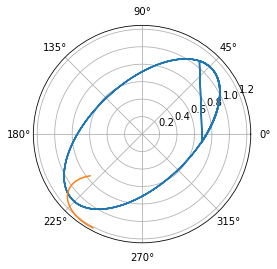

In [8]:
orbit = np.load('Orbit_time.npy')
orbit = orbit.reshape(20000,5)
orbit_orig = orbit.copy()
center = 1/2 * np.array([np.max(orbit[:,0]) + np.min(orbit[:,0]),
                         np.max(orbit[:,1]) + np.min(orbit[:,1]),
                        np.max(orbit[:,2]) + np.min(orbit[:,2])])
orbit[:,0] -= center[0]
orbit[:,1] -= center[1]
orbit[:,2] -= center[2]
orbit = cart2cyl(orbit.reshape(20000,5))
orbit_orig = cart2cyl(orbit_orig.reshape(20000,5))



print(orbit[5])
orbit = np.tile(orbit,(3,1) )
orbit[:20000,1] -= 2*np.pi
orbit[40000:,1] += 2*np.pi

orbit_orig = np.tile(orbit_orig,(3,1) )
orbit_orig[:20000,1] -= 2*np.pi
orbit_orig[40000:,1] += 2*np.pi

psp = np.load('psp2.npy')
psp_orig = psp.copy()
psp[:,0] -= center[0]
psp[:,1] -= center[1]
psp[:,2] -= center[2]

psp = cart2cyl(psp)
psp_orig = cart2cyl(psp_orig)
fig, ax = plt.subplots(subplot_kw={'projection': 'polar'})


ax.plot(orbit[:,1], orbit[:,0])
ax.plot(psp[:,1], psp[:,0])
#ax.scatter(arr[6309,1], arr[6309,0])



offset = interp1d(orbit[:,1], orbit[:,2])
radius = interp1d(orbit[:,1], orbit_orig[:,0])


offset_orig = interp1d(orbit_orig[:,1], orbit_orig[:,2])
radius_orig = interp1d(orbit_orig[:,1], orbit_orig[:,0])

In [9]:
points = []
points_orig = []
n = 40


for i in tqdm(range(n)):
    data = np.load(f'Output_vel/particles{i}.npy')
    beta = np.load(f'Output_vel/beta{i}.npy')
    size = np.load(f'Output_vel/mass{i}.npy')
    
    data = data.reshape(10000*100*2, 5)
    data_orig = data.copy()
    data[:,0] -= center[0]
    data[:,1] -= center[1]
    data[:,2] -= center[2]
    
    data = cart2cyl(data[:,0:3])
    data_orig = cart2cyl(data_orig[:,0:3])
#     data[:,2] -= offset(data[:,1])
    
    
    points.append(np.hstack((data, np.tile(size,20000).reshape(2000000,1), np.tile(beta,20000).reshape(2000000,1))))
    points_orig.append(np.hstack((data_orig, np.tile(size,20000).reshape(2000000,1), np.tile(beta,20000).reshape(2000000,1))))
points = np.array(points)
points = points.reshape(2000000*n,5)
points_orig = np.array(points_orig)
points_orig = points_orig.reshape(2000000*n,5)

100%|██████████| 40/40 [00:16<00:00,  2.45it/s]


In [10]:
len(points[:,3])

80000000

In [36]:
m_t = np.sum(points[:,3])
norm = 1e14/m_t

In [12]:
i = np.argmax(orbit[:,0][np.logical_and(-np.pi<orbit[:,1], orbit[:,1]<0)])

t_min = orbit[np.logical_and(-np.pi<orbit[:,1], orbit[:,1]<0)][i,1]
print(t_min)  

i = np.argmax(orbit[:,0][np.logical_and(0<orbit[:,1], orbit[:,1]<np.pi)]) #6309
t_max = orbit[[np.logical_and(0<orbit[:,1], orbit[:,1]<np.pi)]][i,1]
print(t_max)

print(abs(t_min-t_max))


# t_min = t_max + np.pi
# t_min, t_max = t_max, t_min
t_max = t_max - 0*np.pi
t_min = t_min - 0*np.pi

print(t_min, t_max)


# i = np.argmin(orbit[:,0][np.logical_and(np.abs(orbit[:,1], orbit[:,1])<np.pi)])

# t_min_orig = orbit[np.logical_and(-np.pi<orbit[:,1], orbit[:,1]<0)][i,1]
# print(t_min_orig)  

# i = np.argmax(orbit[:,0][np.logical_and(np.abs(orbit[:,1], orbit[:,1])<np.pi)]) #6309
# t_max_orig = orbit[[np.logical_and(0<orbit[:,1], orbit[:,1]<np.pi)]][i,1]
# print(t_max_orig)

# print(abs(t_min_orig-t_max_orig))


# # t_min = t_max + np.pi
# t_min_orig, t_max_orig = t_max_orig, t_min_orig

-2.3889198105462714
0.7522299514080371
3.1411497619543085
-2.3889198105462714 0.7522299514080371


<ipython-input-12-5dcbf6973b6b>:7: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  t_max = orbit[[np.logical_and(0<orbit[:,1], orbit[:,1]<np.pi)]][i,1]


NameError: name 'orb_arr' is not defined

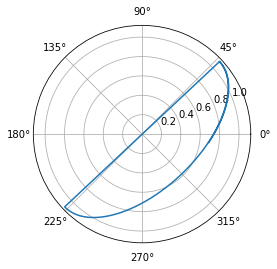

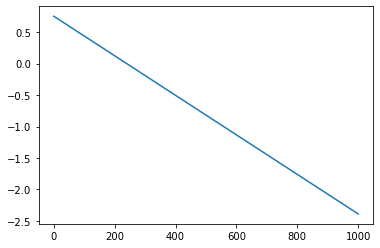

  0%|          | 0/1000 [00:00<?, ?it/s]

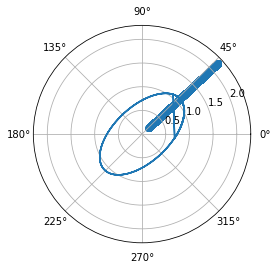

  0%|          | 1/1000 [00:00<08:23,  1.98it/s]

2.0740204417073382


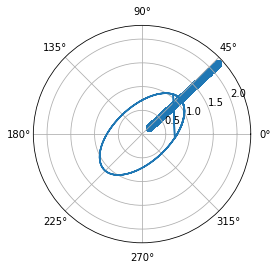

  0%|          | 2/1000 [00:00<07:42,  2.16it/s]

2.0732871397518013


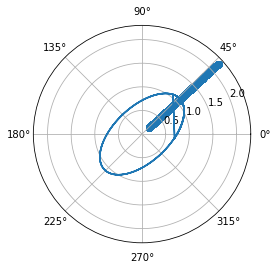

  0%|          | 3/1000 [00:01<07:05,  2.35it/s]

2.073746964692779


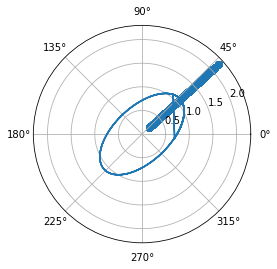

  0%|          | 4/1000 [00:01<07:01,  2.36it/s]

2.0728391679194487


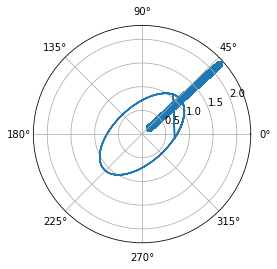

  0%|          | 5/1000 [00:02<07:11,  2.30it/s]

2.0732622013184603


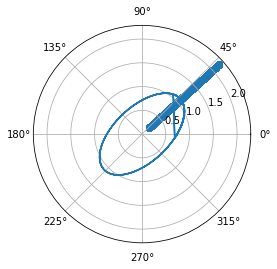

  1%|          | 6/1000 [00:02<07:00,  2.36it/s]

2.0733176953531207


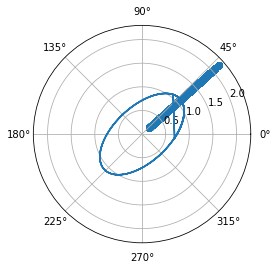

  1%|          | 7/1000 [00:02<06:59,  2.37it/s]

2.0725136083836024


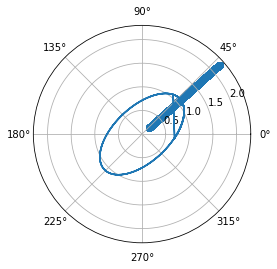

  1%|          | 8/1000 [00:03<06:57,  2.37it/s]

2.0729695217284054


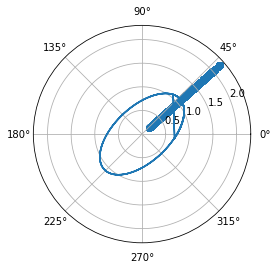

  1%|          | 9/1000 [00:03<07:47,  2.12it/s]

2.072213743297409


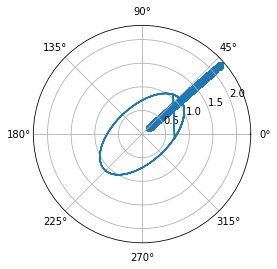

  1%|          | 10/1000 [00:04<07:29,  2.20it/s]

2.071822766690669


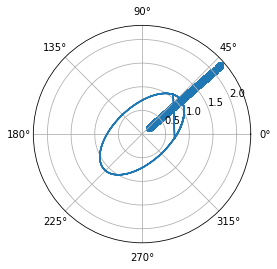

  1%|          | 11/1000 [00:04<07:05,  2.32it/s]

2.072287156498549


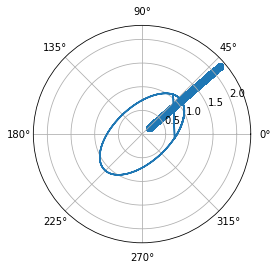

  1%|          | 12/1000 [00:05<06:48,  2.42it/s]

2.071260020883244


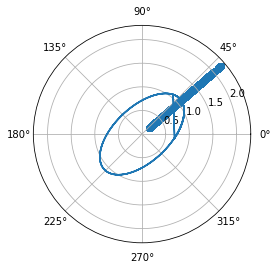

  1%|▏         | 13/1000 [00:05<06:54,  2.38it/s]

2.0705017965226005


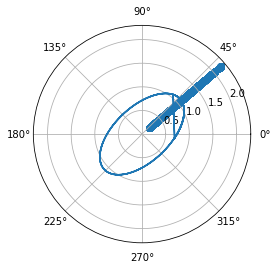

  1%|▏         | 14/1000 [00:05<06:44,  2.44it/s]

2.070933772678509


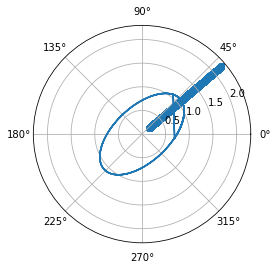

  2%|▏         | 15/1000 [00:06<06:32,  2.51it/s]

2.0704281174932744


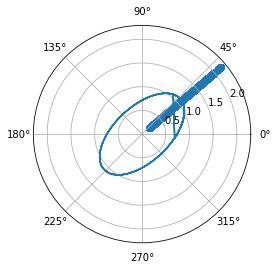

  2%|▏         | 16/1000 [00:06<06:36,  2.48it/s]

2.0693899933690645


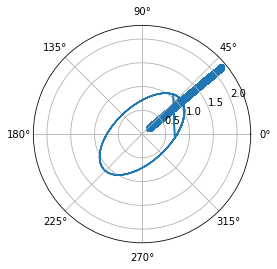

  2%|▏         | 17/1000 [00:07<06:29,  2.53it/s]

2.0684158773963484


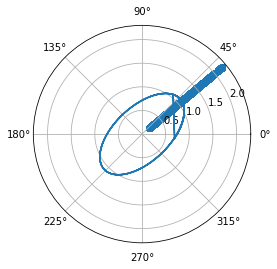

  2%|▏         | 18/1000 [00:07<06:22,  2.57it/s]

2.068427824057435


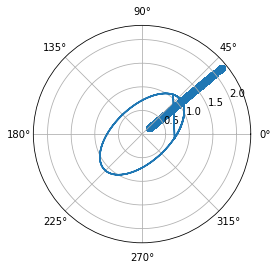

  2%|▏         | 19/1000 [00:07<06:19,  2.58it/s]

2.0687602611348104


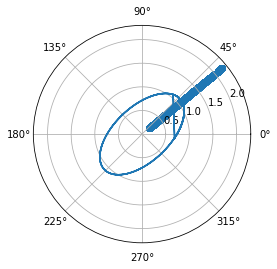

  2%|▏         | 20/1000 [00:08<06:17,  2.60it/s]

2.067880187733505


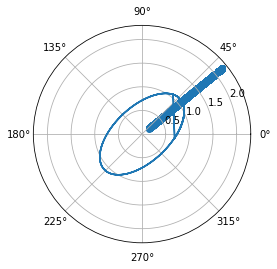

  2%|▏         | 21/1000 [00:08<06:09,  2.65it/s]

2.067048807265161


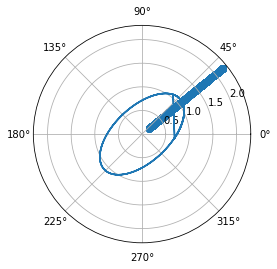

  2%|▏         | 22/1000 [00:08<06:02,  2.70it/s]

2.0662622138127826


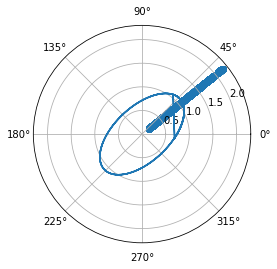

  2%|▏         | 23/1000 [00:09<06:06,  2.66it/s]

2.0655168696006823


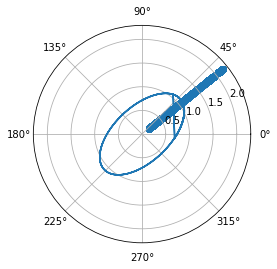

  2%|▏         | 24/1000 [00:09<06:13,  2.61it/s]

2.064809563383547


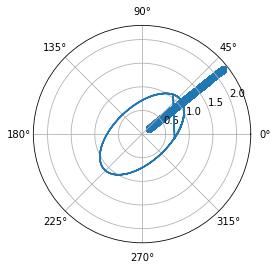

  2%|▎         | 25/1000 [00:10<06:16,  2.59it/s]

2.0635092234656534


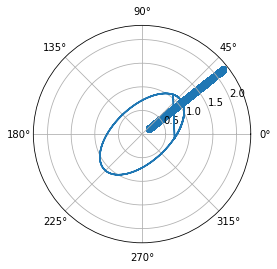

  3%|▎         | 26/1000 [00:10<06:26,  2.52it/s]

2.062491053169372


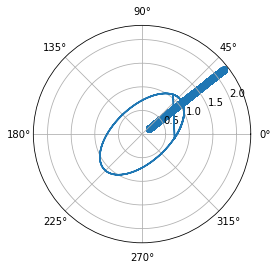

  3%|▎         | 27/1000 [00:10<06:29,  2.50it/s]

2.061315845228713


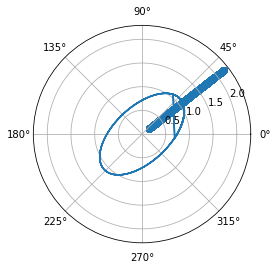

  3%|▎         | 28/1000 [00:11<06:12,  2.61it/s]

2.0621700469265676


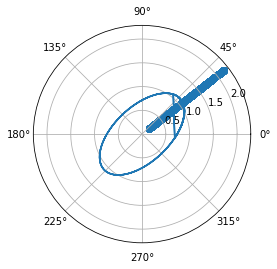

  3%|▎         | 29/1000 [00:11<06:09,  2.63it/s]

2.0609914417580333


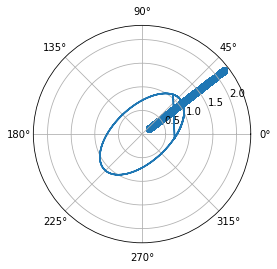

  3%|▎         | 30/1000 [00:11<05:49,  2.77it/s]

2.059349279533219


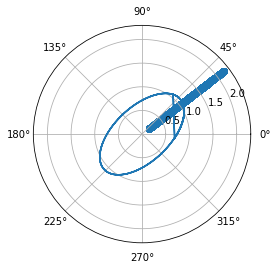

  3%|▎         | 31/1000 [00:12<05:40,  2.85it/s]

2.0579755363175387


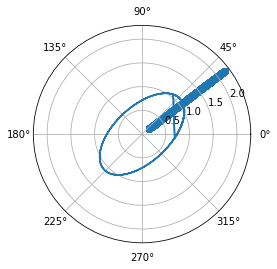

  3%|▎         | 32/1000 [00:12<05:45,  2.80it/s]

2.058535809897376


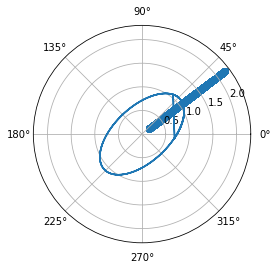

  3%|▎         | 33/1000 [00:13<06:39,  2.42it/s]

2.0559778582267496


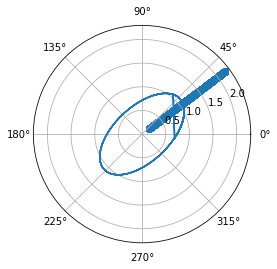

  3%|▎         | 34/1000 [00:13<06:47,  2.37it/s]

2.0561245241931108


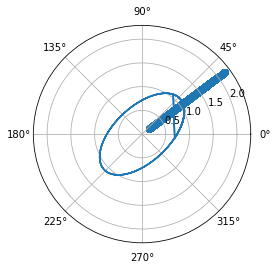

  4%|▎         | 35/1000 [00:14<06:41,  2.41it/s]

2.0537732804288726


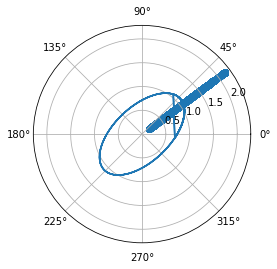

  4%|▎         | 36/1000 [00:14<06:24,  2.51it/s]

2.054187784322461


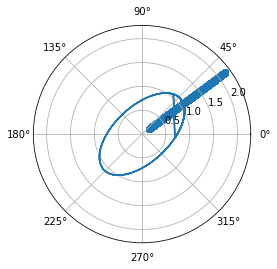

  4%|▎         | 37/1000 [00:14<06:10,  2.60it/s]

2.0518418507339735


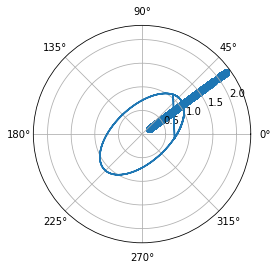

  4%|▍         | 38/1000 [00:15<06:07,  2.62it/s]

2.051001649258833


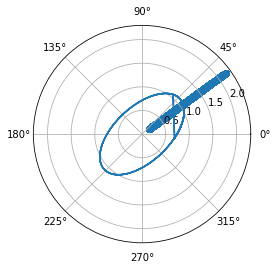

  4%|▍         | 39/1000 [00:15<06:05,  2.63it/s]

2.0507458555690157


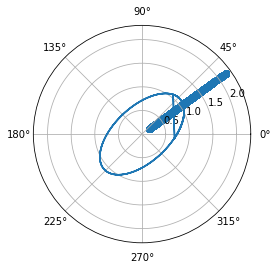

  4%|▍         | 40/1000 [00:15<05:55,  2.70it/s]

2.048984285883919


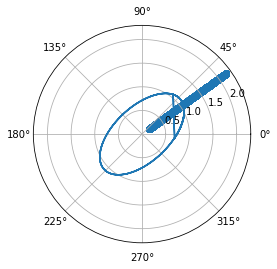

  4%|▍         | 41/1000 [00:16<05:50,  2.74it/s]

2.047404434922


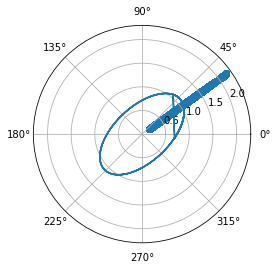

  4%|▍         | 42/1000 [00:16<05:39,  2.82it/s]

2.04678911029513


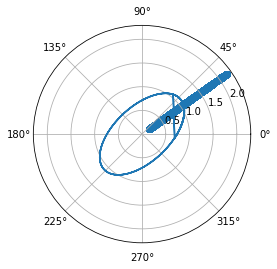

  4%|▍         | 43/1000 [00:16<05:31,  2.88it/s]

2.0456010065228933


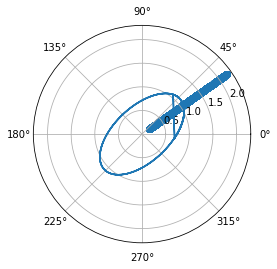

  4%|▍         | 44/1000 [00:17<05:26,  2.92it/s]

2.044209862714049


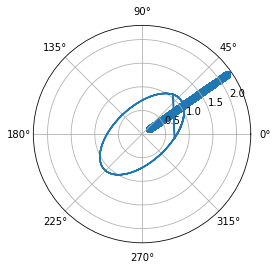

  4%|▍         | 45/1000 [00:17<05:49,  2.73it/s]

2.0425543080936053


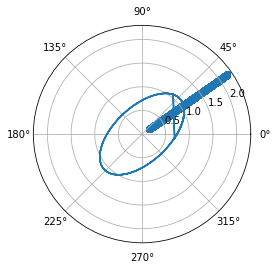

  5%|▍         | 46/1000 [00:17<05:43,  2.78it/s]

2.0405451259873466


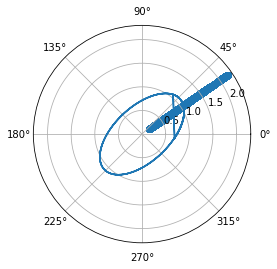

  5%|▍         | 47/1000 [00:18<05:34,  2.85it/s]

2.0390000809830053


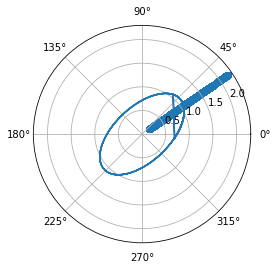

  5%|▍         | 48/1000 [00:18<05:37,  2.82it/s]

2.039434297285466


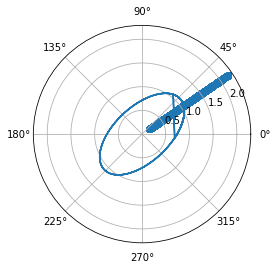

  5%|▍         | 49/1000 [00:19<05:36,  2.82it/s]

2.0364023412457066


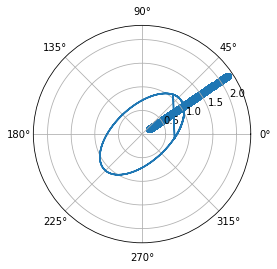

  5%|▌         | 50/1000 [00:19<05:40,  2.79it/s]

2.0355743676857836


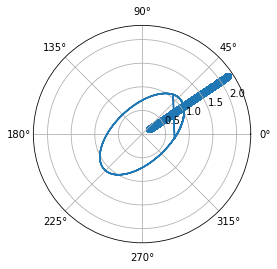

  5%|▌         | 51/1000 [00:19<05:40,  2.79it/s]

2.0334434687905256


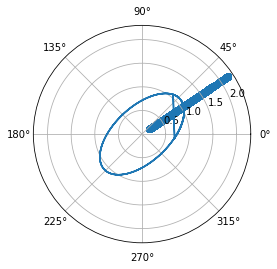

  5%|▌         | 52/1000 [00:20<05:41,  2.78it/s]

2.0329850449004137


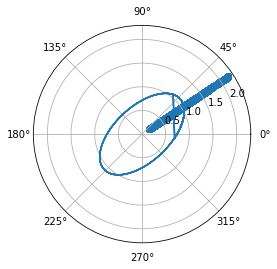

  5%|▌         | 53/1000 [00:20<05:29,  2.87it/s]

2.0303311223176435


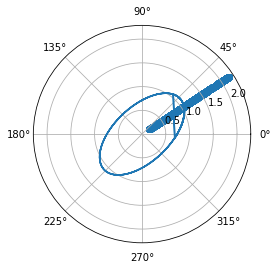

  5%|▌         | 54/1000 [00:20<05:27,  2.89it/s]

2.0280455973390192


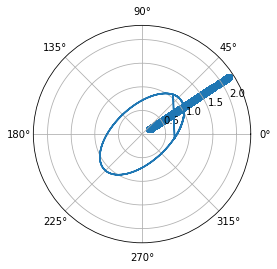

  6%|▌         | 55/1000 [00:21<05:32,  2.84it/s]

2.026709236387844


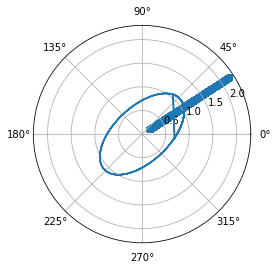

  6%|▌         | 56/1000 [00:21<05:22,  2.93it/s]

2.0253340224466982


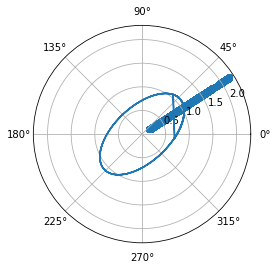

  6%|▌         | 57/1000 [00:21<05:17,  2.97it/s]

2.0237200186983904


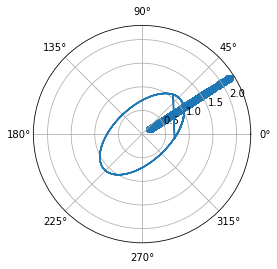

  6%|▌         | 58/1000 [00:22<05:16,  2.98it/s]

2.02178751916955


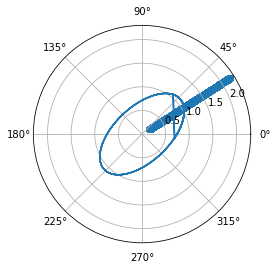

  6%|▌         | 59/1000 [00:22<05:20,  2.93it/s]

2.0206198003575393


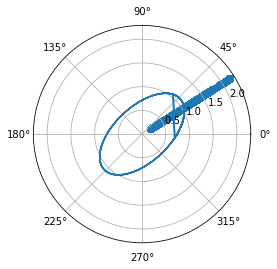

  6%|▌         | 60/1000 [00:22<05:15,  2.98it/s]

2.0205924222109566


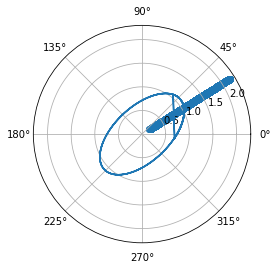

  6%|▌         | 61/1000 [00:23<05:13,  3.00it/s]

2.0183061528614488


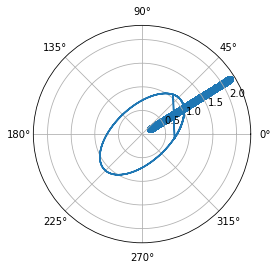

  6%|▌         | 62/1000 [00:23<05:21,  2.92it/s]

2.0150757194743987


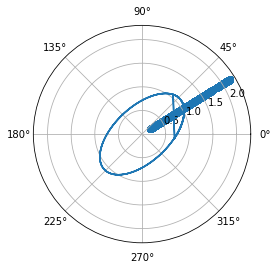

  6%|▋         | 63/1000 [00:23<05:30,  2.83it/s]

2.015563608161913


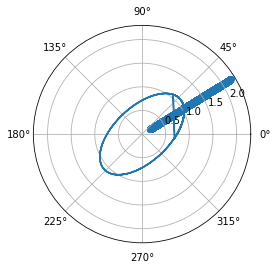

  6%|▋         | 64/1000 [00:24<05:21,  2.91it/s]

2.0117405637649397


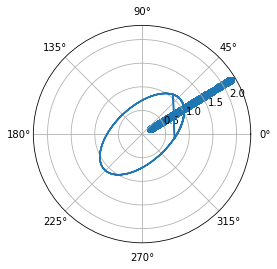

  6%|▋         | 65/1000 [00:24<05:18,  2.93it/s]

2.0123614670917322


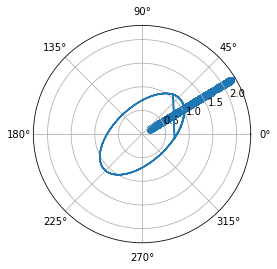

  7%|▋         | 66/1000 [00:24<05:17,  2.94it/s]

2.009405457052437


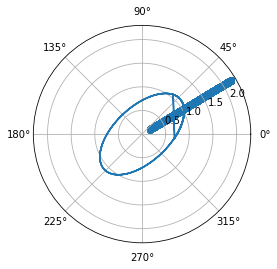

  7%|▋         | 67/1000 [00:25<05:22,  2.89it/s]

2.0068792656814107


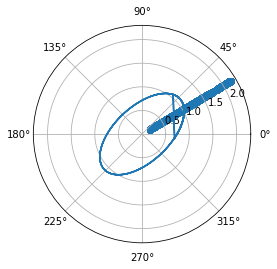

  7%|▋         | 68/1000 [00:25<05:24,  2.87it/s]

2.0061627206548582


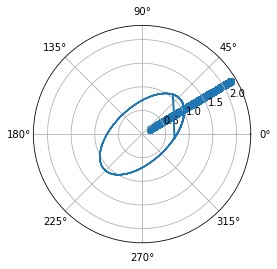

  7%|▋         | 69/1000 [00:25<05:35,  2.78it/s]

2.0045412700976155


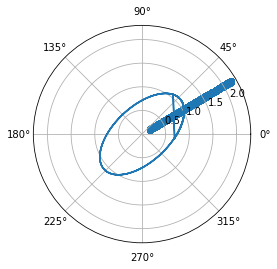

  7%|▋         | 70/1000 [00:26<05:42,  2.72it/s]

2.002588606546443


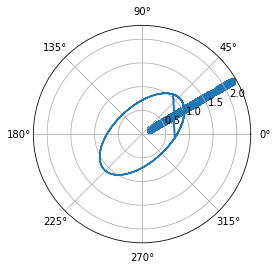

  7%|▋         | 71/1000 [00:26<05:45,  2.69it/s]

2.0001667672221424


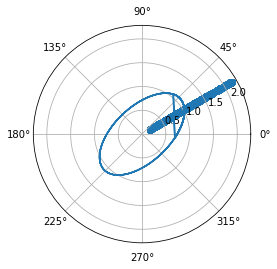

  7%|▋         | 72/1000 [00:27<05:53,  2.63it/s]

1.997047701567613


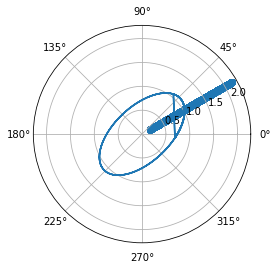

  7%|▋         | 73/1000 [00:27<05:42,  2.71it/s]

1.9954788319151426


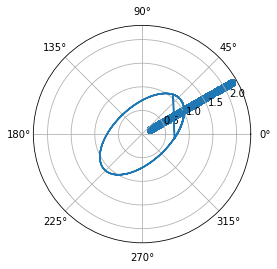

  7%|▋         | 74/1000 [00:27<05:41,  2.71it/s]

1.9952650495740365


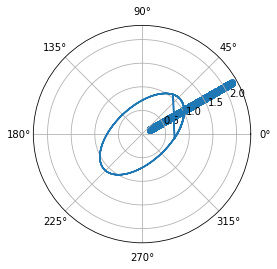

  8%|▊         | 75/1000 [00:28<05:43,  2.70it/s]

1.9911122887559607


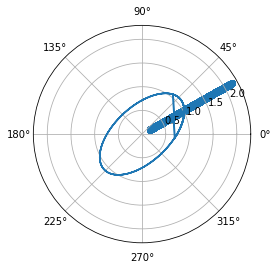

  8%|▊         | 76/1000 [00:28<05:28,  2.81it/s]

1.9914422151762499


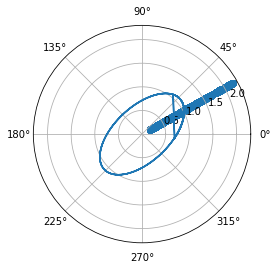

  8%|▊         | 77/1000 [00:28<05:26,  2.82it/s]

1.9882232632202634


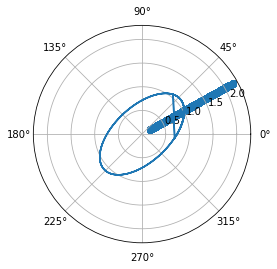

  8%|▊         | 78/1000 [00:29<05:49,  2.64it/s]

1.9853408635909822


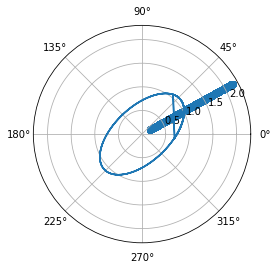

  8%|▊         | 79/1000 [00:29<05:48,  2.64it/s]

1.9850206422044474


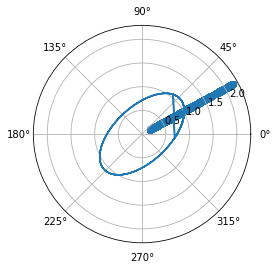

  8%|▊         | 80/1000 [00:30<05:43,  2.68it/s]

1.9833337581579487


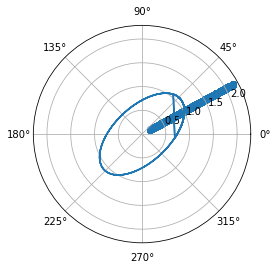

  8%|▊         | 81/1000 [00:30<05:46,  2.65it/s]

1.9813026666185014


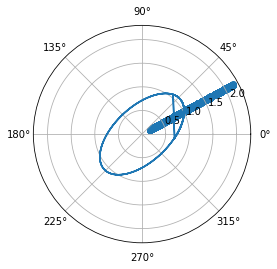

  8%|▊         | 82/1000 [00:30<05:56,  2.57it/s]

1.9787780534149153


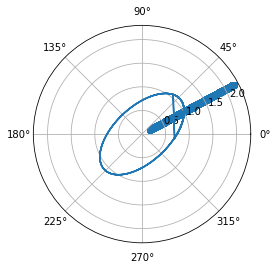

  8%|▊         | 83/1000 [00:31<05:47,  2.64it/s]

1.9755080822100106


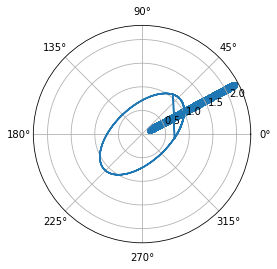

  8%|▊         | 84/1000 [00:31<05:31,  2.76it/s]

1.9723003144574525


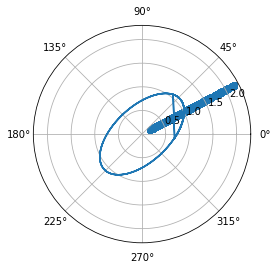

  8%|▊         | 85/1000 [00:31<05:23,  2.83it/s]

1.9726414411253168


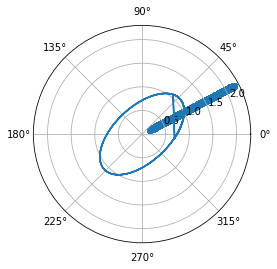

  9%|▊         | 86/1000 [00:32<05:08,  2.96it/s]

1.9678660130531194


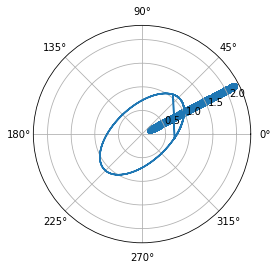

  9%|▊         | 87/1000 [00:32<04:59,  3.05it/s]

1.9684685819200374


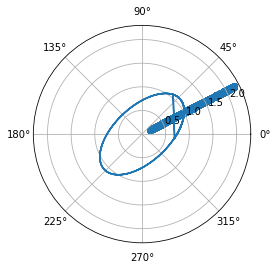

  9%|▉         | 88/1000 [00:32<04:54,  3.09it/s]

1.9649294818498513


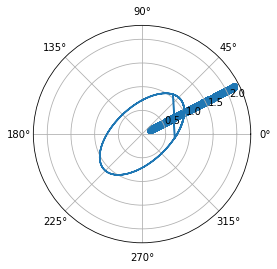

  9%|▉         | 89/1000 [00:33<04:56,  3.07it/s]

1.9645071537644838


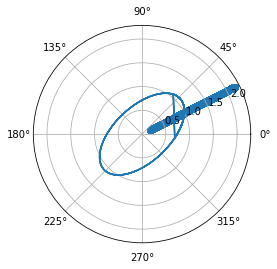

  9%|▉         | 90/1000 [00:33<04:57,  3.06it/s]

1.9618441149467745


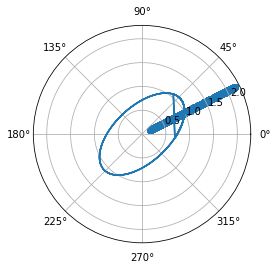

  9%|▉         | 91/1000 [00:33<04:52,  3.11it/s]

1.9599356459716442


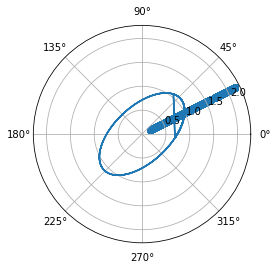

  9%|▉         | 92/1000 [00:34<04:49,  3.13it/s]

1.957610087543357


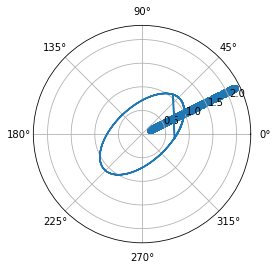

  9%|▉         | 93/1000 [00:34<04:49,  3.13it/s]

1.9546694847399346


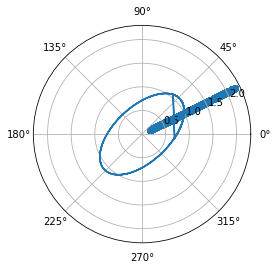

  9%|▉         | 94/1000 [00:34<04:50,  3.12it/s]

1.9507646513511239


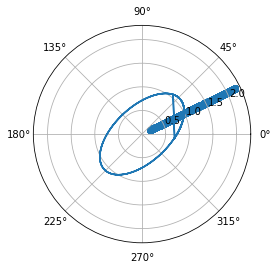

 10%|▉         | 95/1000 [00:34<04:40,  3.23it/s]

1.949220200928587


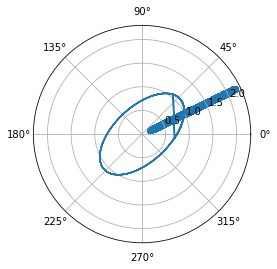

 10%|▉         | 96/1000 [00:35<04:42,  3.20it/s]

1.9480399612633832


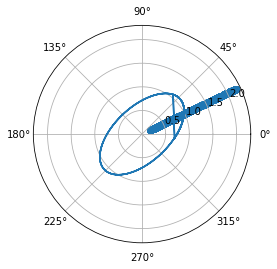

 10%|▉         | 97/1000 [00:35<04:48,  3.13it/s]

1.944674479026159


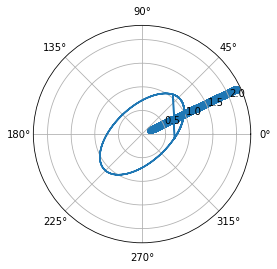

 10%|▉         | 98/1000 [00:35<04:41,  3.20it/s]

1.9408369691530818


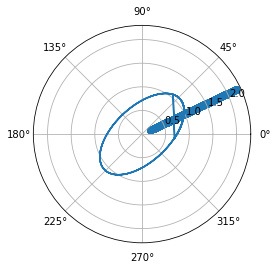

 10%|▉         | 99/1000 [00:36<04:57,  3.02it/s]

1.9415870154031922


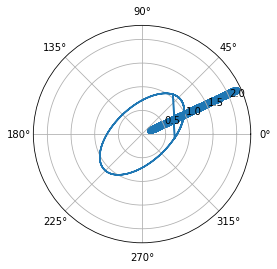

 10%|█         | 100/1000 [00:36<05:08,  2.92it/s]

1.9373498343367748


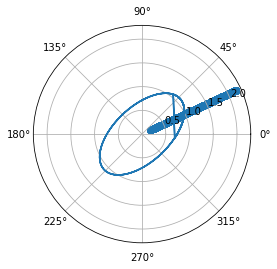

 10%|█         | 101/1000 [00:36<04:59,  3.00it/s]

1.935309235280686


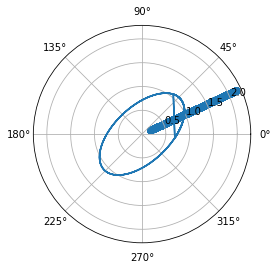

 10%|█         | 102/1000 [00:37<04:54,  3.05it/s]

1.932843551296152


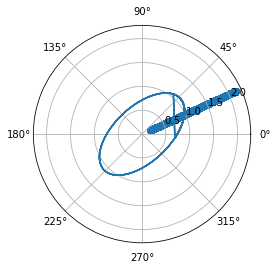

 10%|█         | 103/1000 [00:37<05:02,  2.97it/s]

1.929759669522131


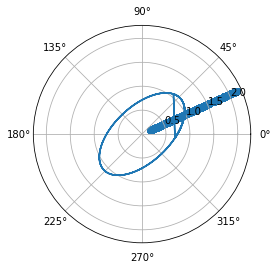

 10%|█         | 104/1000 [00:37<04:58,  3.00it/s]

1.9280734364361571


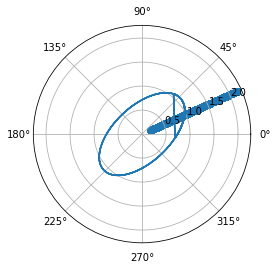

 10%|█         | 105/1000 [00:38<04:55,  3.03it/s]

1.9279984725023398


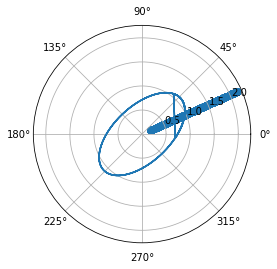

 11%|█         | 106/1000 [00:38<04:57,  3.01it/s]

1.9225683058452208


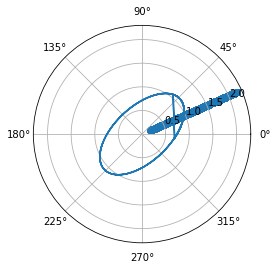

 11%|█         | 107/1000 [00:38<04:55,  3.03it/s]

1.922324662458242


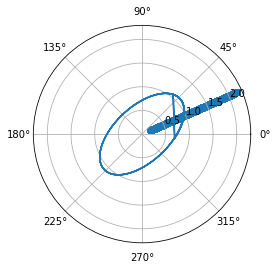

 11%|█         | 108/1000 [00:39<04:47,  3.11it/s]

1.9179769877483908


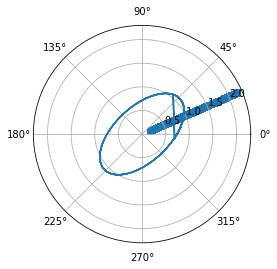

 11%|█         | 109/1000 [00:39<04:45,  3.12it/s]

1.9186028159337183


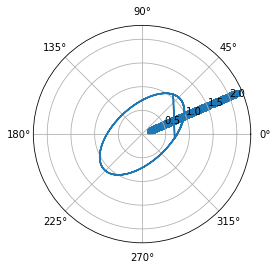

 11%|█         | 110/1000 [00:39<04:55,  3.01it/s]

1.9137625757425354


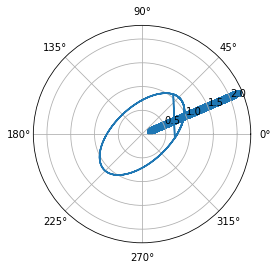

 11%|█         | 111/1000 [00:40<05:01,  2.95it/s]

1.9118449922558136


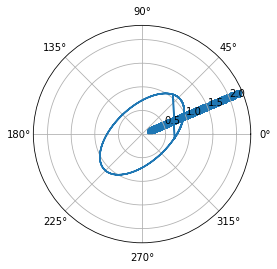

 11%|█         | 112/1000 [00:40<04:53,  3.03it/s]

1.909559963782556


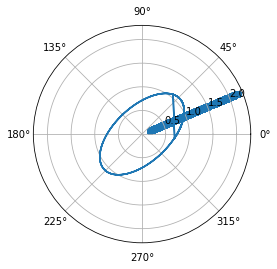

 11%|█▏        | 113/1000 [00:40<04:50,  3.05it/s]

1.906748486059411


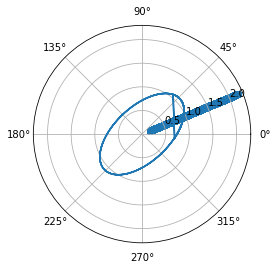

 11%|█▏        | 114/1000 [00:41<04:52,  3.03it/s]

1.9031419245038101


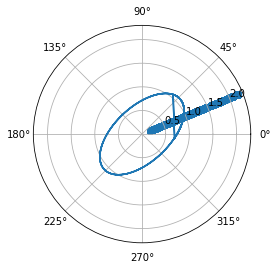

 12%|█▏        | 115/1000 [00:41<04:53,  3.02it/s]

1.902633518124517


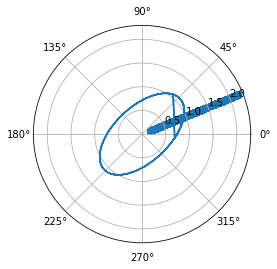

 12%|█▏        | 116/1000 [00:41<04:47,  3.08it/s]

1.901505877792619


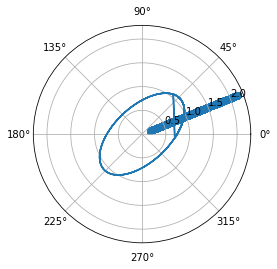

 12%|█▏        | 117/1000 [00:42<05:05,  2.89it/s]

1.8965810299370416


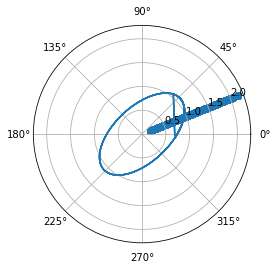

 12%|█▏        | 118/1000 [00:42<05:16,  2.78it/s]

1.8969280159231685


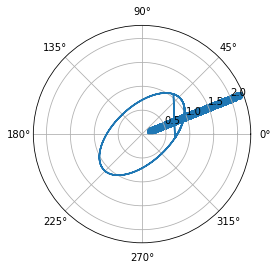

 12%|█▏        | 119/1000 [00:43<05:06,  2.88it/s]

1.8926777397941528


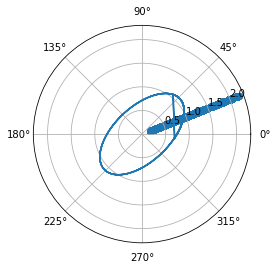

 12%|█▏        | 120/1000 [00:43<04:56,  2.97it/s]

1.8923715340727212


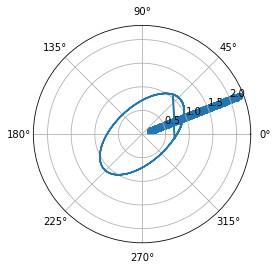

 12%|█▏        | 121/1000 [00:43<05:03,  2.90it/s]

1.888287777050188


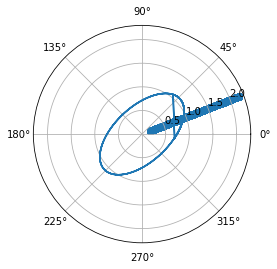

 12%|█▏        | 122/1000 [00:44<05:00,  2.92it/s]

1.883769775149283


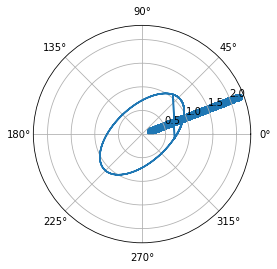

 12%|█▏        | 123/1000 [00:44<04:55,  2.97it/s]

1.8818874480061947


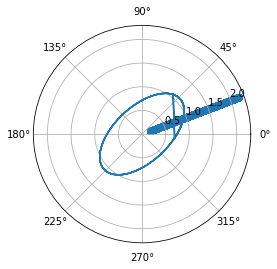

 12%|█▏        | 124/1000 [00:44<04:54,  2.98it/s]

1.880678937520167


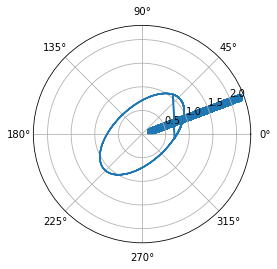

 12%|█▎        | 125/1000 [00:45<04:59,  2.92it/s]

1.8797385226898062


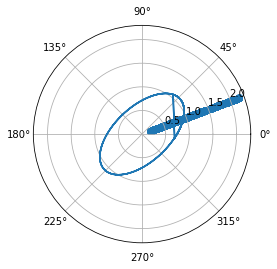

 13%|█▎        | 126/1000 [00:45<04:53,  2.98it/s]

1.8758963882044466


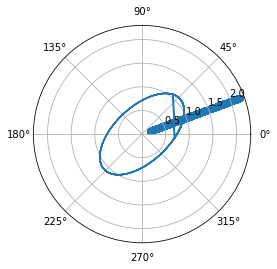

 13%|█▎        | 127/1000 [00:45<04:51,  3.00it/s]

1.8722104704916602


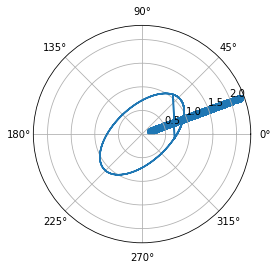

 13%|█▎        | 128/1000 [00:46<04:54,  2.96it/s]

1.8722780063577877


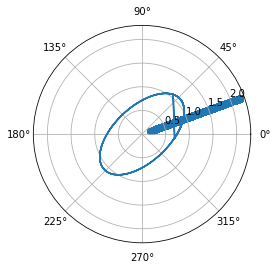

 13%|█▎        | 129/1000 [00:46<04:49,  3.01it/s]

1.8675166696718415


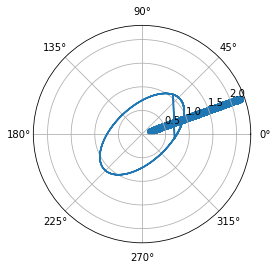

 13%|█▎        | 130/1000 [00:46<04:52,  2.97it/s]

1.8667836038295382


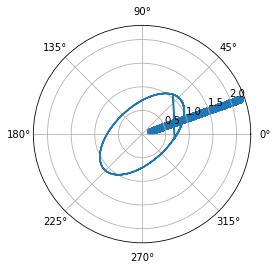

 13%|█▎        | 131/1000 [00:47<04:55,  2.94it/s]

1.8622886532474319


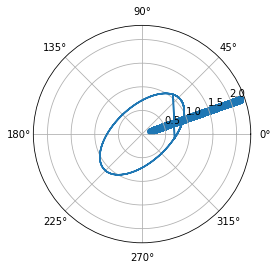

 13%|█▎        | 132/1000 [00:47<04:59,  2.90it/s]

1.8605706428954405


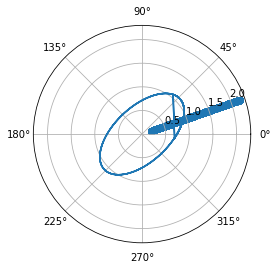

 13%|█▎        | 133/1000 [00:47<04:49,  3.00it/s]

1.8585533404956125


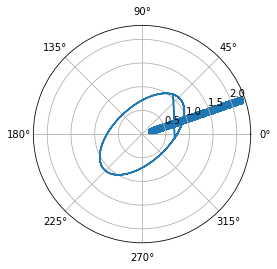

 13%|█▎        | 134/1000 [00:48<04:52,  2.96it/s]

1.8561080847245768


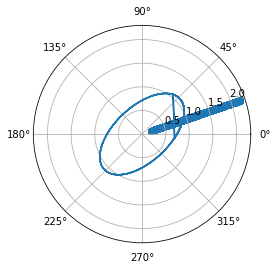

 14%|█▎        | 135/1000 [00:48<06:22,  2.26it/s]

1.8530173656354347


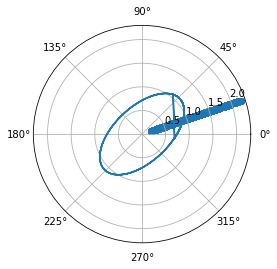

 14%|█▎        | 136/1000 [00:49<06:03,  2.38it/s]

1.848881967578812


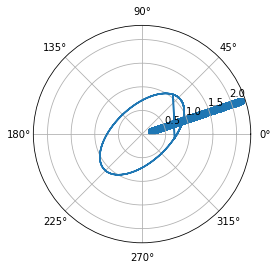

 14%|█▎        | 137/1000 [00:49<05:40,  2.54it/s]

1.8482171424512503


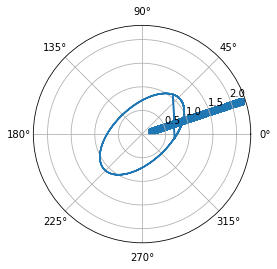

 14%|█▍        | 138/1000 [00:49<05:27,  2.63it/s]

1.8477513664626655


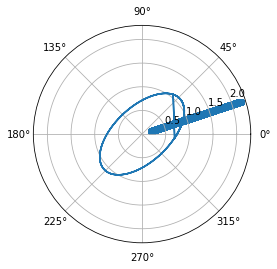

 14%|█▍        | 139/1000 [00:50<05:14,  2.74it/s]

1.8422009287966103


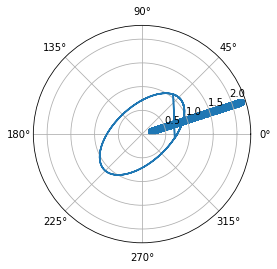

 14%|█▍        | 140/1000 [00:50<05:04,  2.82it/s]

1.842221562325815


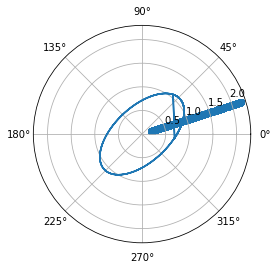

 14%|█▍        | 141/1000 [00:50<04:57,  2.89it/s]

1.838702044636785


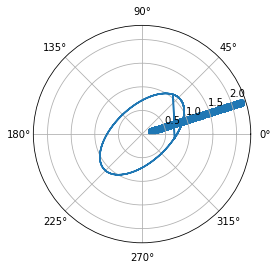

 14%|█▍        | 142/1000 [00:51<04:55,  2.91it/s]

1.8376245009689505


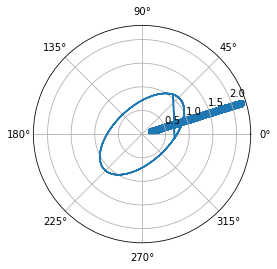

 14%|█▍        | 143/1000 [00:51<04:46,  2.99it/s]

1.8312677246658842


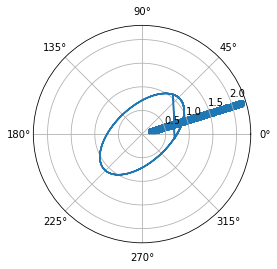

 14%|█▍        | 144/1000 [00:51<04:39,  3.06it/s]

1.829249117908213


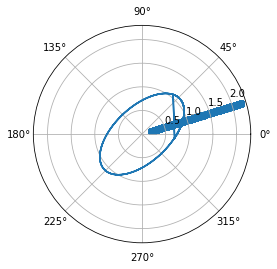

 14%|█▍        | 145/1000 [00:52<04:32,  3.14it/s]

1.8268005922355104


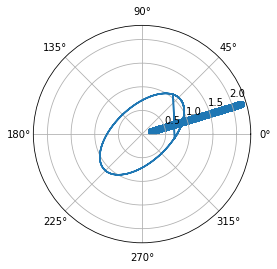

 15%|█▍        | 146/1000 [00:52<04:34,  3.11it/s]

1.8238147201667914


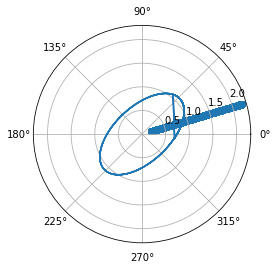

 15%|█▍        | 147/1000 [00:52<04:31,  3.14it/s]

1.8225846065442808


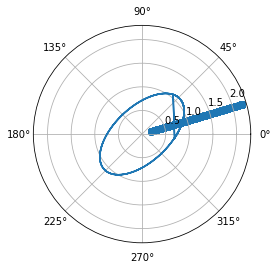

 15%|█▍        | 148/1000 [00:52<04:26,  3.19it/s]

1.8215313352517477


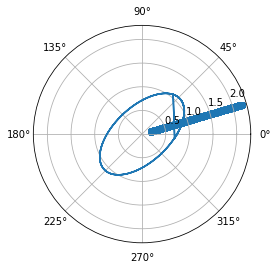

 15%|█▍        | 149/1000 [00:53<04:25,  3.20it/s]

1.820005484194445


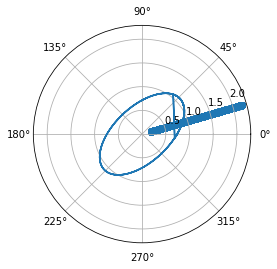

 15%|█▌        | 150/1000 [00:53<04:28,  3.17it/s]

1.8147246178746428


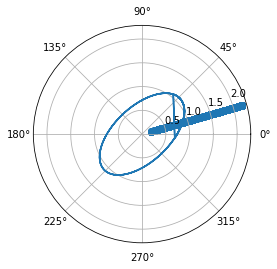

 15%|█▌        | 151/1000 [00:53<04:25,  3.20it/s]

1.814406860727787


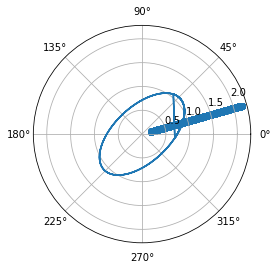

 15%|█▌        | 152/1000 [00:54<04:39,  3.03it/s]

1.8118092435870512


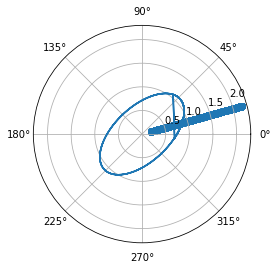

 15%|█▌        | 153/1000 [00:54<04:55,  2.86it/s]

1.8064595451419787


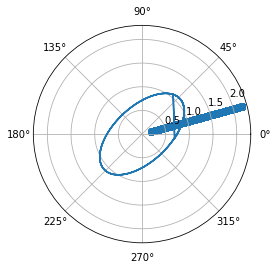

 15%|█▌        | 154/1000 [00:55<04:44,  2.97it/s]

1.805309314855133


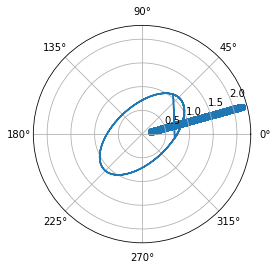

 16%|█▌        | 155/1000 [00:55<04:32,  3.10it/s]

1.8040182777538132


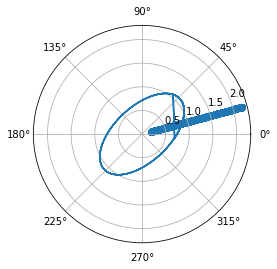

 16%|█▌        | 156/1000 [00:55<04:30,  3.12it/s]

1.8025289194714964


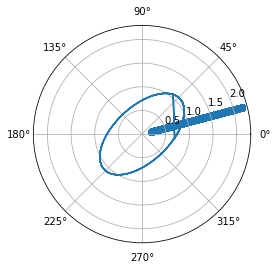

 16%|█▌        | 157/1000 [00:55<04:29,  3.13it/s]

1.8001426762206247


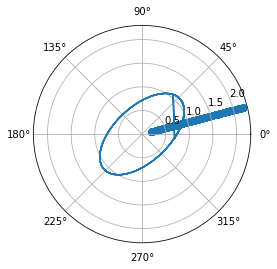

 16%|█▌        | 158/1000 [00:56<04:24,  3.19it/s]

1.797557024154559


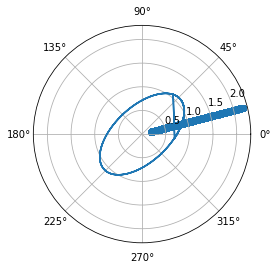

 16%|█▌        | 159/1000 [00:56<04:21,  3.22it/s]

1.7954122349836197


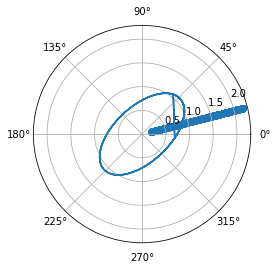

 16%|█▌        | 160/1000 [00:56<04:23,  3.18it/s]

1.7906645584774172


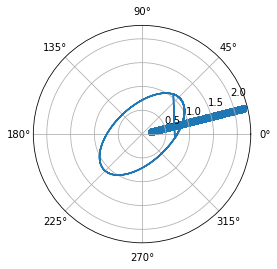

 16%|█▌        | 161/1000 [00:57<04:42,  2.97it/s]

1.787246886376932


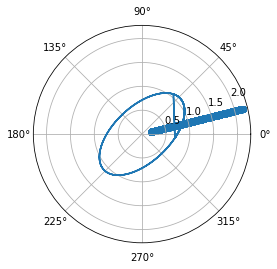

 16%|█▌        | 162/1000 [00:57<04:48,  2.90it/s]

1.7864368920979052


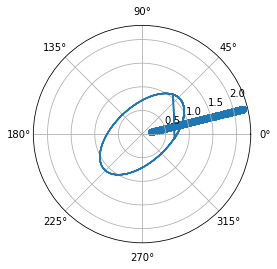

 16%|█▋        | 163/1000 [00:57<04:42,  2.97it/s]

1.7855207734474867


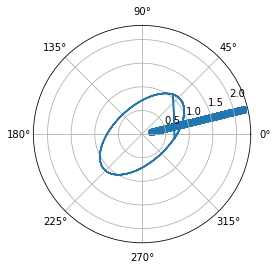

 16%|█▋        | 164/1000 [00:58<05:14,  2.66it/s]

1.7808081052386868


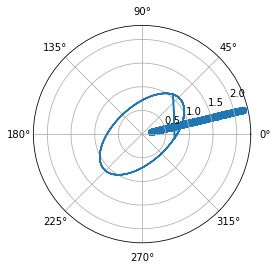

 16%|█▋        | 165/1000 [00:58<05:06,  2.72it/s]

1.7805066784749126


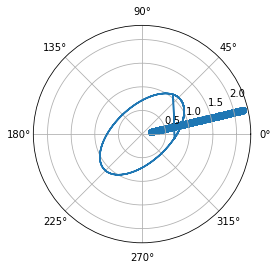

 17%|█▋        | 166/1000 [00:59<05:04,  2.74it/s]

1.774560738511919


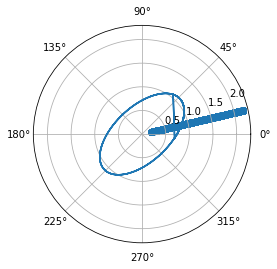

 17%|█▋        | 167/1000 [00:59<04:51,  2.86it/s]

1.7737001876688476


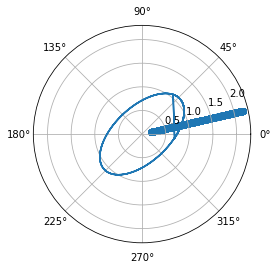

 17%|█▋        | 168/1000 [00:59<04:55,  2.81it/s]

1.7727669089804807


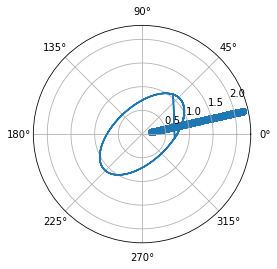

 17%|█▋        | 169/1000 [01:00<04:57,  2.79it/s]

1.7696532786598635


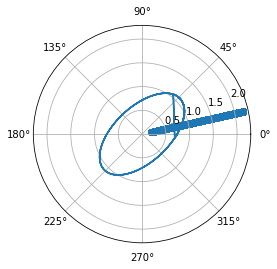

 17%|█▋        | 170/1000 [01:00<05:04,  2.73it/s]

1.7666594183286013


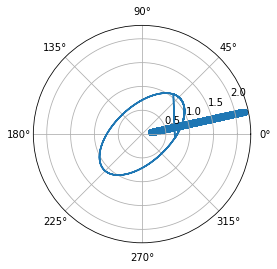

 17%|█▋        | 171/1000 [01:00<05:12,  2.65it/s]

1.7642440681668883


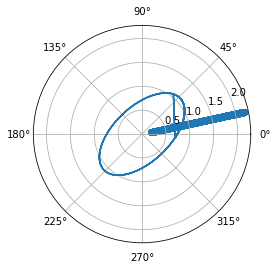

 17%|█▋        | 172/1000 [01:01<05:05,  2.71it/s]

1.762215354299024


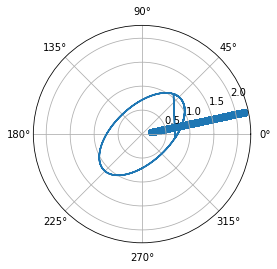

 17%|█▋        | 173/1000 [01:01<05:11,  2.65it/s]

1.760456680109288


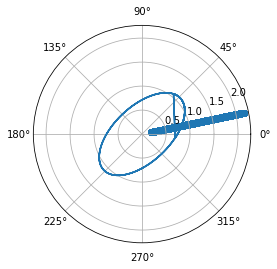

 17%|█▋        | 174/1000 [01:02<05:22,  2.56it/s]

1.7544604893847575


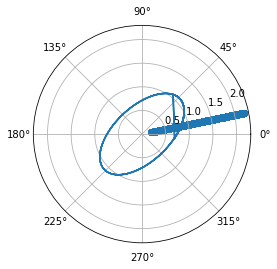

 18%|█▊        | 175/1000 [01:02<05:10,  2.66it/s]

1.7540899396900145


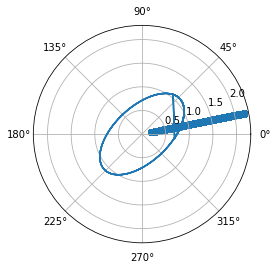

 18%|█▊        | 176/1000 [01:02<04:51,  2.83it/s]

1.7498300634652988


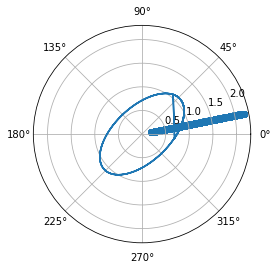

 18%|█▊        | 177/1000 [01:03<04:54,  2.80it/s]

1.7501014366412835


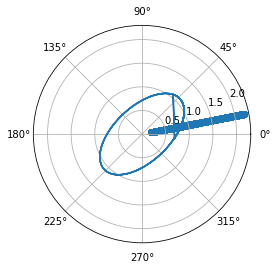

 18%|█▊        | 178/1000 [01:03<04:56,  2.78it/s]

1.7447009165773881


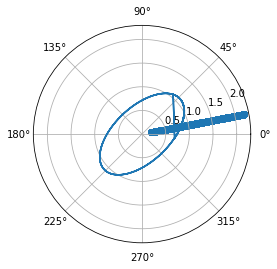

 18%|█▊        | 179/1000 [01:03<04:45,  2.88it/s]

1.7447280594357417


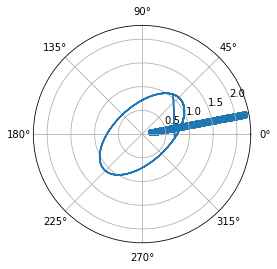

 18%|█▊        | 180/1000 [01:04<04:35,  2.97it/s]

1.7419240777825173


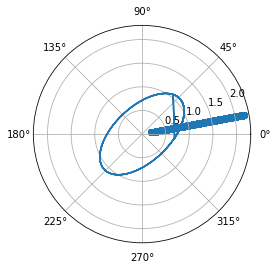

 18%|█▊        | 181/1000 [01:04<04:36,  2.96it/s]

1.7373196912253572


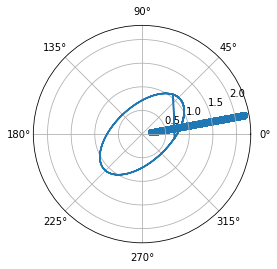

 18%|█▊        | 182/1000 [01:04<04:55,  2.77it/s]

1.7356726727022356


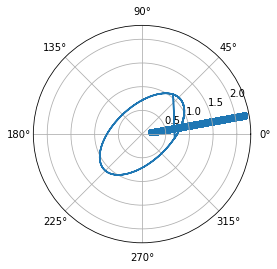

 18%|█▊        | 183/1000 [01:05<04:48,  2.83it/s]

1.7347522005291858


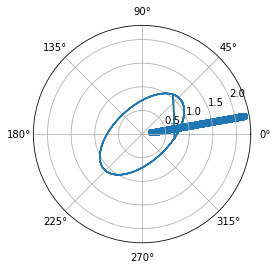

 18%|█▊        | 184/1000 [01:05<04:49,  2.82it/s]

1.7336504960498733


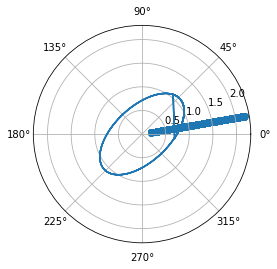

 18%|█▊        | 185/1000 [01:06<05:43,  2.37it/s]

1.7312976492987067


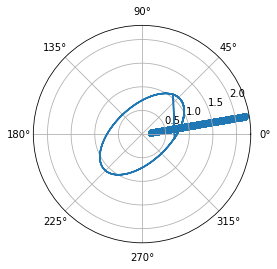

 19%|█▊        | 186/1000 [01:06<05:51,  2.32it/s]

1.728109612998564


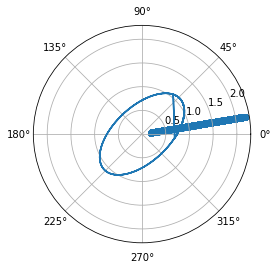

 19%|█▊        | 187/1000 [01:06<05:37,  2.41it/s]

1.7260704842988819


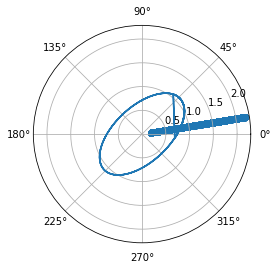

 19%|█▉        | 188/1000 [01:07<05:15,  2.57it/s]

1.722826703381366


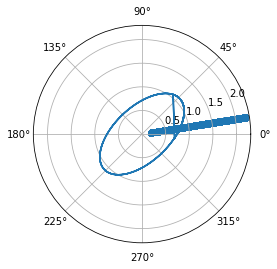

 19%|█▉        | 189/1000 [01:07<05:16,  2.56it/s]

1.7190868528148873


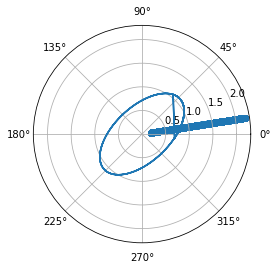

 19%|█▉        | 190/1000 [01:08<05:11,  2.60it/s]

1.7163617528565296


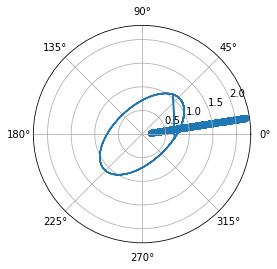

 19%|█▉        | 191/1000 [01:08<04:53,  2.75it/s]

1.7157571237145461


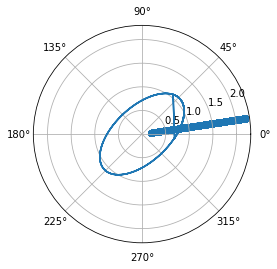

 19%|█▉        | 192/1000 [01:08<04:46,  2.82it/s]

1.7106064005742798


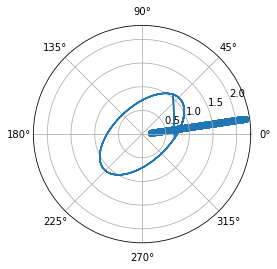

 19%|█▉        | 193/1000 [01:09<04:42,  2.86it/s]

1.7112286290646315


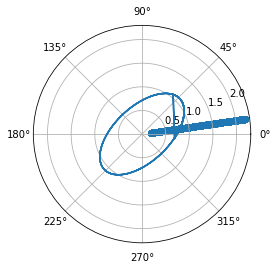

 19%|█▉        | 194/1000 [01:09<04:37,  2.90it/s]

1.7072513587822211


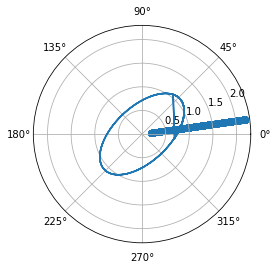

 20%|█▉        | 195/1000 [01:09<04:29,  2.98it/s]

1.703906788645669


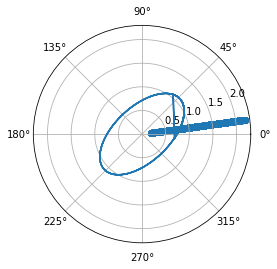

 20%|█▉        | 196/1000 [01:10<04:22,  3.06it/s]

1.7047271099864887


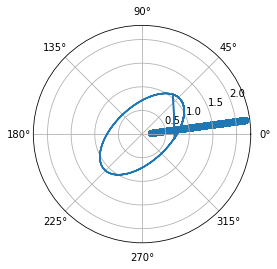

 20%|█▉        | 197/1000 [01:10<04:20,  3.08it/s]

1.7010553876605676


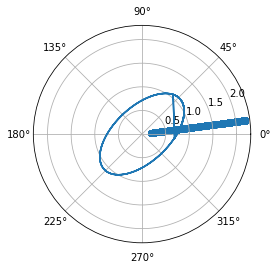

 20%|█▉        | 198/1000 [01:10<04:19,  3.08it/s]

1.6979013003543046


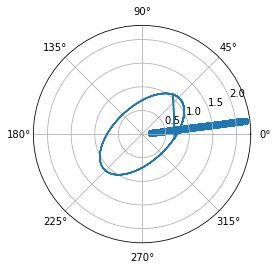

 20%|█▉        | 199/1000 [01:10<04:13,  3.16it/s]

1.6951409180098418


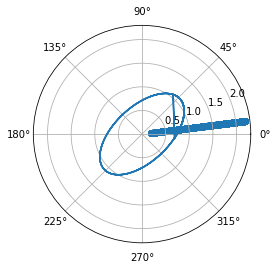

 20%|██        | 200/1000 [01:11<04:05,  3.26it/s]

1.694004376686373


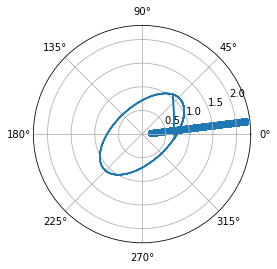

 20%|██        | 201/1000 [01:11<04:10,  3.18it/s]

1.6915540045779793


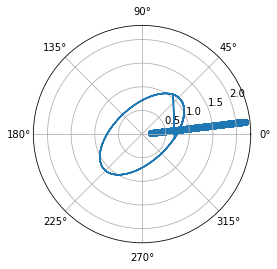

 20%|██        | 202/1000 [01:11<04:11,  3.17it/s]

1.6887853214058426


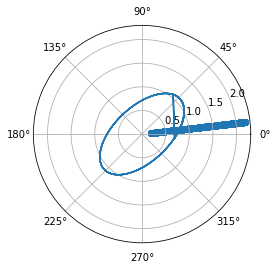

 20%|██        | 203/1000 [01:12<04:14,  3.14it/s]

1.685601363973076


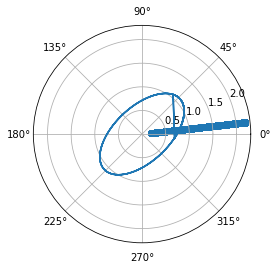

 20%|██        | 204/1000 [01:12<04:14,  3.12it/s]

1.6818599723217722


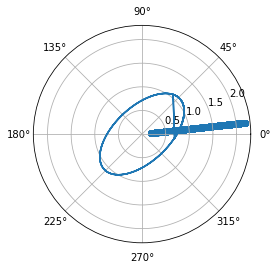

 20%|██        | 205/1000 [01:12<04:21,  3.04it/s]

1.682405468777452


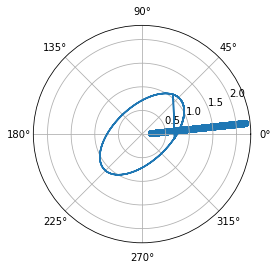

 21%|██        | 206/1000 [01:13<04:20,  3.05it/s]

1.679855181232417


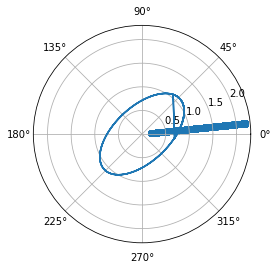

 21%|██        | 207/1000 [01:13<04:39,  2.84it/s]

1.6753553145329854


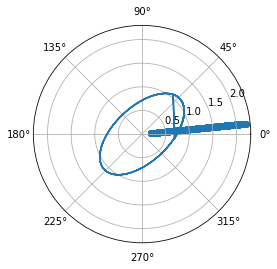

 21%|██        | 208/1000 [01:13<04:42,  2.80it/s]

1.6760569138021333


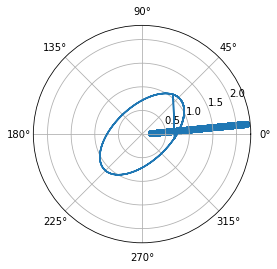

 21%|██        | 209/1000 [01:14<04:39,  2.83it/s]

1.6706510864558344


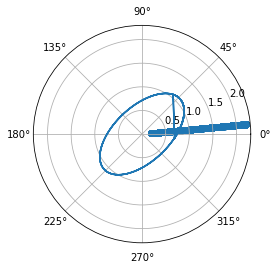

 21%|██        | 210/1000 [01:14<04:29,  2.93it/s]

1.6713888940403405


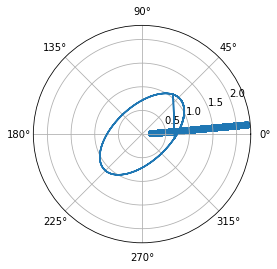

 21%|██        | 211/1000 [01:14<04:29,  2.93it/s]

1.667070282327993


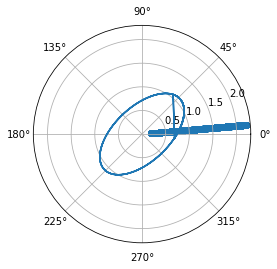

 21%|██        | 212/1000 [01:15<04:27,  2.95it/s]

1.6633104448872404


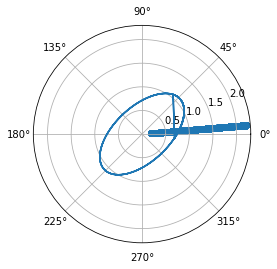

 21%|██▏       | 213/1000 [01:15<04:19,  3.03it/s]

1.6648997021251148


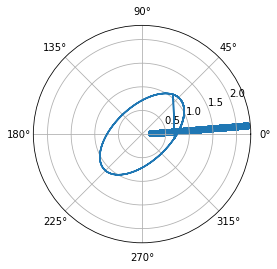

 21%|██▏       | 214/1000 [01:15<04:16,  3.06it/s]

1.6601713062311303


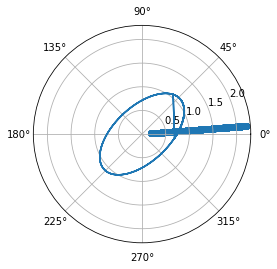

 22%|██▏       | 215/1000 [01:16<04:28,  2.93it/s]

1.658620454912811


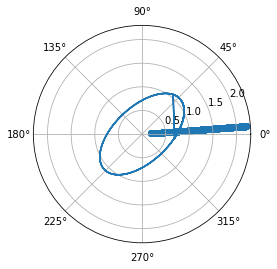

 22%|██▏       | 216/1000 [01:16<04:22,  2.99it/s]

1.6569252863186676


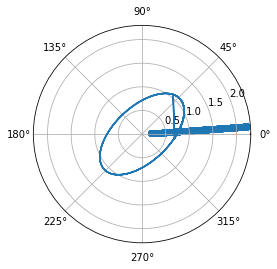

 22%|██▏       | 217/1000 [01:16<04:11,  3.11it/s]

1.655045460657183


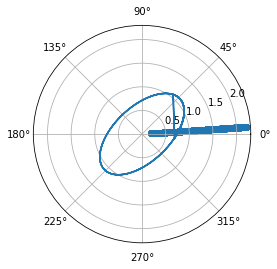

 22%|██▏       | 218/1000 [01:17<04:03,  3.21it/s]

1.652922990452974


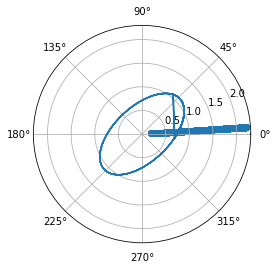

 22%|██▏       | 219/1000 [01:17<04:07,  3.16it/s]

1.6504713872391843


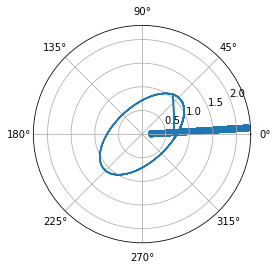

 22%|██▏       | 220/1000 [01:17<04:12,  3.09it/s]

1.6475556751257663


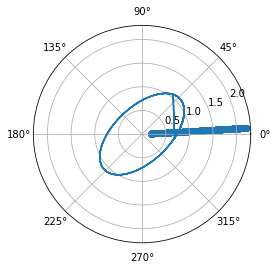

 22%|██▏       | 221/1000 [01:18<04:13,  3.07it/s]

1.643952842569001


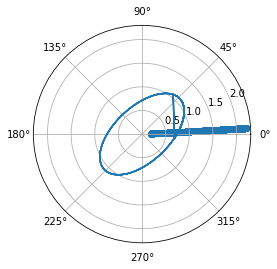

 22%|██▏       | 222/1000 [01:18<04:08,  3.14it/s]

1.6406779105818705


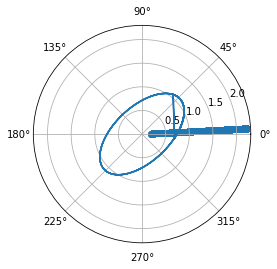

 22%|██▏       | 223/1000 [01:18<04:21,  2.97it/s]

1.6400507647362186


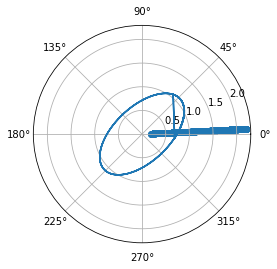

 22%|██▏       | 224/1000 [01:19<04:12,  3.07it/s]

1.6393907915348624


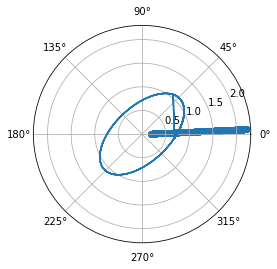

 22%|██▎       | 225/1000 [01:19<04:17,  3.01it/s]

1.6339145534960107


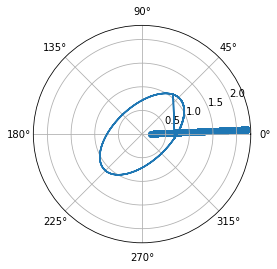

 23%|██▎       | 226/1000 [01:19<04:14,  3.05it/s]

1.6335989751382667


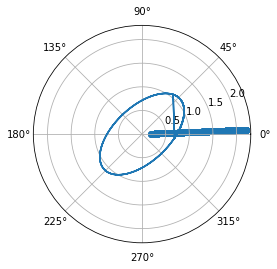

 23%|██▎       | 227/1000 [01:20<04:12,  3.07it/s]

1.629085650447445


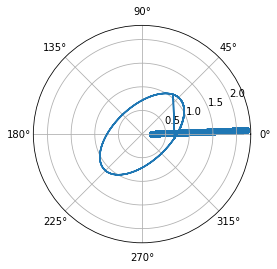

 23%|██▎       | 228/1000 [01:20<04:08,  3.10it/s]

1.628288563304094


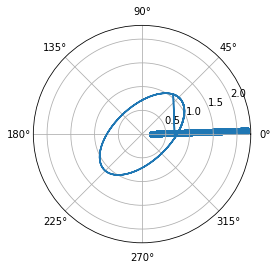

 23%|██▎       | 229/1000 [01:20<04:02,  3.18it/s]

1.6279942604919282


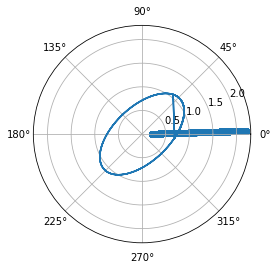

 23%|██▎       | 230/1000 [01:21<04:15,  3.01it/s]

1.6229080142993635


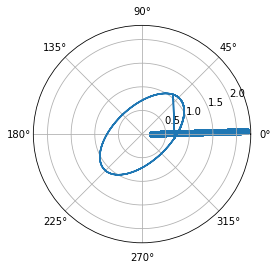

 23%|██▎       | 231/1000 [01:21<04:37,  2.77it/s]

1.6223730611749905


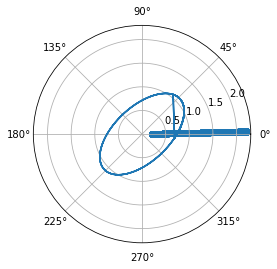

 23%|██▎       | 232/1000 [01:21<04:38,  2.76it/s]

1.6211793161801564


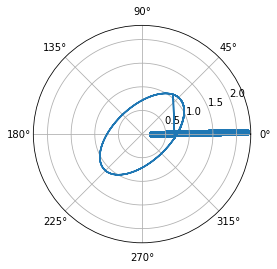

 23%|██▎       | 233/1000 [01:22<04:28,  2.86it/s]

1.6160906205956764


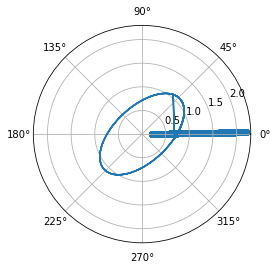

 23%|██▎       | 234/1000 [01:22<04:38,  2.75it/s]

1.6139526810729812


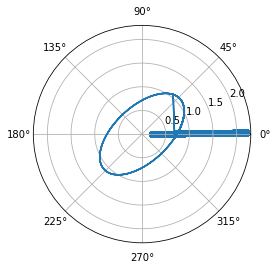

 24%|██▎       | 235/1000 [01:22<04:23,  2.91it/s]

1.6127812432636928


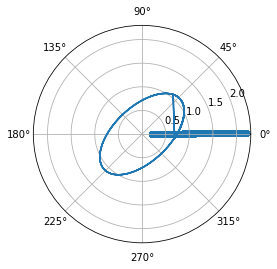

 24%|██▎       | 236/1000 [01:23<04:10,  3.04it/s]

1.611489556154849


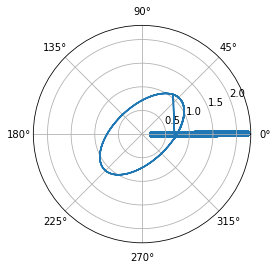

 24%|██▎       | 237/1000 [01:23<04:25,  2.87it/s]

1.6100176208029582


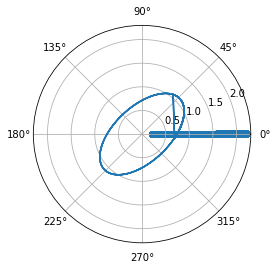

 24%|██▍       | 238/1000 [01:23<04:23,  2.89it/s]

1.6082536794152136


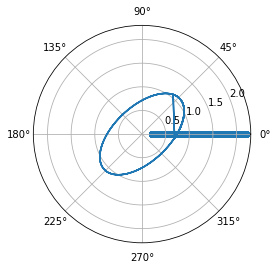

 24%|██▍       | 239/1000 [01:24<04:36,  2.75it/s]

1.6059629912434117


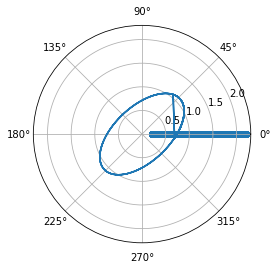

 24%|██▍       | 240/1000 [01:24<04:31,  2.80it/s]

1.6025543383433258


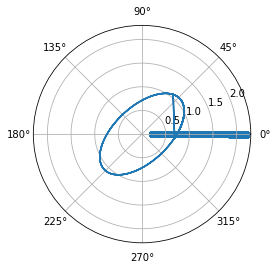

 24%|██▍       | 241/1000 [01:25<04:27,  2.84it/s]

1.59801526120944


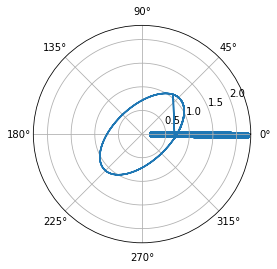

 24%|██▍       | 242/1000 [01:25<04:11,  3.01it/s]

1.5966569136504658


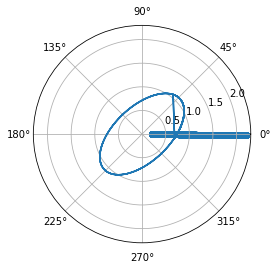

 24%|██▍       | 243/1000 [01:25<04:25,  2.85it/s]

1.5954550258147429


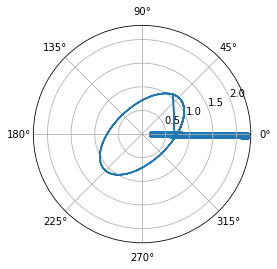

 24%|██▍       | 244/1000 [01:26<04:37,  2.72it/s]

1.5921654271618666


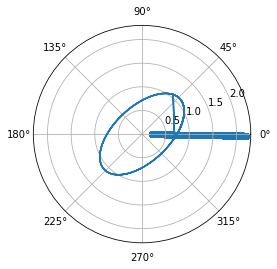

 24%|██▍       | 245/1000 [01:26<04:43,  2.66it/s]

1.592475572715587


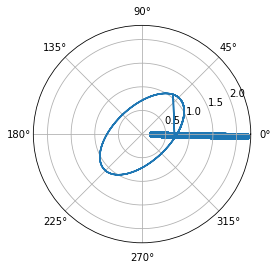

 25%|██▍       | 246/1000 [01:26<04:32,  2.76it/s]

1.5893833570778044


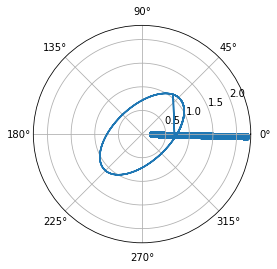

 25%|██▍       | 247/1000 [01:27<04:24,  2.85it/s]

1.5851681600659844


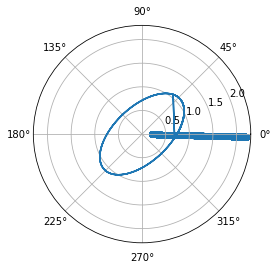

 25%|██▍       | 248/1000 [01:27<04:22,  2.87it/s]

1.586171423176579


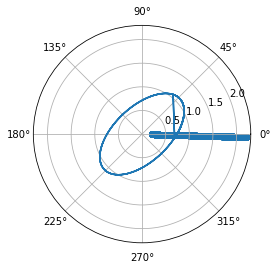

 25%|██▍       | 249/1000 [01:27<04:10,  3.00it/s]

1.5811277337166274


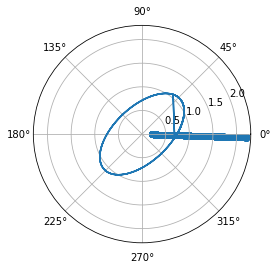

 25%|██▌       | 250/1000 [01:28<04:08,  3.01it/s]

1.5821225619700314


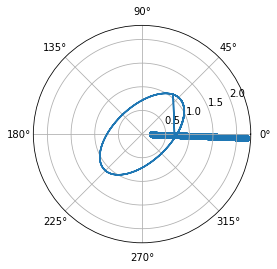

 25%|██▌       | 251/1000 [01:28<04:26,  2.81it/s]

1.576437800572002


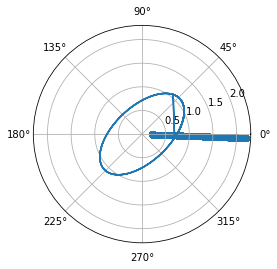

 25%|██▌       | 252/1000 [01:28<04:28,  2.79it/s]

1.5770704138608271


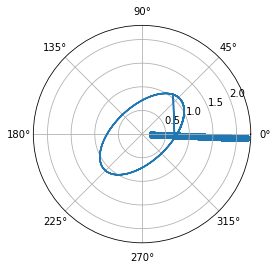

 25%|██▌       | 253/1000 [01:29<04:23,  2.83it/s]

1.5739736599189398


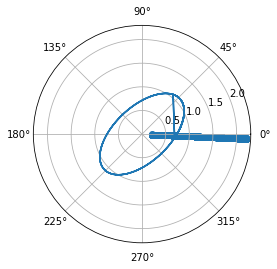

 25%|██▌       | 254/1000 [01:29<04:23,  2.83it/s]

1.570069112629178


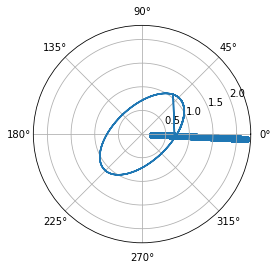

 26%|██▌       | 255/1000 [01:30<04:21,  2.85it/s]

1.5706730471454664


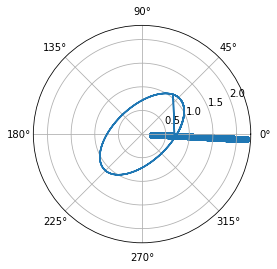

 26%|██▌       | 256/1000 [01:30<04:27,  2.79it/s]

1.5683724097516132


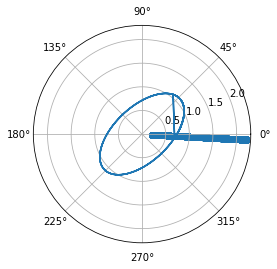

 26%|██▌       | 257/1000 [01:30<04:28,  2.77it/s]

1.5653330221118202


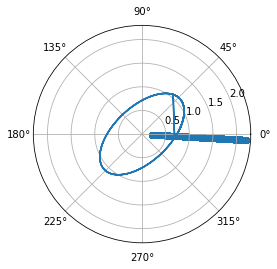

 26%|██▌       | 258/1000 [01:31<04:26,  2.78it/s]

1.562578257170408


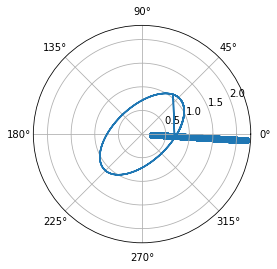

 26%|██▌       | 259/1000 [01:31<05:21,  2.30it/s]

1.5600571304499629


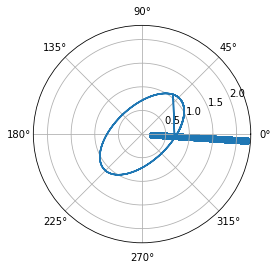

 26%|██▌       | 260/1000 [01:32<05:23,  2.29it/s]

1.5604075498828625


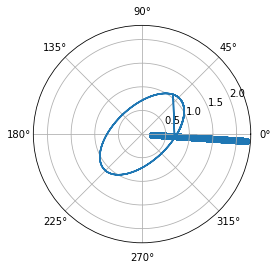

 26%|██▌       | 261/1000 [01:32<05:19,  2.31it/s]

1.5585584504917656


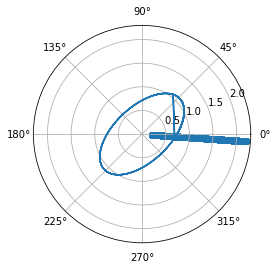

 26%|██▌       | 262/1000 [01:32<04:58,  2.47it/s]

1.5565729978650804


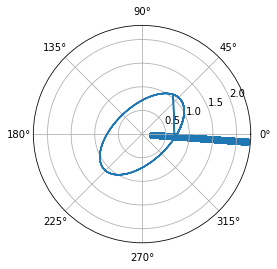

 26%|██▋       | 263/1000 [01:33<04:55,  2.50it/s]

1.5544222719422987


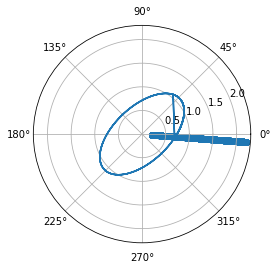

 26%|██▋       | 264/1000 [01:33<04:47,  2.56it/s]

1.552068055604992


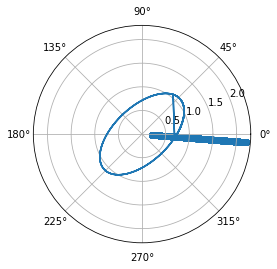

 26%|██▋       | 265/1000 [01:33<04:29,  2.73it/s]

1.5494587681901275


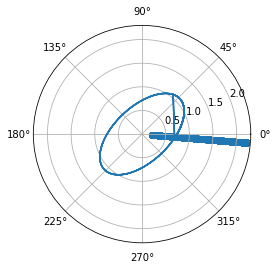

 27%|██▋       | 266/1000 [01:34<04:15,  2.87it/s]

1.546523060198852


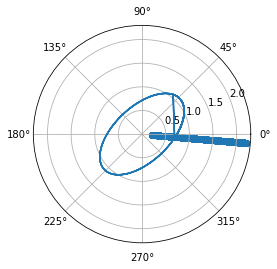

 27%|██▋       | 267/1000 [01:34<04:14,  2.88it/s]

1.5431593331526012


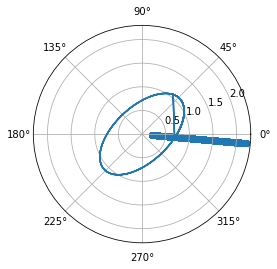

 27%|██▋       | 268/1000 [01:34<04:07,  2.96it/s]

1.5416037318686884


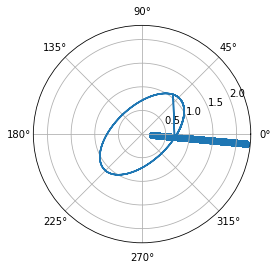

 27%|██▋       | 269/1000 [01:35<03:56,  3.09it/s]

1.5413481458394558


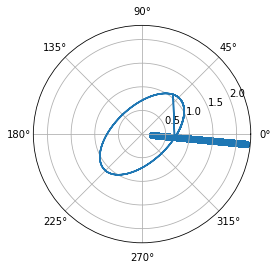

 27%|██▋       | 270/1000 [01:35<03:54,  3.11it/s]

1.5385632831139933


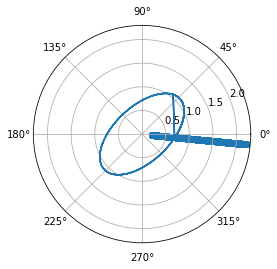

 27%|██▋       | 271/1000 [01:36<04:24,  2.75it/s]

1.5350003705875153


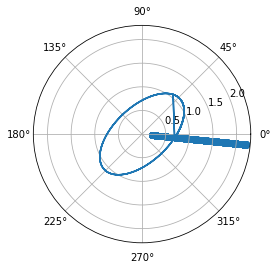

 27%|██▋       | 272/1000 [01:36<04:44,  2.56it/s]

1.53492135215523


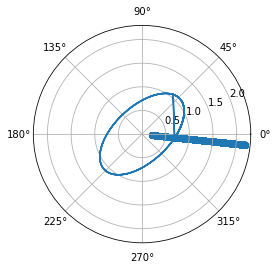

 27%|██▋       | 273/1000 [01:36<04:30,  2.69it/s]

1.5308279199439199


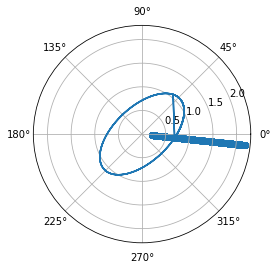

 27%|██▋       | 274/1000 [01:37<04:33,  2.65it/s]

1.530026196145376


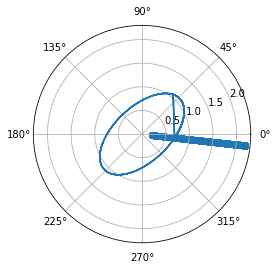

 28%|██▊       | 275/1000 [01:37<04:28,  2.71it/s]

1.5285521608778603


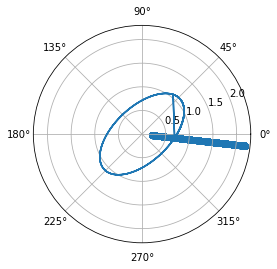

 28%|██▊       | 276/1000 [01:37<04:16,  2.82it/s]

1.5258799078283602


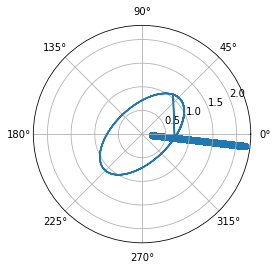

 28%|██▊       | 277/1000 [01:38<04:10,  2.89it/s]

1.5257210165192363


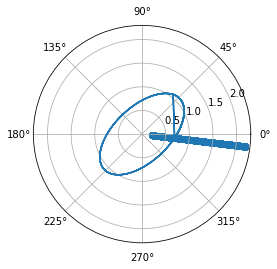

 28%|██▊       | 278/1000 [01:38<04:01,  2.99it/s]

1.5214121297340528


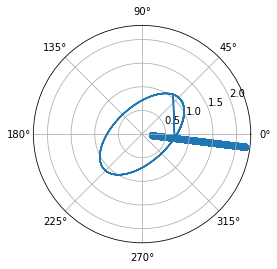

 28%|██▊       | 279/1000 [01:38<04:07,  2.91it/s]

1.5209725469533124


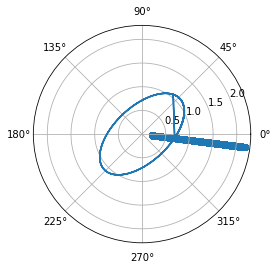

 28%|██▊       | 280/1000 [01:39<04:01,  2.99it/s]

1.5161873336328855


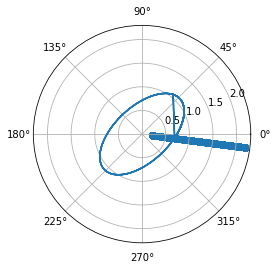

 28%|██▊       | 281/1000 [01:39<03:57,  3.03it/s]

1.513954281271157


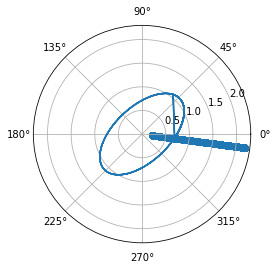

 28%|██▊       | 282/1000 [01:39<03:51,  3.10it/s]

1.5119470926857015


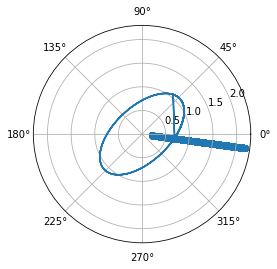

 28%|██▊       | 283/1000 [01:40<03:53,  3.08it/s]

1.5099440422310384


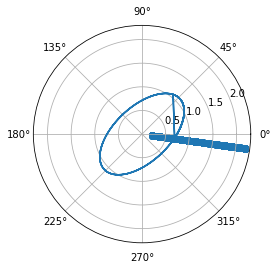

 28%|██▊       | 284/1000 [01:40<03:48,  3.14it/s]

1.5079451179737218


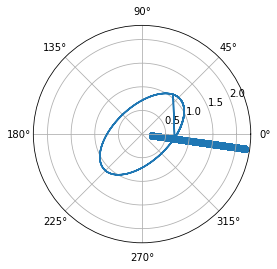

 28%|██▊       | 285/1000 [01:40<03:52,  3.07it/s]

1.5059503120977813


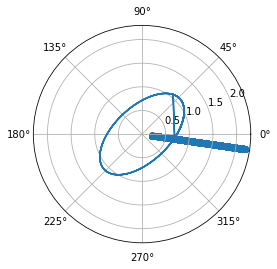

 29%|██▊       | 286/1000 [01:41<03:46,  3.15it/s]

1.5039595961392287


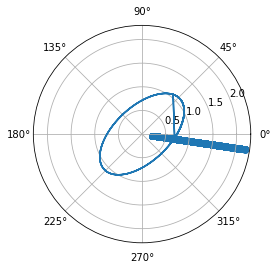

 29%|██▊       | 287/1000 [01:41<03:43,  3.19it/s]

1.501972954017779


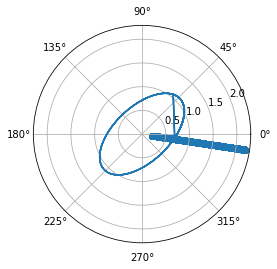

 29%|██▉       | 288/1000 [01:41<03:40,  3.23it/s]

1.4999903692599499


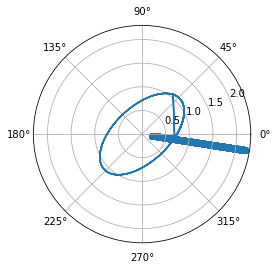

 29%|██▉       | 289/1000 [01:42<03:47,  3.13it/s]

1.4980118250041854


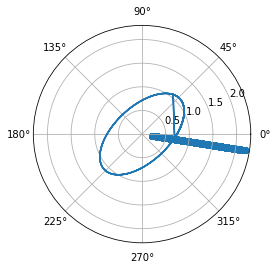

 29%|██▉       | 290/1000 [01:42<03:43,  3.18it/s]

1.4960373040061208


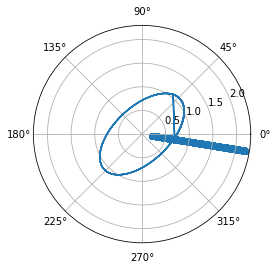

 29%|██▉       | 291/1000 [01:42<03:39,  3.23it/s]

1.4940667886439882


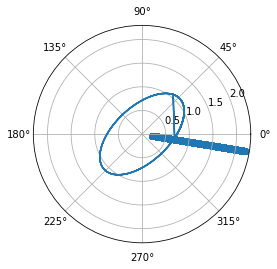

 29%|██▉       | 292/1000 [01:42<03:45,  3.14it/s]

1.4921002609241614


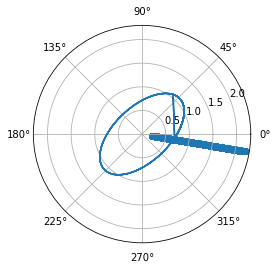

 29%|██▉       | 293/1000 [01:43<03:46,  3.12it/s]

1.4901377024868476


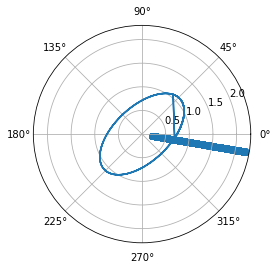

 29%|██▉       | 294/1000 [01:43<03:41,  3.19it/s]

1.488179094611924


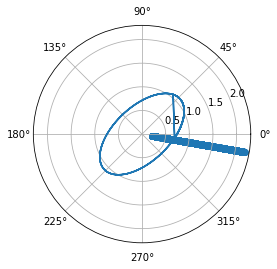

 30%|██▉       | 295/1000 [01:43<03:37,  3.24it/s]

1.4862244182249176


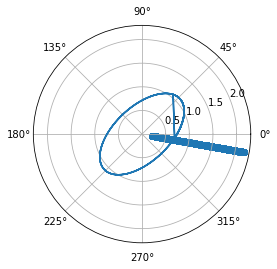

 30%|██▉       | 296/1000 [01:44<03:39,  3.21it/s]

1.4842736560729546


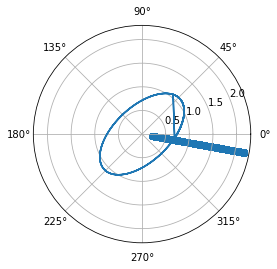

 30%|██▉       | 297/1000 [01:44<03:56,  2.97it/s]

1.482326800999655


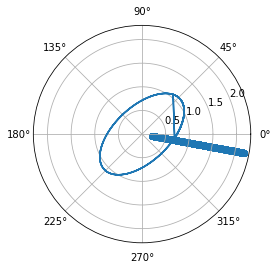

 30%|██▉       | 298/1000 [01:44<03:55,  2.98it/s]

1.4803838207119686


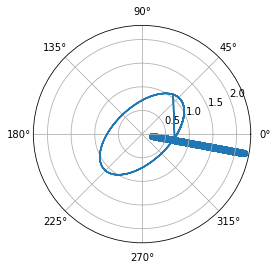

 30%|██▉       | 299/1000 [01:45<03:56,  2.97it/s]

1.4784446947857999


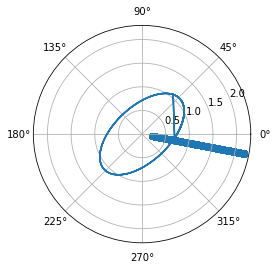

 30%|███       | 300/1000 [01:45<04:04,  2.86it/s]

1.4765094027681755


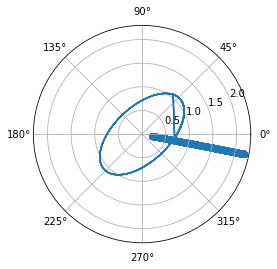

 30%|███       | 301/1000 [01:46<04:06,  2.83it/s]

1.474577950012731


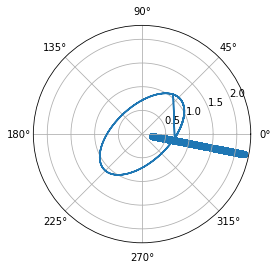

 30%|███       | 302/1000 [01:46<03:54,  2.97it/s]

1.4726502910374342


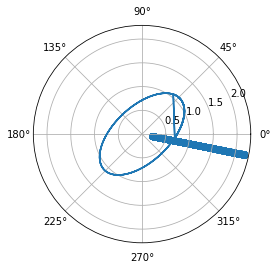

 30%|███       | 303/1000 [01:46<04:15,  2.73it/s]

1.4707264072242867


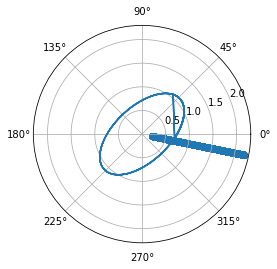

 30%|███       | 304/1000 [01:47<04:12,  2.76it/s]

1.4688063050131217


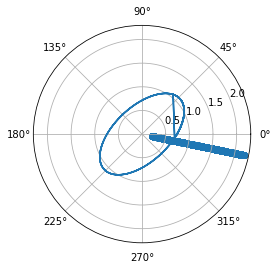

 30%|███       | 305/1000 [01:47<04:02,  2.87it/s]

1.4668899332810166


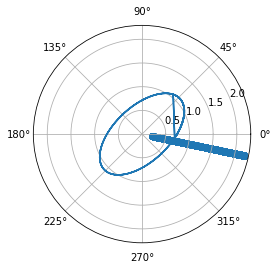

 31%|███       | 306/1000 [01:47<04:00,  2.88it/s]

1.464977297045361


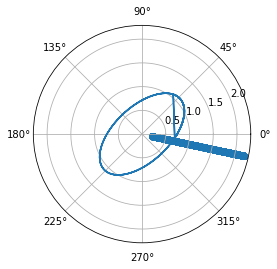

 31%|███       | 307/1000 [01:48<04:00,  2.88it/s]

1.4630683604251606


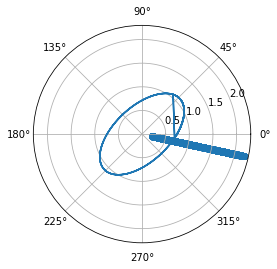

 31%|███       | 308/1000 [01:48<03:52,  2.98it/s]

1.461163115315649


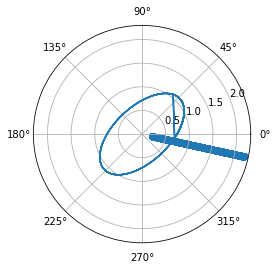

 31%|███       | 309/1000 [01:48<03:47,  3.04it/s]

1.4592615315932238


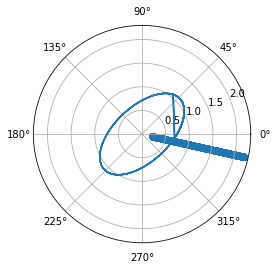

 31%|███       | 310/1000 [01:49<03:55,  2.93it/s]

1.4573636037017832


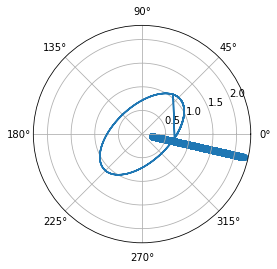

 31%|███       | 311/1000 [01:49<03:48,  3.02it/s]

1.4554692885657636


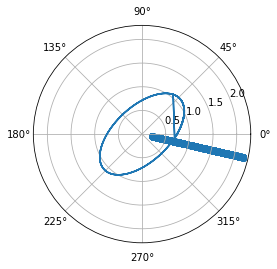

 31%|███       | 312/1000 [01:49<03:51,  2.97it/s]

1.4535786019440498


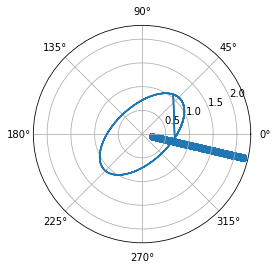

 31%|███▏      | 313/1000 [01:50<03:46,  3.03it/s]

1.4516914909583754


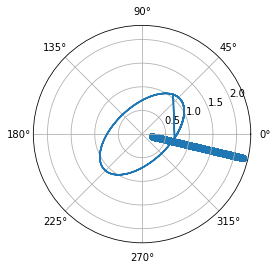

 31%|███▏      | 314/1000 [01:50<03:49,  2.99it/s]

1.4498079458182596


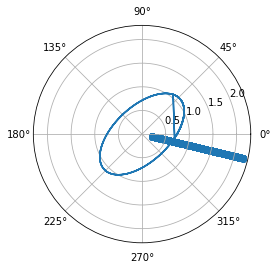

 32%|███▏      | 315/1000 [01:50<04:02,  2.82it/s]

1.4479279607572786


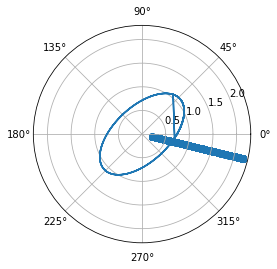

 32%|███▏      | 316/1000 [01:51<04:09,  2.75it/s]

1.4460514958978143


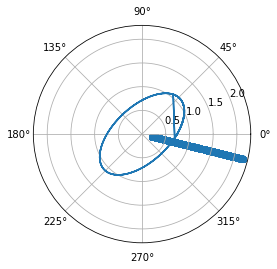

 32%|███▏      | 317/1000 [01:51<04:16,  2.66it/s]

1.444178533019856


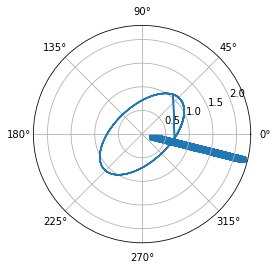

 32%|███▏      | 318/1000 [01:51<04:13,  2.69it/s]

1.4423090690600893


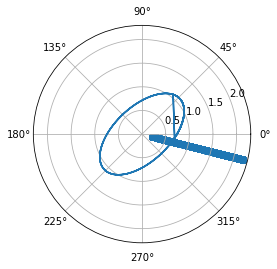

 32%|███▏      | 319/1000 [01:52<03:58,  2.86it/s]

1.4404430734019638


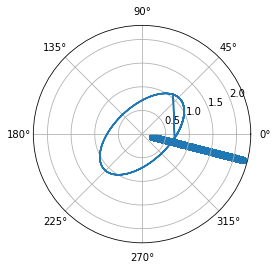

 32%|███▏      | 320/1000 [01:52<03:56,  2.88it/s]

1.438580521645133


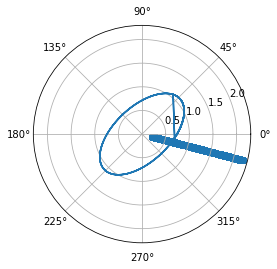

 32%|███▏      | 321/1000 [01:53<04:11,  2.70it/s]

1.4367213947236186


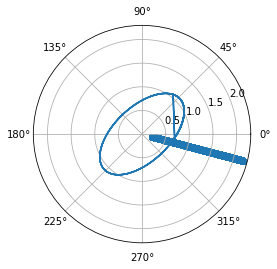

 32%|███▏      | 322/1000 [01:53<03:55,  2.87it/s]

1.4348656733705853


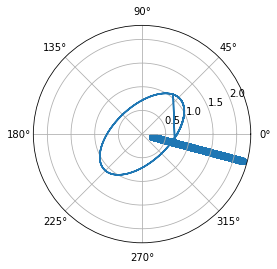

 32%|███▏      | 323/1000 [01:53<03:48,  2.96it/s]

1.4330133381224406


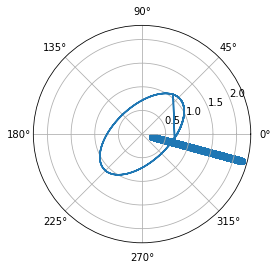

 32%|███▏      | 324/1000 [01:53<03:47,  2.97it/s]

1.4311643748095


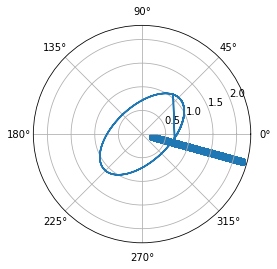

 32%|███▎      | 325/1000 [01:54<03:41,  3.05it/s]

1.4293187584800466


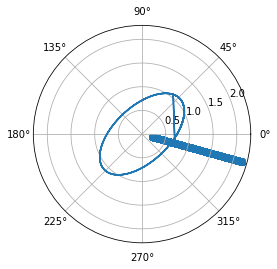

 33%|███▎      | 326/1000 [01:54<03:31,  3.18it/s]

1.4274764666158628


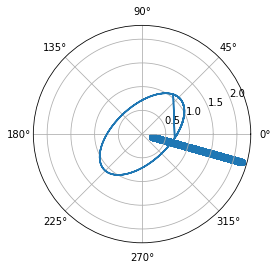

 33%|███▎      | 327/1000 [01:54<03:28,  3.24it/s]

1.4256374790143787


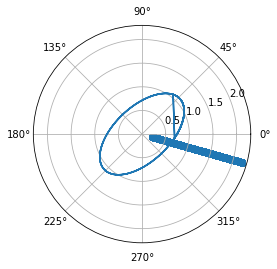

 33%|███▎      | 328/1000 [01:55<03:31,  3.18it/s]

1.423801775298746


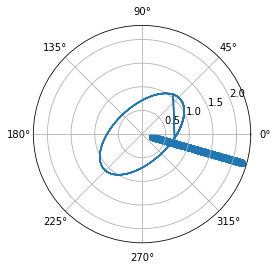

 33%|███▎      | 329/1000 [01:55<03:27,  3.24it/s]

1.4219693349223799


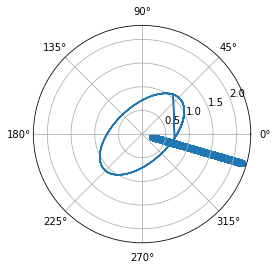

 33%|███▎      | 330/1000 [01:55<03:21,  3.33it/s]

1.4201401371735731


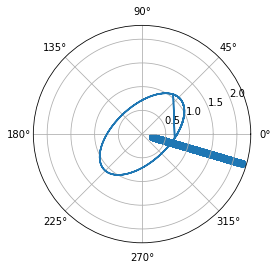

 33%|███▎      | 331/1000 [01:56<03:21,  3.32it/s]

1.4183141611801844


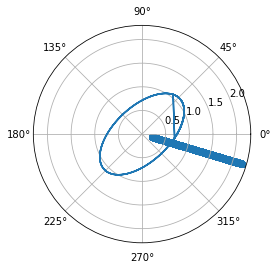

 33%|███▎      | 332/1000 [01:56<03:24,  3.26it/s]

1.416491392213176


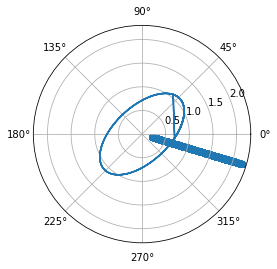

 33%|███▎      | 333/1000 [01:56<03:33,  3.12it/s]

1.414671807304535


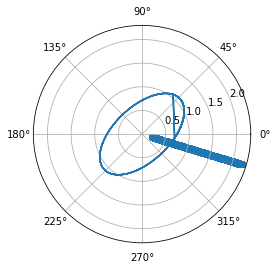

 33%|███▎      | 334/1000 [01:57<03:29,  3.17it/s]

1.4128553826595789


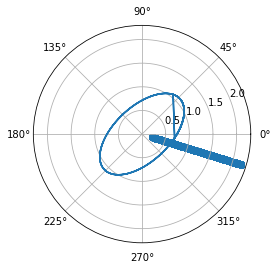

 34%|███▎      | 335/1000 [01:57<03:22,  3.29it/s]

1.4110420967995376


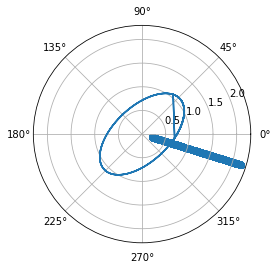

 34%|███▎      | 336/1000 [01:57<03:23,  3.26it/s]

1.4092319281087324


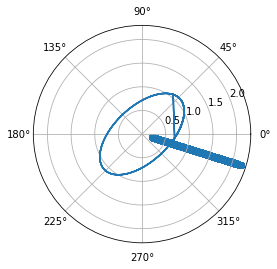

 34%|███▎      | 337/1000 [01:57<03:20,  3.30it/s]

1.4074248548396886


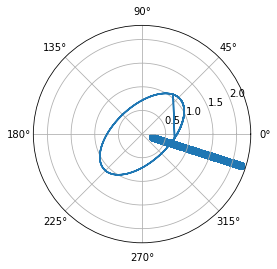

 34%|███▍      | 338/1000 [01:58<03:14,  3.40it/s]

1.405620864536054


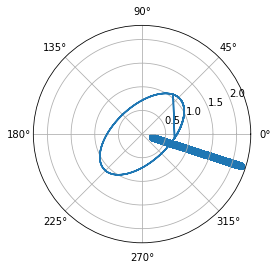

 34%|███▍      | 339/1000 [01:58<03:11,  3.45it/s]

1.4038199391539399


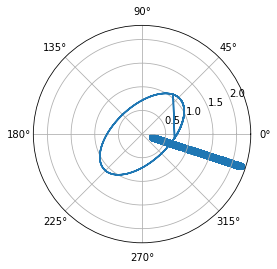

 34%|███▍      | 340/1000 [01:58<03:17,  3.34it/s]

1.4020220451666754


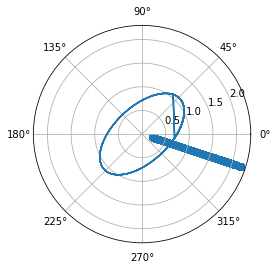

 34%|███▍      | 341/1000 [01:59<03:16,  3.35it/s]

1.4002271603329846


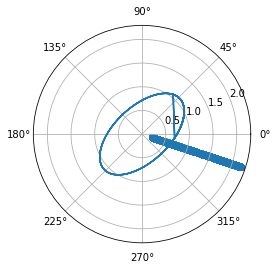

 34%|███▍      | 342/1000 [01:59<03:13,  3.41it/s]

1.3984352823282


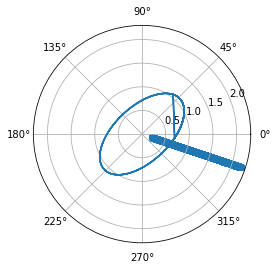

 34%|███▍      | 343/1000 [01:59<03:15,  3.36it/s]

1.396646379139209


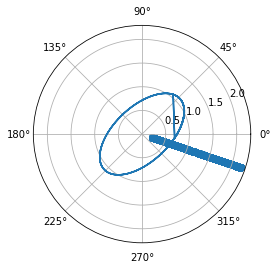

 34%|███▍      | 344/1000 [02:00<03:20,  3.27it/s]

1.3948604196457444


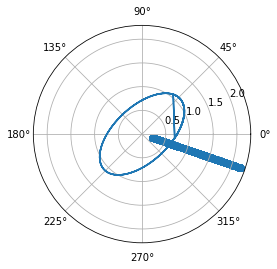

 34%|███▍      | 345/1000 [02:00<03:18,  3.30it/s]

1.3930774060503115


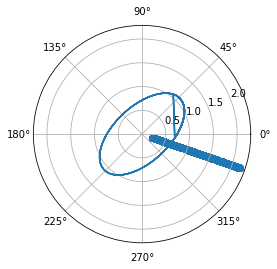

 35%|███▍      | 346/1000 [02:00<03:14,  3.35it/s]

1.3912973019722803


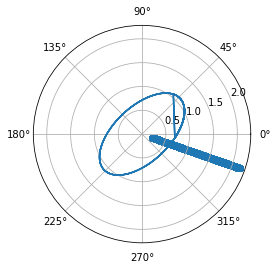

 35%|███▍      | 347/1000 [02:00<03:12,  3.40it/s]

1.3895200817949167


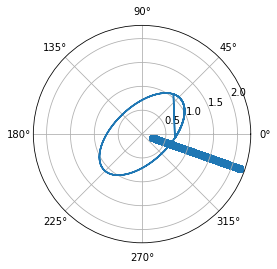

 35%|███▍      | 348/1000 [02:01<03:16,  3.32it/s]

1.3877457491225578


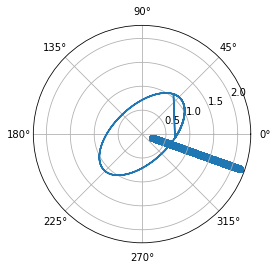

 35%|███▍      | 349/1000 [02:01<03:17,  3.30it/s]

1.3859742496157792


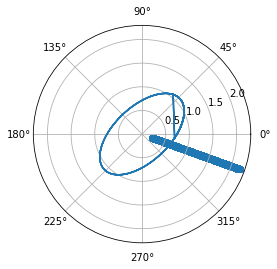

 35%|███▌      | 350/1000 [02:01<03:15,  3.32it/s]

1.3842055991536018


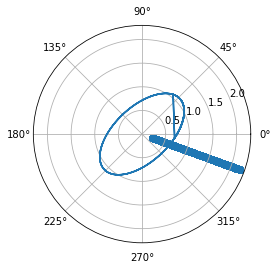

 35%|███▌      | 351/1000 [02:02<03:26,  3.14it/s]

1.3824397417283114


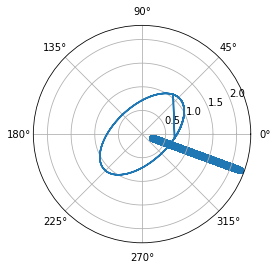

 35%|███▌      | 352/1000 [02:02<03:29,  3.09it/s]

1.3806766884568973


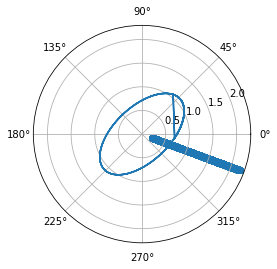

 35%|███▌      | 353/1000 [02:02<03:22,  3.20it/s]

1.378916387192295


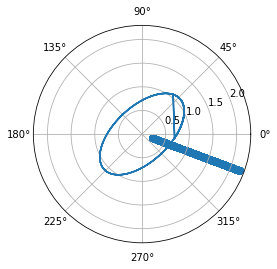

 35%|███▌      | 354/1000 [02:03<03:17,  3.26it/s]

1.3771588518761242


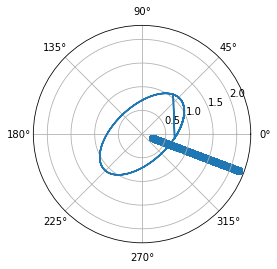

 36%|███▌      | 355/1000 [02:03<03:14,  3.31it/s]

1.3754040255755446


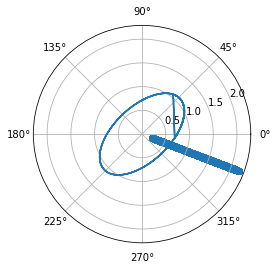

 36%|███▌      | 356/1000 [02:03<03:16,  3.28it/s]

1.373651922827623


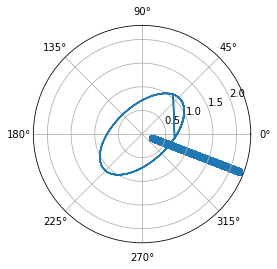

 36%|███▌      | 357/1000 [02:03<03:13,  3.32it/s]

1.3719024959389696


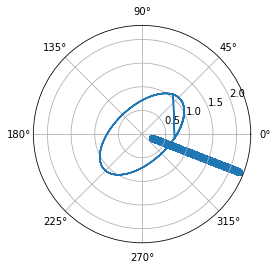

 36%|███▌      | 358/1000 [02:04<03:09,  3.39it/s]

1.3701557334235652


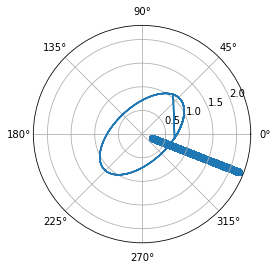

 36%|███▌      | 359/1000 [02:04<03:13,  3.32it/s]

1.3684116248710012


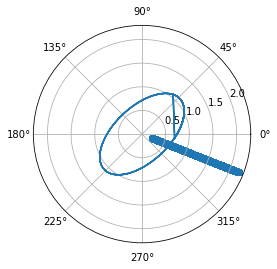

 36%|███▌      | 360/1000 [02:04<03:22,  3.17it/s]

1.366670129155412


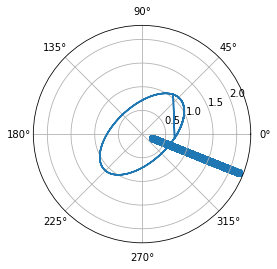

 36%|███▌      | 361/1000 [02:05<03:16,  3.26it/s]

1.3649312426776656


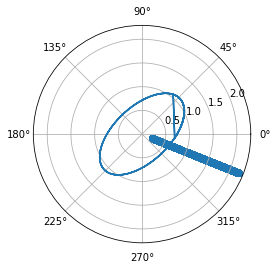

 36%|███▌      | 362/1000 [02:05<03:12,  3.31it/s]

1.3631949441741797


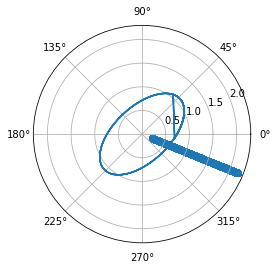

 36%|███▋      | 363/1000 [02:05<03:13,  3.30it/s]

1.3614612000971726


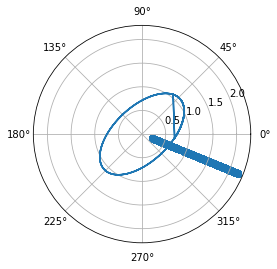

 36%|███▋      | 364/1000 [02:06<03:17,  3.22it/s]

1.3597299948076262


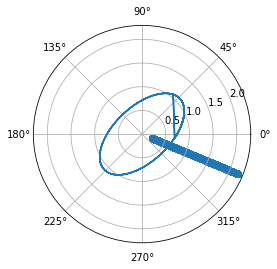

 36%|███▋      | 365/1000 [02:06<03:14,  3.27it/s]

1.358001325490346


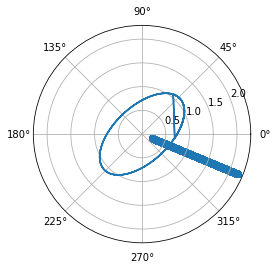

 37%|███▋      | 366/1000 [02:06<03:14,  3.27it/s]

1.3562751514951126


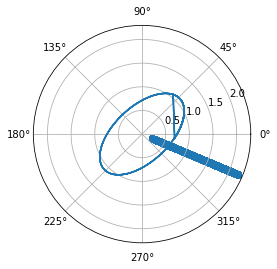

 37%|███▋      | 367/1000 [02:07<03:14,  3.26it/s]

1.3545514535178935


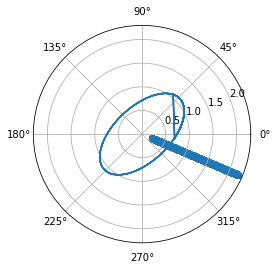

 37%|███▋      | 368/1000 [02:07<03:17,  3.20it/s]

1.3528302121796207


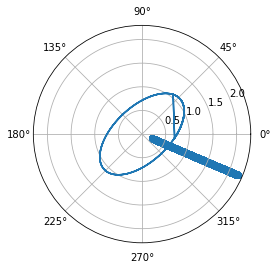

 37%|███▋      | 369/1000 [02:07<03:35,  2.93it/s]

1.3511114210896715


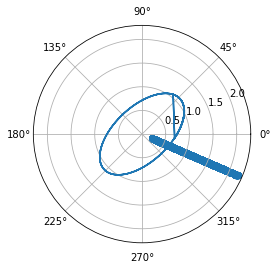

 37%|███▋      | 370/1000 [02:08<03:31,  2.98it/s]

1.3493950499623424


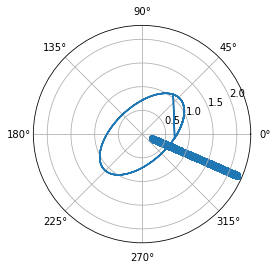

 37%|███▋      | 371/1000 [02:08<03:31,  2.97it/s]

1.3476810753616977


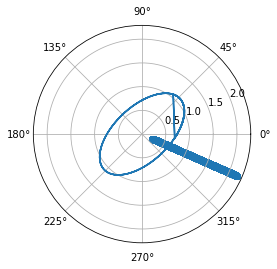

 37%|███▋      | 372/1000 [02:08<03:24,  3.07it/s]

1.3459694776501656


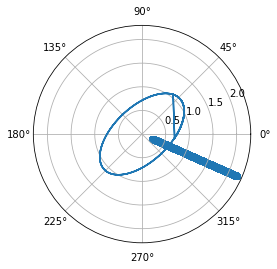

 37%|███▋      | 373/1000 [02:09<03:15,  3.20it/s]

1.3442602371284895


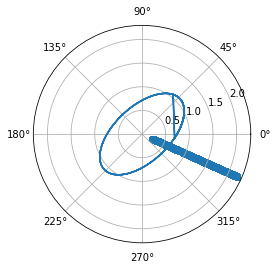

 37%|███▋      | 374/1000 [02:09<03:13,  3.24it/s]

1.3425533340383449


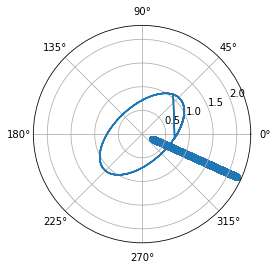

 38%|███▊      | 375/1000 [02:09<03:13,  3.24it/s]

1.340848748564969


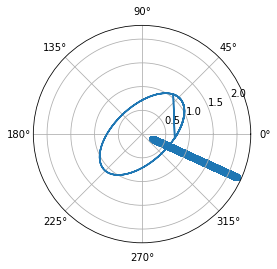

 38%|███▊      | 376/1000 [02:09<03:13,  3.22it/s]

1.3391464608398187


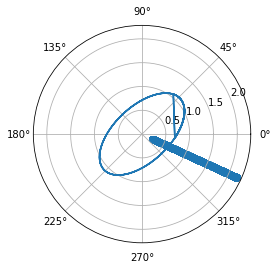

 38%|███▊      | 377/1000 [02:10<03:10,  3.26it/s]

1.3374464558220853


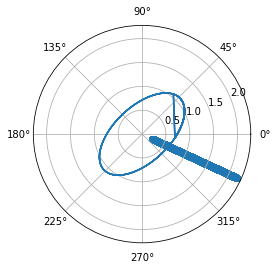

 38%|███▊      | 378/1000 [02:10<03:13,  3.21it/s]

1.3357487074746088


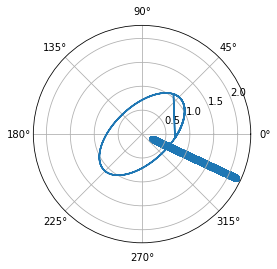

 38%|███▊      | 379/1000 [02:10<03:13,  3.22it/s]

1.3340531955824226


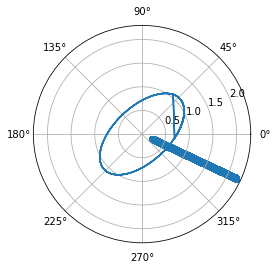

 38%|███▊      | 380/1000 [02:11<03:09,  3.28it/s]

1.332359900110321


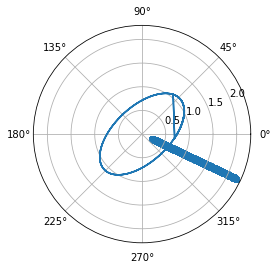

 38%|███▊      | 381/1000 [02:11<03:07,  3.30it/s]

1.3306688009835186


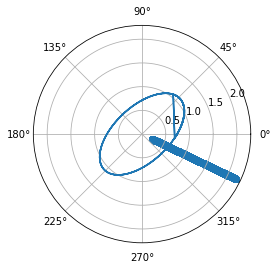

 38%|███▊      | 382/1000 [02:11<03:06,  3.31it/s]

1.3289798780904194


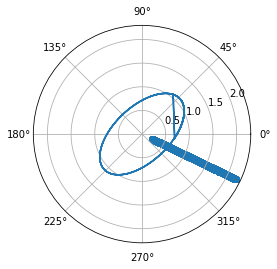

 38%|███▊      | 383/1000 [02:12<03:11,  3.22it/s]

1.3272931112854063


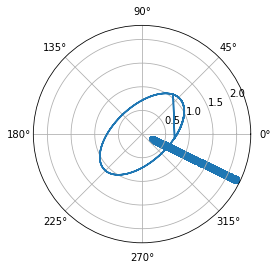

 38%|███▊      | 384/1000 [02:12<03:12,  3.19it/s]

1.3256084803916457


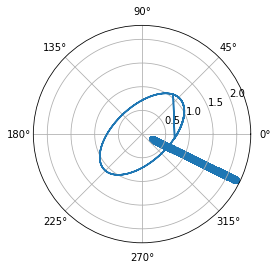

 38%|███▊      | 385/1000 [02:12<03:12,  3.19it/s]

1.3239259685249747


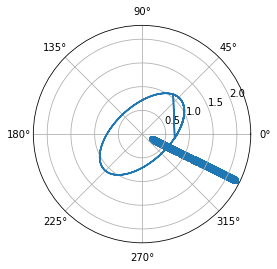

 39%|███▊      | 386/1000 [02:13<03:11,  3.21it/s]

1.3222455556158696


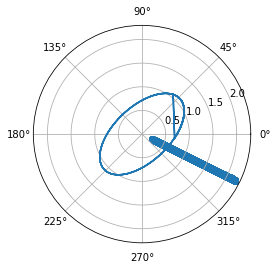

 39%|███▊      | 387/1000 [02:13<03:22,  3.02it/s]

1.320567219129362


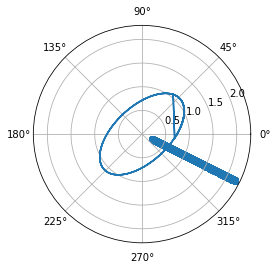

 39%|███▉      | 388/1000 [02:13<03:21,  3.03it/s]

1.3188909387653327


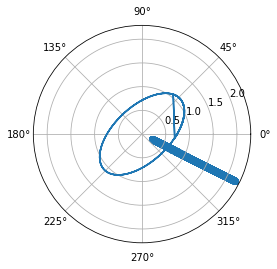

 39%|███▉      | 389/1000 [02:14<03:20,  3.05it/s]

1.317216694206046


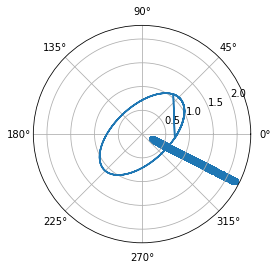

 39%|███▉      | 390/1000 [02:14<03:19,  3.05it/s]

1.3155444651190444


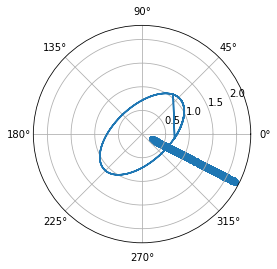

 39%|███▉      | 391/1000 [02:14<03:15,  3.11it/s]

1.3138742311600617


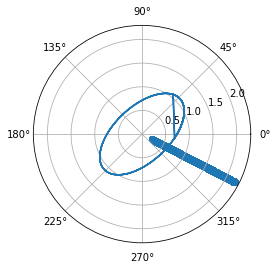

 39%|███▉      | 392/1000 [02:15<03:13,  3.14it/s]

1.3122059719759507


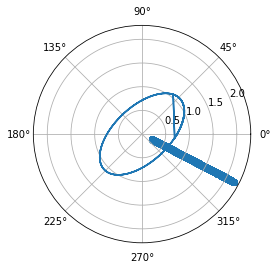

 39%|███▉      | 393/1000 [02:15<03:11,  3.17it/s]

1.3105396735358956


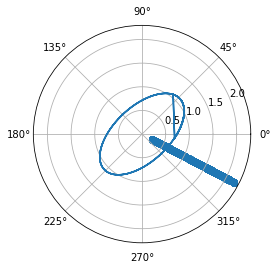

 39%|███▉      | 394/1000 [02:15<03:12,  3.16it/s]

1.308875318861936


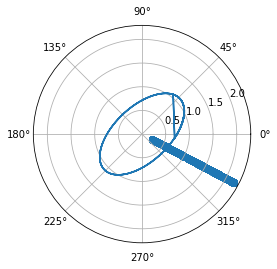

 40%|███▉      | 395/1000 [02:15<03:10,  3.18it/s]

1.3072128788596922


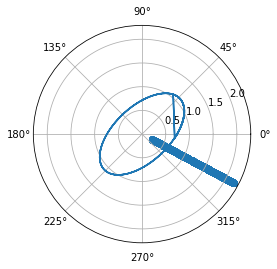

 40%|███▉      | 396/1000 [02:16<03:06,  3.23it/s]

1.305552333137922


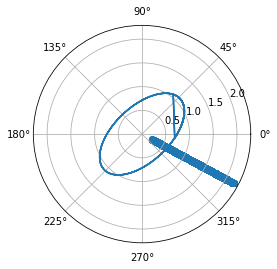

 40%|███▉      | 397/1000 [02:16<03:02,  3.31it/s]

1.3038936613106342


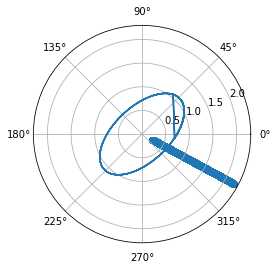

 40%|███▉      | 398/1000 [02:16<03:08,  3.19it/s]

1.3022368575098267


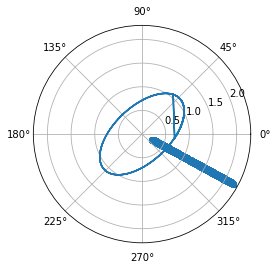

 40%|███▉      | 399/1000 [02:17<03:09,  3.18it/s]

1.3005818934423785


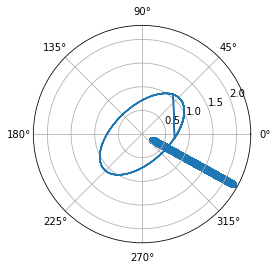

 40%|████      | 400/1000 [02:17<03:04,  3.24it/s]

1.2989287429991037


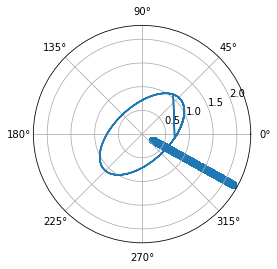

 40%|████      | 401/1000 [02:17<03:02,  3.28it/s]

1.2972773858096946


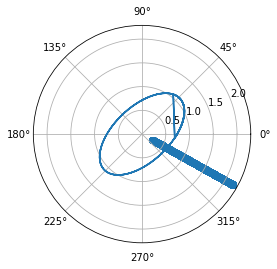

 40%|████      | 402/1000 [02:18<03:05,  3.22it/s]

1.2956278254796836


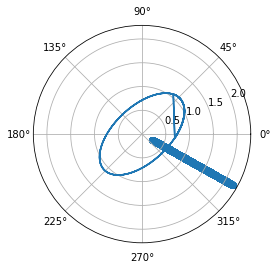

 40%|████      | 403/1000 [02:18<03:06,  3.20it/s]

1.2939800184805148


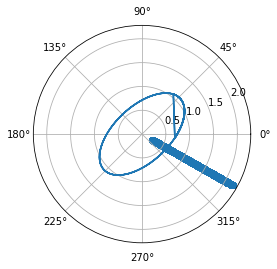

 40%|████      | 404/1000 [02:18<03:03,  3.25it/s]

1.29233394444861


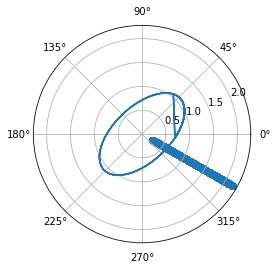

 40%|████      | 405/1000 [02:19<03:17,  3.01it/s]

1.2906896048506928


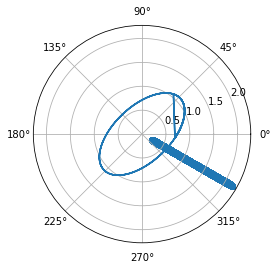

 41%|████      | 406/1000 [02:19<03:18,  3.00it/s]

1.2890469630976806


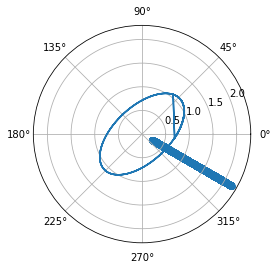

 41%|████      | 407/1000 [02:19<03:16,  3.02it/s]

1.2874059940664369


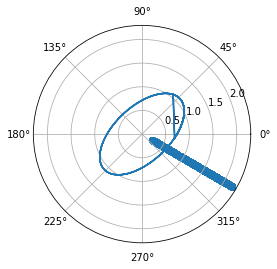

 41%|████      | 408/1000 [02:20<03:15,  3.03it/s]

1.2857667058940552


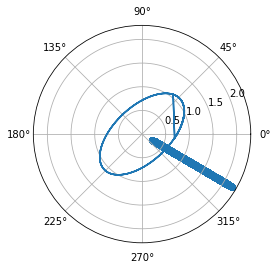

 41%|████      | 409/1000 [02:20<03:19,  2.96it/s]

1.2841290511111663


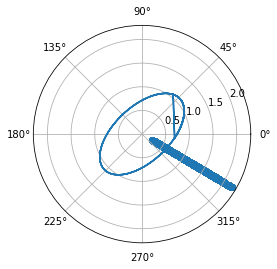

 41%|████      | 410/1000 [02:20<03:26,  2.86it/s]

1.2824930208930165


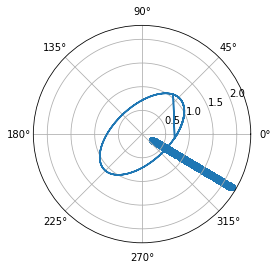

 41%|████      | 411/1000 [02:21<03:27,  2.84it/s]

1.2808586021856203


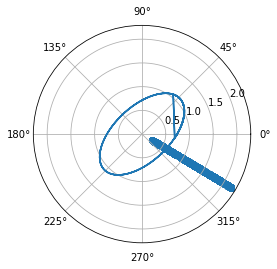

 41%|████      | 412/1000 [02:21<03:25,  2.86it/s]

1.2792257561998328


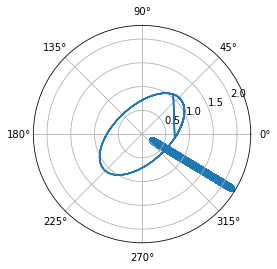

 41%|████▏     | 413/1000 [02:21<03:21,  2.91it/s]

1.277594494984539


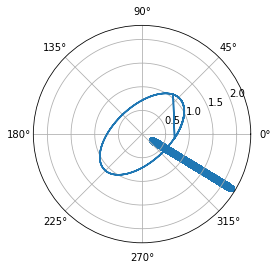

 41%|████▏     | 414/1000 [02:22<03:13,  3.03it/s]

1.2759647670407945


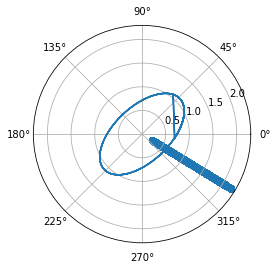

 42%|████▏     | 415/1000 [02:22<03:16,  2.97it/s]

1.274336576972198


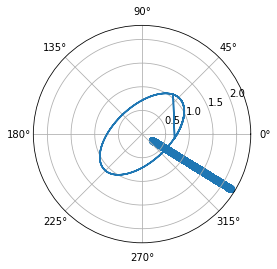

 42%|████▏     | 416/1000 [02:22<03:21,  2.90it/s]

1.2727098888996837


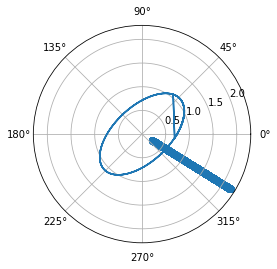

 42%|████▏     | 417/1000 [02:23<03:16,  2.97it/s]

1.2710846954362562


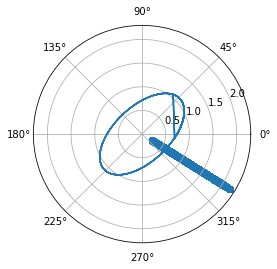

 42%|████▏     | 418/1000 [02:23<03:12,  3.02it/s]

1.2694609690962086


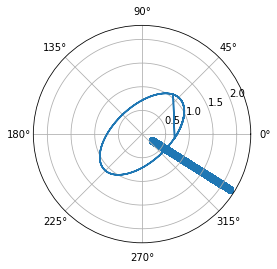

 42%|████▏     | 419/1000 [02:23<03:07,  3.09it/s]

1.267838697541655


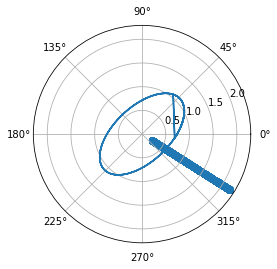

 42%|████▏     | 420/1000 [02:24<03:06,  3.10it/s]

1.2662178548578196


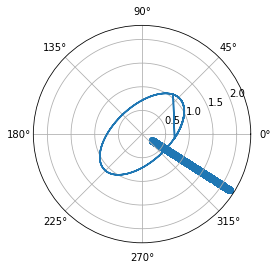

 42%|████▏     | 421/1000 [02:24<03:00,  3.20it/s]

1.2645984303845184


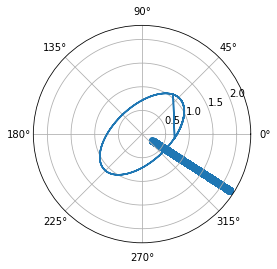

 42%|████▏     | 422/1000 [02:24<02:57,  3.26it/s]

1.2629803933735906


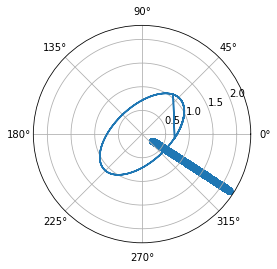

 42%|████▏     | 423/1000 [02:25<03:09,  3.04it/s]

1.2613637410460226


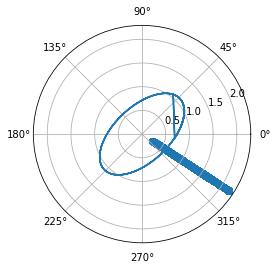

 42%|████▏     | 424/1000 [02:25<03:09,  3.04it/s]

1.2597484318480436


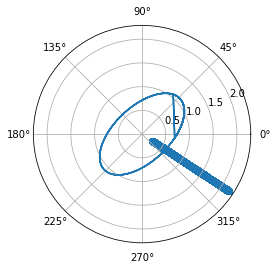

 42%|████▎     | 425/1000 [02:25<03:04,  3.11it/s]

1.258134476646173


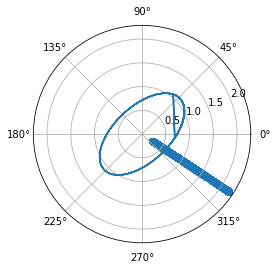

 43%|████▎     | 426/1000 [02:26<02:59,  3.20it/s]

1.2565218278540846


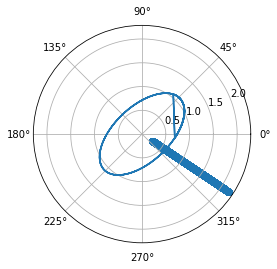

 43%|████▎     | 427/1000 [02:26<02:58,  3.21it/s]

1.2549104843974557


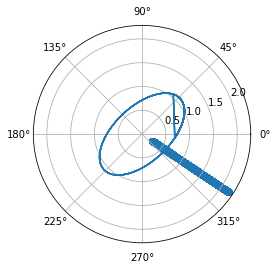

 43%|████▎     | 428/1000 [02:26<03:01,  3.15it/s]

1.253300421014325


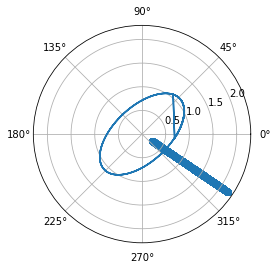

 43%|████▎     | 429/1000 [02:26<03:00,  3.16it/s]

1.2516916116582997


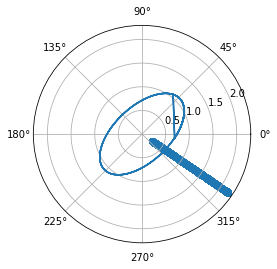

 43%|████▎     | 430/1000 [02:27<03:10,  3.00it/s]

1.2500840585066413


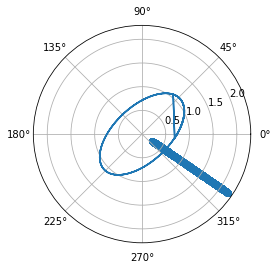

 43%|████▎     | 431/1000 [02:27<03:10,  2.99it/s]

1.2484777206279305


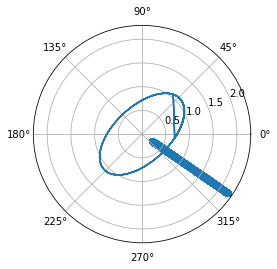

 43%|████▎     | 432/1000 [02:27<03:04,  3.09it/s]

1.2468725878838522


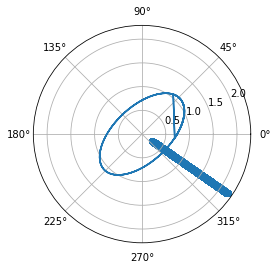

 43%|████▎     | 433/1000 [02:28<03:06,  3.03it/s]

1.2452686482720834


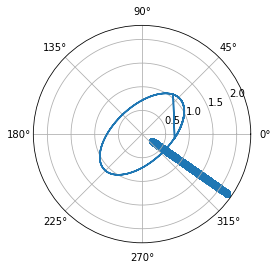

 43%|████▎     | 434/1000 [02:28<03:11,  2.96it/s]

1.243665869277151


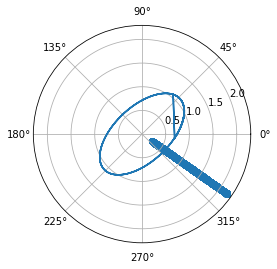

 44%|████▎     | 435/1000 [02:29<03:13,  2.92it/s]

1.2420642404308992


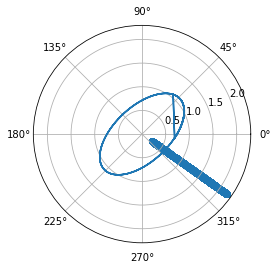

 44%|████▎     | 436/1000 [02:29<03:06,  3.03it/s]

1.2404637476545464


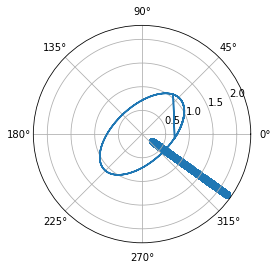

 44%|████▎     | 437/1000 [02:29<03:02,  3.08it/s]

1.23886436071342


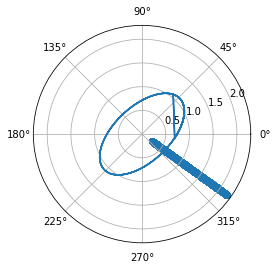

 44%|████▍     | 438/1000 [02:30<03:09,  2.97it/s]

1.2372660635856023


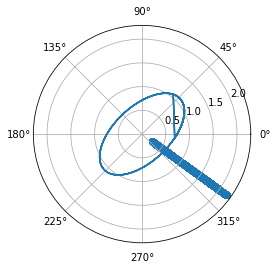

 44%|████▍     | 439/1000 [02:30<03:09,  2.96it/s]

1.2356688507978348


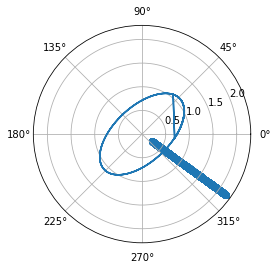

 44%|████▍     | 440/1000 [02:30<03:05,  3.02it/s]

1.2340726889671345


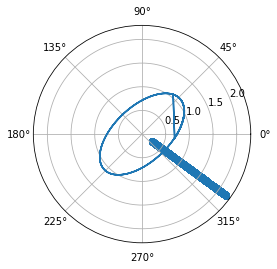

 44%|████▍     | 441/1000 [02:31<03:12,  2.91it/s]

1.232477560093217


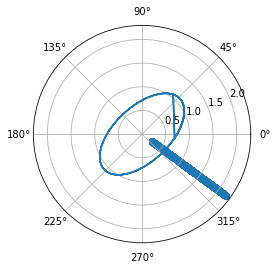

 44%|████▍     | 442/1000 [02:31<03:12,  2.90it/s]

1.230883452343766


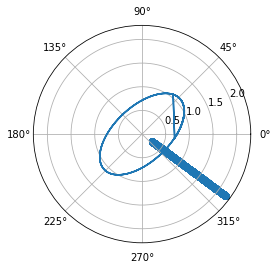

 44%|████▍     | 443/1000 [02:31<03:01,  3.08it/s]

1.2292903486613407


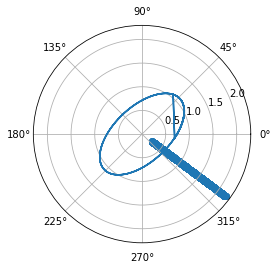

 44%|████▍     | 444/1000 [02:31<02:55,  3.17it/s]

1.2276982229519173


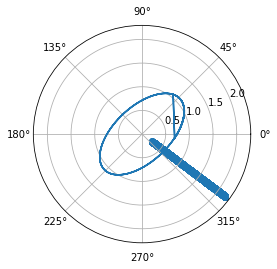

 44%|████▍     | 445/1000 [02:32<02:50,  3.25it/s]

1.2261070571608252


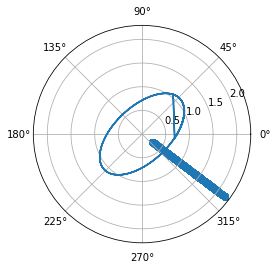

 45%|████▍     | 446/1000 [02:32<02:53,  3.19it/s]

1.2245168353206932


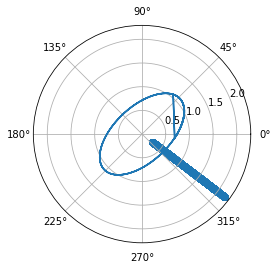

 45%|████▍     | 447/1000 [02:32<02:53,  3.19it/s]

1.2229275458564128


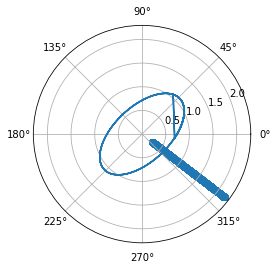

 45%|████▍     | 448/1000 [02:33<02:53,  3.18it/s]

1.2213391612684223


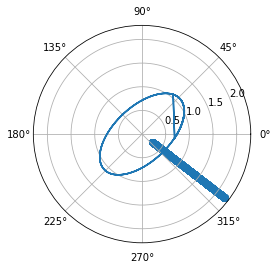

 45%|████▍     | 449/1000 [02:33<02:51,  3.22it/s]

1.2197516634618313


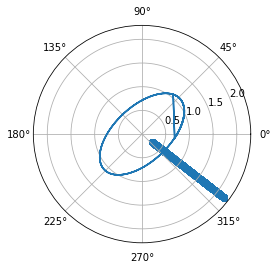

 45%|████▌     | 450/1000 [02:33<03:00,  3.04it/s]

1.2181650343289725


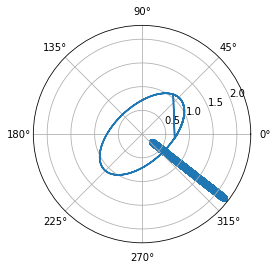

 45%|████▌     | 451/1000 [02:34<02:54,  3.15it/s]

1.21657925575014


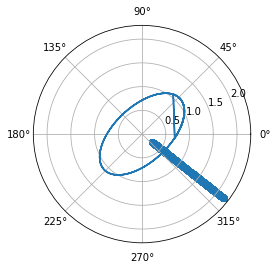

 45%|████▌     | 452/1000 [02:34<02:49,  3.23it/s]

1.2149943172422295


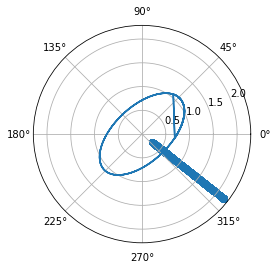

 45%|████▌     | 453/1000 [02:34<03:22,  2.70it/s]

1.2134101924679632


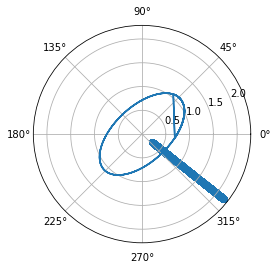

 45%|████▌     | 454/1000 [02:35<03:17,  2.76it/s]

1.211826863168482


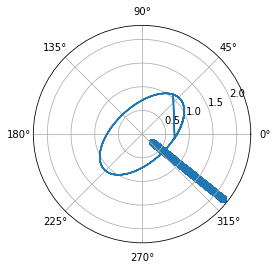

 46%|████▌     | 455/1000 [02:35<03:15,  2.79it/s]

1.2102443112038321


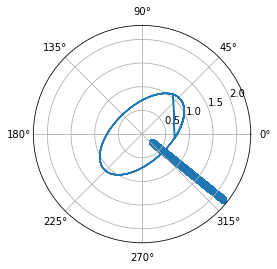

 46%|████▌     | 456/1000 [02:35<03:06,  2.91it/s]

1.208662518425825


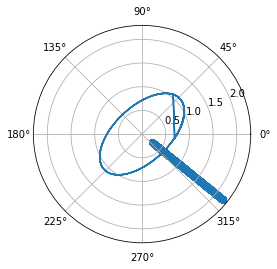

 46%|████▌     | 457/1000 [02:36<03:02,  2.97it/s]

1.2070814666787357


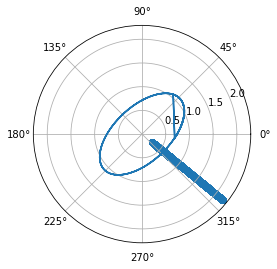

 46%|████▌     | 458/1000 [02:36<02:55,  3.09it/s]

1.2055011377999891


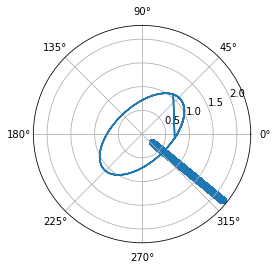

 46%|████▌     | 459/1000 [02:36<03:01,  2.98it/s]

1.203921516859501


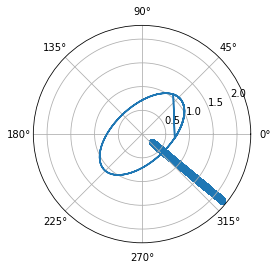

 46%|████▌     | 460/1000 [02:37<03:07,  2.89it/s]

1.20234258304108


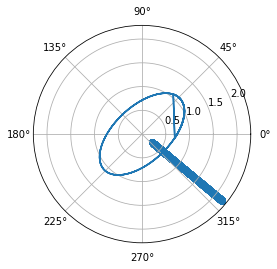

 46%|████▌     | 461/1000 [02:37<02:58,  3.02it/s]

1.2007643170740037


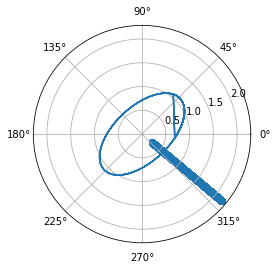

 46%|████▌     | 462/1000 [02:37<02:47,  3.20it/s]

1.1991867007971875


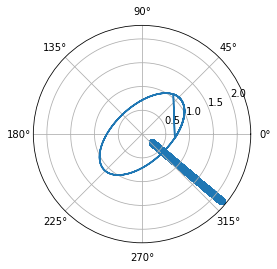

 46%|████▋     | 463/1000 [02:38<02:43,  3.28it/s]

1.1976097160462247


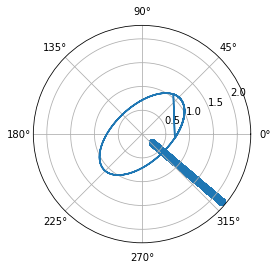

 46%|████▋     | 464/1000 [02:38<02:43,  3.28it/s]

1.1960333446540239


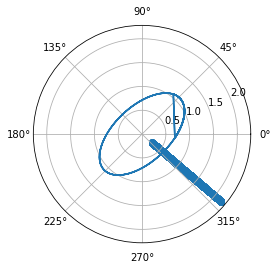

 46%|████▋     | 465/1000 [02:38<02:43,  3.27it/s]

1.1944575684514394


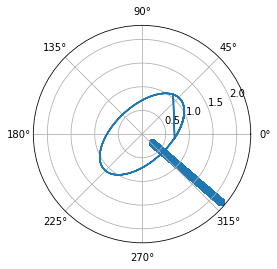

 47%|████▋     | 466/1000 [02:39<02:41,  3.31it/s]

1.192882369267893


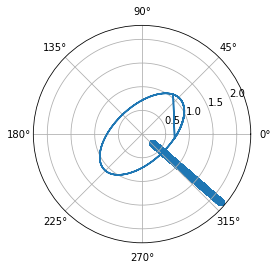

 47%|████▋     | 467/1000 [02:39<02:43,  3.26it/s]

1.191307728931987


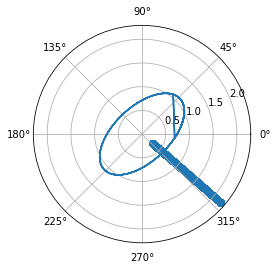

 47%|████▋     | 468/1000 [02:39<02:44,  3.23it/s]

1.1897336292721077


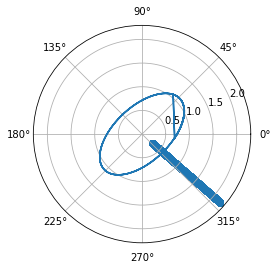

 47%|████▋     | 469/1000 [02:40<02:45,  3.21it/s]

1.188160052117018


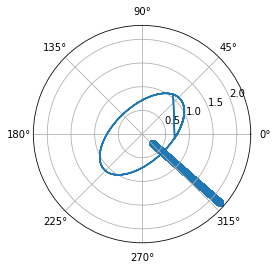

 47%|████▋     | 470/1000 [02:40<02:39,  3.31it/s]

1.1865869792964427


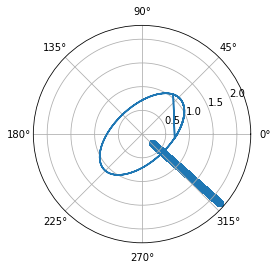

 47%|████▋     | 471/1000 [02:40<02:43,  3.23it/s]

1.1850143926416439


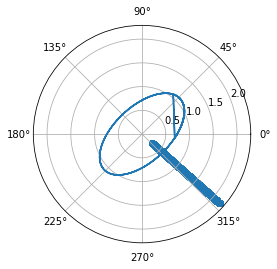

 47%|████▋     | 472/1000 [02:40<02:48,  3.13it/s]

1.183442273985983


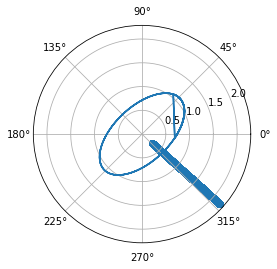

 47%|████▋     | 473/1000 [02:41<02:56,  2.99it/s]

1.1818706051654773


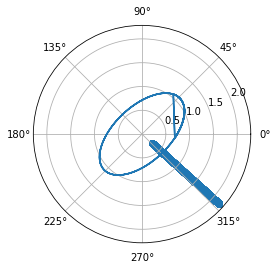

 47%|████▋     | 474/1000 [02:41<02:48,  3.12it/s]

1.1802993680193432


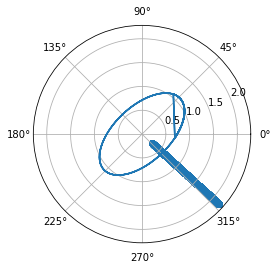

 48%|████▊     | 475/1000 [02:41<02:41,  3.25it/s]

1.1787285443905284


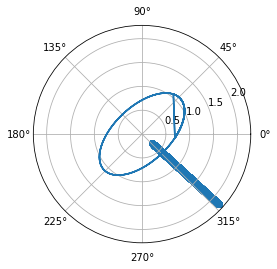

 48%|████▊     | 476/1000 [02:42<02:52,  3.04it/s]

1.1771581161262363


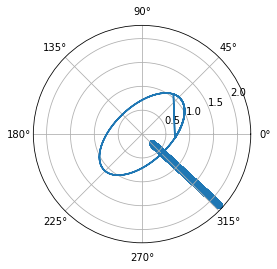

 48%|████▊     | 477/1000 [02:42<02:55,  2.98it/s]

1.175588065078436


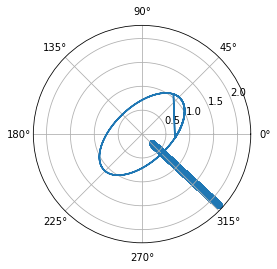

 48%|████▊     | 478/1000 [02:42<02:49,  3.08it/s]

1.1740183731043636


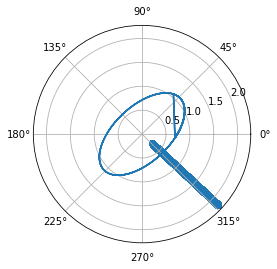

 48%|████▊     | 479/1000 [02:43<03:01,  2.87it/s]

1.1724490220670114


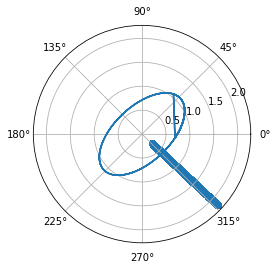

 48%|████▊     | 480/1000 [02:43<03:02,  2.85it/s]

1.1708799938356047


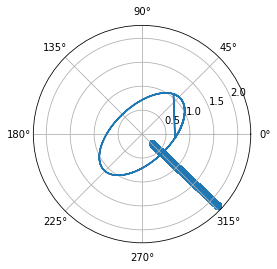

 48%|████▊     | 481/1000 [02:44<02:55,  2.96it/s]

1.1693112702860693


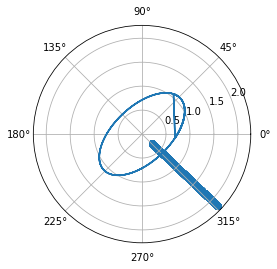

 48%|████▊     | 482/1000 [02:44<02:49,  3.05it/s]

1.1677428333014834


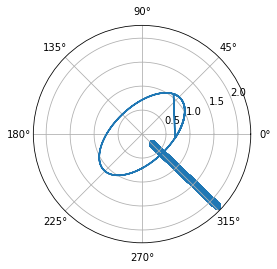

 48%|████▊     | 483/1000 [02:44<02:50,  3.04it/s]

1.1661746647725217


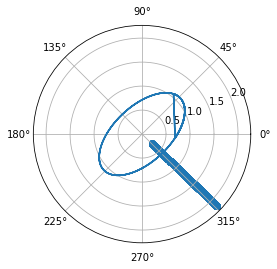

 48%|████▊     | 484/1000 [02:44<02:46,  3.10it/s]

1.164606746597884


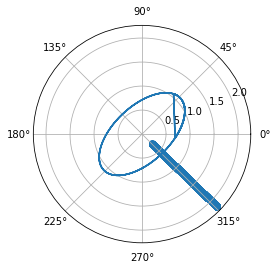

 48%|████▊     | 485/1000 [02:45<02:44,  3.13it/s]

1.163039060684713


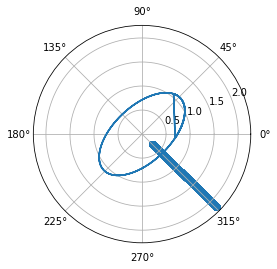

 49%|████▊     | 486/1000 [02:45<02:50,  3.02it/s]

1.161471588948999


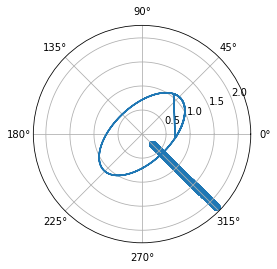

 49%|████▊     | 487/1000 [02:45<02:53,  2.95it/s]

1.1599043135105236


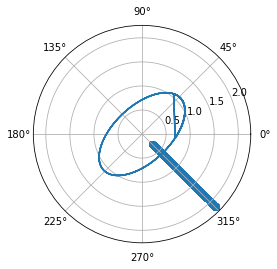

 49%|████▉     | 488/1000 [02:46<02:57,  2.89it/s]

1.1583372169858677


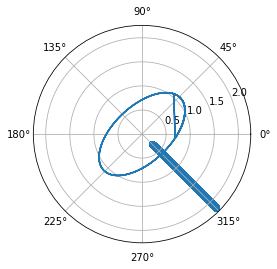

 49%|████▉     | 489/1000 [02:46<02:48,  3.03it/s]

1.1567702802541473


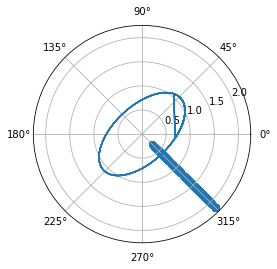

 49%|████▉     | 490/1000 [02:47<02:53,  2.95it/s]

1.1552034852440611


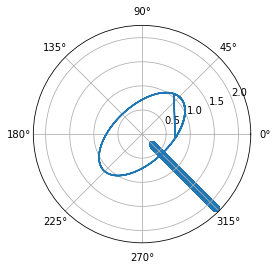

 49%|████▉     | 491/1000 [02:47<02:49,  3.00it/s]

1.1536368138948825


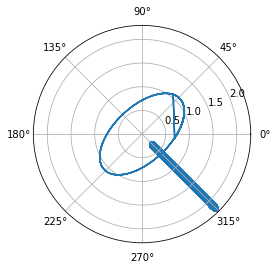

 49%|████▉     | 492/1000 [02:47<02:45,  3.07it/s]

1.152070248156787


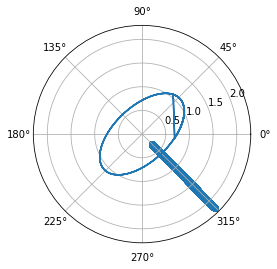

 49%|████▉     | 493/1000 [02:47<02:42,  3.13it/s]

1.150503769991172


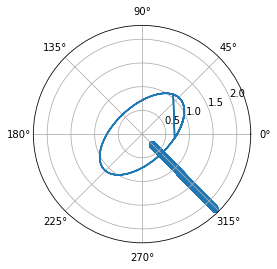

 49%|████▉     | 494/1000 [02:48<02:41,  3.12it/s]

1.1489373613709557


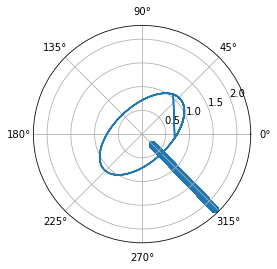

 50%|████▉     | 495/1000 [02:48<02:51,  2.94it/s]

1.1473710043244612


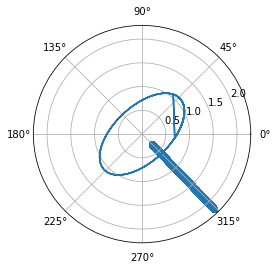

 50%|████▉     | 496/1000 [02:49<02:58,  2.83it/s]

1.145804680886278


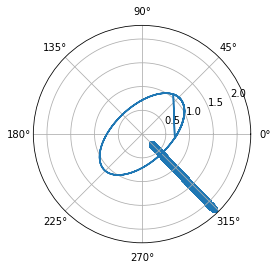

 50%|████▉     | 497/1000 [02:49<02:49,  2.97it/s]

1.1442383725930798


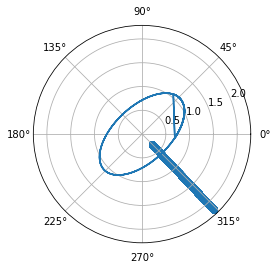

 50%|████▉     | 498/1000 [02:49<02:44,  3.06it/s]

1.1426720614394517


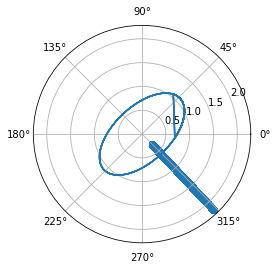

 50%|████▉     | 499/1000 [02:49<02:37,  3.18it/s]

1.1411057294327294


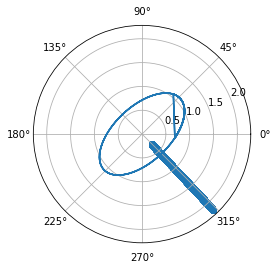

 50%|█████     | 500/1000 [02:50<02:33,  3.25it/s]

1.1395393585932205


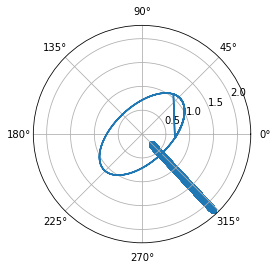

 50%|█████     | 501/1000 [02:50<02:36,  3.18it/s]

1.1379729308439943


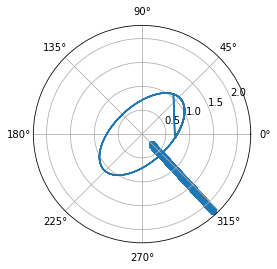

 50%|█████     | 502/1000 [02:50<02:36,  3.17it/s]

1.1364064272108003


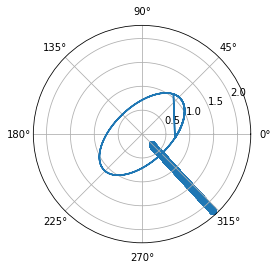

 50%|█████     | 503/1000 [02:51<02:43,  3.04it/s]

1.1348398303433465


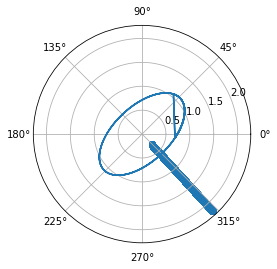

 50%|█████     | 504/1000 [02:51<02:35,  3.20it/s]

1.1332731222882237


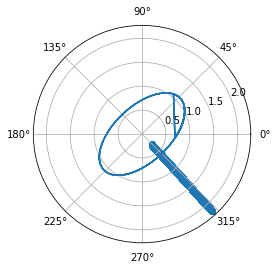

 50%|█████     | 505/1000 [02:51<02:33,  3.23it/s]

1.1317062851058293


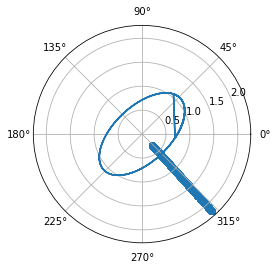

 51%|█████     | 506/1000 [02:52<02:30,  3.29it/s]

1.130139300751353


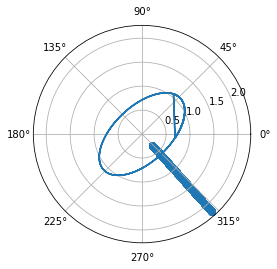

 51%|█████     | 507/1000 [02:52<02:26,  3.37it/s]

1.1285721487714495


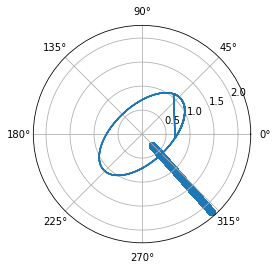

 51%|█████     | 508/1000 [02:52<02:24,  3.42it/s]

1.1270048132623276


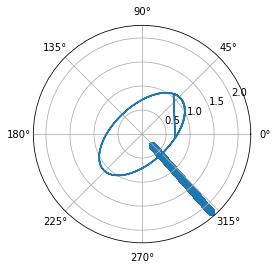

 51%|█████     | 509/1000 [02:52<02:25,  3.37it/s]

1.1254372763131146


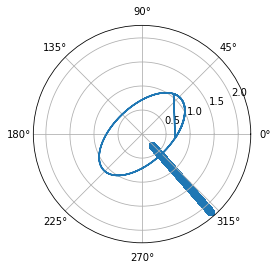

 51%|█████     | 510/1000 [02:53<02:26,  3.33it/s]

1.1238695200272402


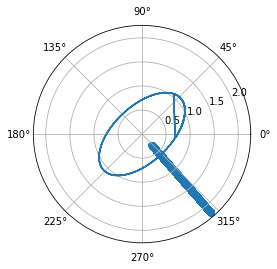

 51%|█████     | 511/1000 [02:53<02:33,  3.18it/s]

1.122301524120737


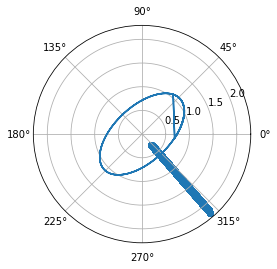

 51%|█████     | 512/1000 [02:53<02:35,  3.14it/s]

1.1207332706445512


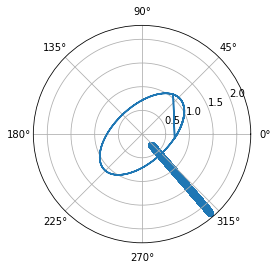

 51%|█████▏    | 513/1000 [02:54<03:01,  2.69it/s]

1.1191647434354361


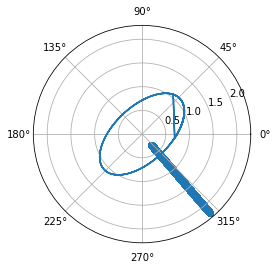

 51%|█████▏    | 514/1000 [02:54<02:49,  2.87it/s]

1.1175959246267266


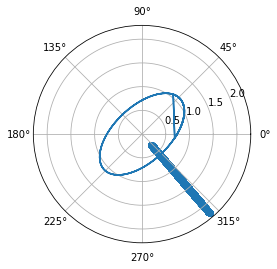

 52%|█████▏    | 515/1000 [02:55<02:38,  3.06it/s]

1.1160267935151214


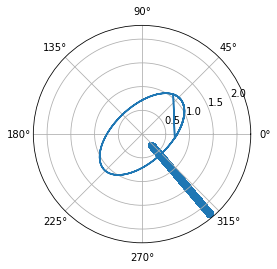

 52%|█████▏    | 516/1000 [02:55<02:33,  3.16it/s]

1.1144573312978352


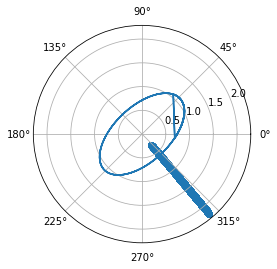

 52%|█████▏    | 517/1000 [02:55<02:33,  3.14it/s]

1.112887523076642


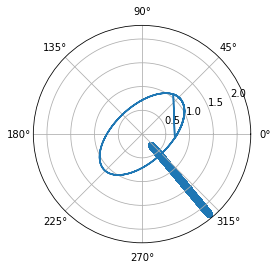

 52%|█████▏    | 518/1000 [02:55<02:30,  3.20it/s]

1.1113173510147891


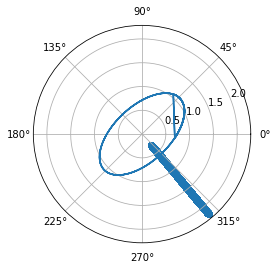

 52%|█████▏    | 519/1000 [02:56<02:30,  3.20it/s]

1.1097467918339945


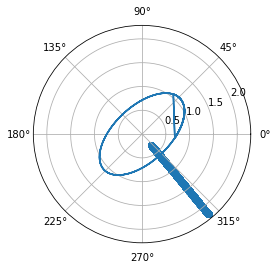

 52%|█████▏    | 520/1000 [02:56<02:41,  2.98it/s]

1.1081758298433528


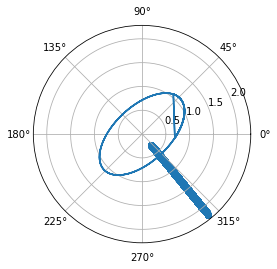

 52%|█████▏    | 521/1000 [02:56<02:35,  3.08it/s]

1.1066044495985692


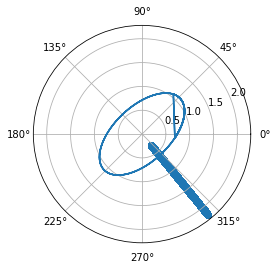

 52%|█████▏    | 522/1000 [02:57<02:29,  3.20it/s]

1.105032632075648


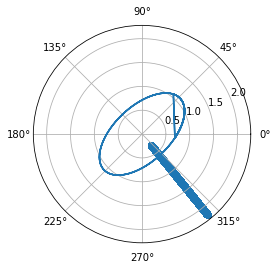

 52%|█████▏    | 523/1000 [02:57<02:25,  3.27it/s]

1.103460351706865


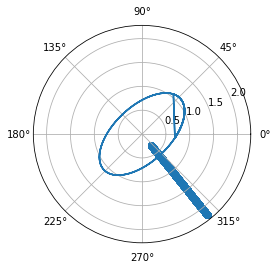

 52%|█████▏    | 524/1000 [02:57<02:35,  3.07it/s]

1.1018875986440397


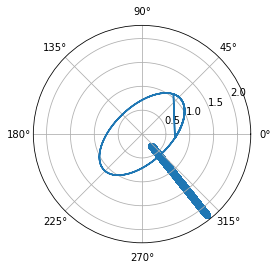

 52%|█████▎    | 525/1000 [02:58<02:30,  3.15it/s]

1.1003143550934318


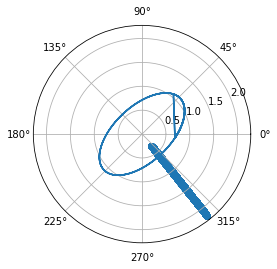

 53%|█████▎    | 526/1000 [02:58<02:26,  3.23it/s]

1.098740594242848


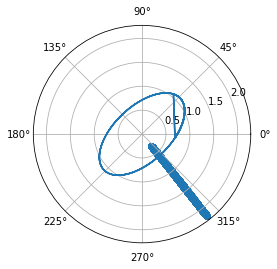

 53%|█████▎    | 527/1000 [02:58<02:22,  3.31it/s]

1.0971663034669143


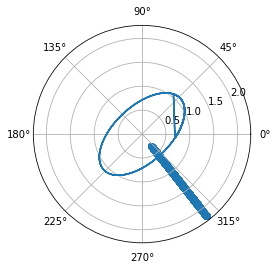

 53%|█████▎    | 528/1000 [02:59<02:31,  3.11it/s]

1.0955914677469492


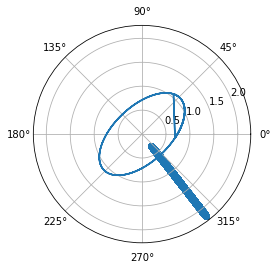

 53%|█████▎    | 529/1000 [02:59<02:28,  3.18it/s]

1.0940160618032264


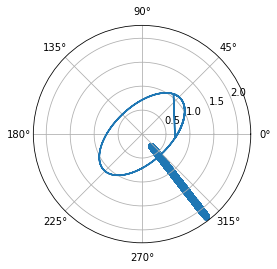

 53%|█████▎    | 530/1000 [02:59<02:26,  3.20it/s]

1.0924400681504158


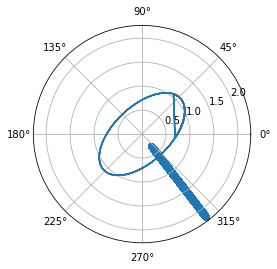

 53%|█████▎    | 531/1000 [03:00<02:29,  3.14it/s]

1.090863475063239


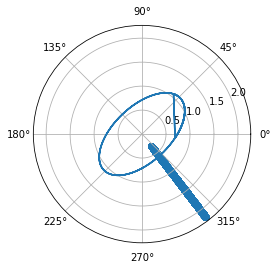

 53%|█████▎    | 532/1000 [03:00<02:30,  3.11it/s]

1.0892862574906204


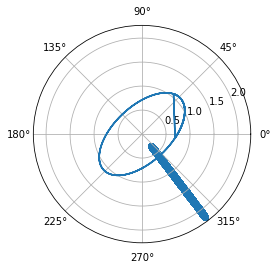

 53%|█████▎    | 533/1000 [03:00<02:24,  3.24it/s]

1.0877083955174205


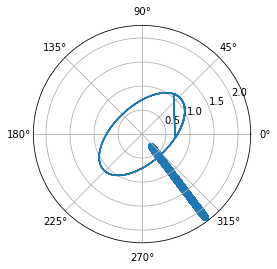

 53%|█████▎    | 534/1000 [03:00<02:20,  3.32it/s]

1.0861298795807537


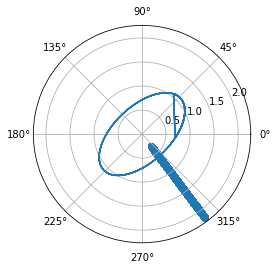

 54%|█████▎    | 535/1000 [03:01<02:18,  3.36it/s]

1.084550683126669


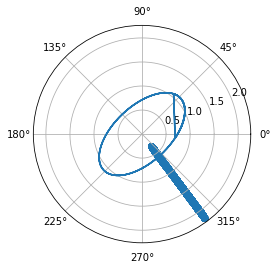

 54%|█████▎    | 536/1000 [03:01<02:24,  3.21it/s]

1.0829707870965035


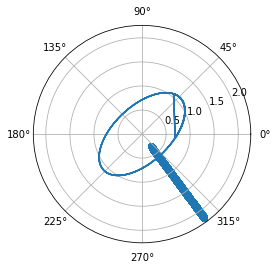

 54%|█████▎    | 537/1000 [03:01<02:33,  3.03it/s]

1.0813901825294743


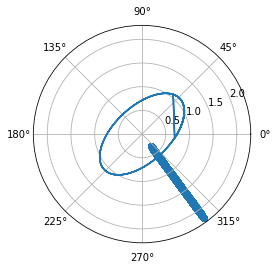

 54%|█████▍    | 538/1000 [03:02<02:33,  3.01it/s]

1.0798088392142986


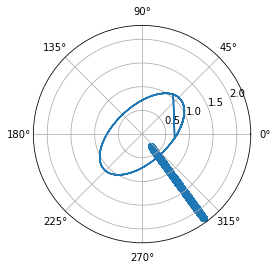

 54%|█████▍    | 539/1000 [03:02<02:38,  2.91it/s]

1.078226743081953


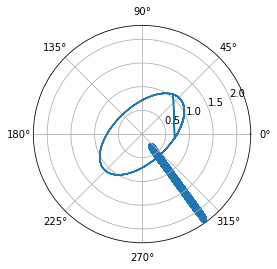

 54%|█████▍    | 540/1000 [03:03<02:40,  2.87it/s]

1.0766438837886834


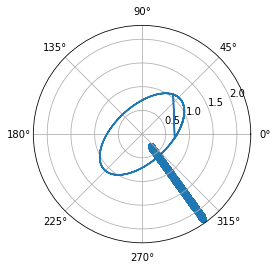

 54%|█████▍    | 541/1000 [03:03<02:39,  2.87it/s]

1.0750602248940233


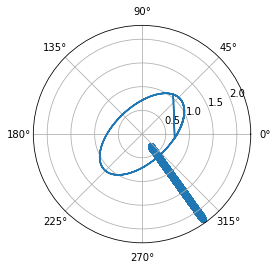

 54%|█████▍    | 542/1000 [03:03<02:36,  2.93it/s]

1.0734757622878506


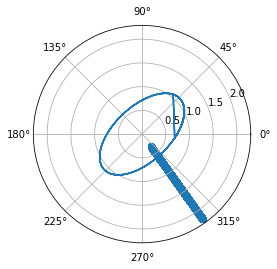

 54%|█████▍    | 543/1000 [03:04<02:34,  2.96it/s]

1.0718904788494745


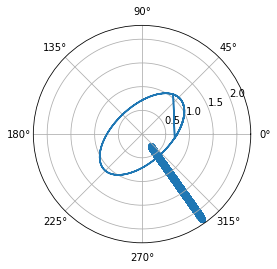

 54%|█████▍    | 544/1000 [03:04<02:34,  2.96it/s]

1.070304337894382


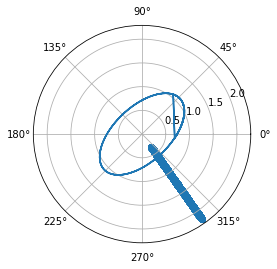

 55%|█████▍    | 545/1000 [03:04<02:30,  3.02it/s]

1.0687173420963276


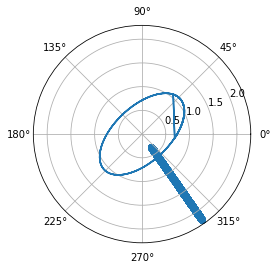

 55%|█████▍    | 546/1000 [03:04<02:28,  3.05it/s]

1.0671294608922348


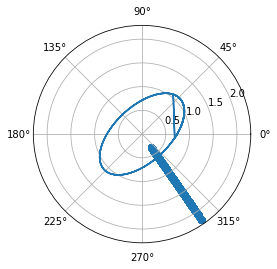

 55%|█████▍    | 547/1000 [03:05<02:27,  3.06it/s]

1.0655406744766487


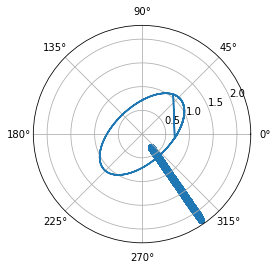

 55%|█████▍    | 548/1000 [03:05<02:23,  3.16it/s]

1.0639509784001484


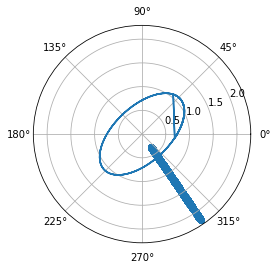

 55%|█████▍    | 549/1000 [03:05<02:28,  3.04it/s]

1.0623603286487378


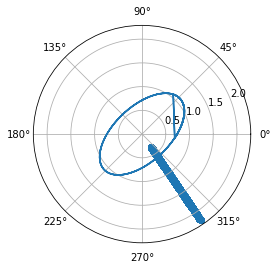

 55%|█████▌    | 550/1000 [03:06<02:32,  2.94it/s]

1.060768729373972


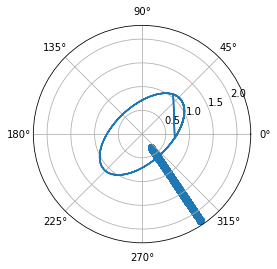

 55%|█████▌    | 551/1000 [03:06<02:44,  2.73it/s]

1.0591761538355917


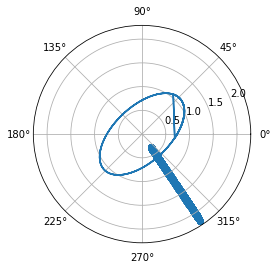

 55%|█████▌    | 552/1000 [03:07<02:47,  2.67it/s]

1.057582575666585


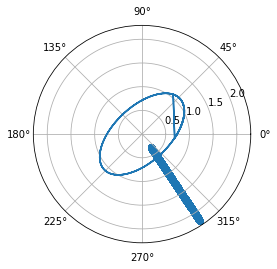

 55%|█████▌    | 553/1000 [03:07<02:41,  2.77it/s]

1.055987995725129


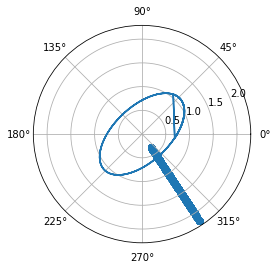

 55%|█████▌    | 554/1000 [03:07<02:34,  2.88it/s]

1.0543923658586214


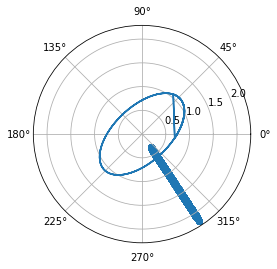

 56%|█████▌    | 555/1000 [03:08<02:28,  3.00it/s]

1.0527956938549559


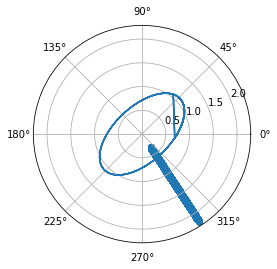

 56%|█████▌    | 556/1000 [03:08<02:25,  3.06it/s]

1.0511979480667246


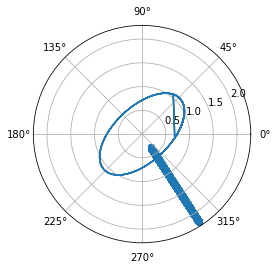

 56%|█████▌    | 557/1000 [03:08<02:24,  3.06it/s]

1.0495991078491558


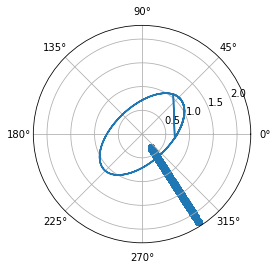

 56%|█████▌    | 558/1000 [03:09<02:22,  3.11it/s]

1.0479991699361415


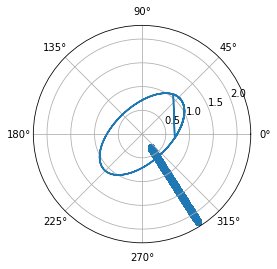

 56%|█████▌    | 559/1000 [03:09<02:18,  3.18it/s]

1.0463980851516237


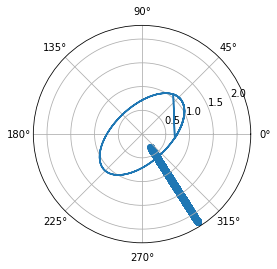

 56%|█████▌    | 560/1000 [03:09<02:15,  3.25it/s]

1.0447958686958643


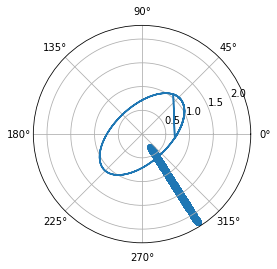

 56%|█████▌    | 561/1000 [03:09<02:16,  3.21it/s]

1.0431924727224589


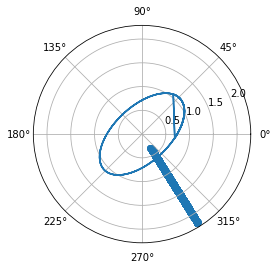

 56%|█████▌    | 562/1000 [03:10<02:18,  3.16it/s]

1.0415878976114032


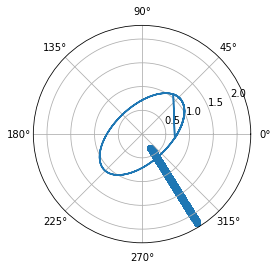

 56%|█████▋    | 563/1000 [03:10<02:15,  3.22it/s]

1.0399821170299535


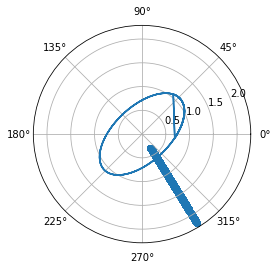

 56%|█████▋    | 564/1000 [03:10<02:15,  3.23it/s]

1.0383751064110043


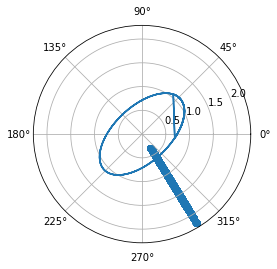

 56%|█████▋    | 565/1000 [03:11<02:15,  3.22it/s]

1.0367668640423817


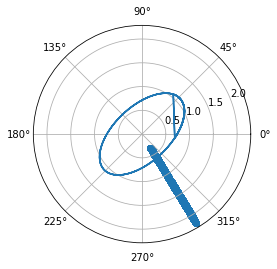

 57%|█████▋    | 566/1000 [03:11<02:25,  2.98it/s]

1.0351573408438184


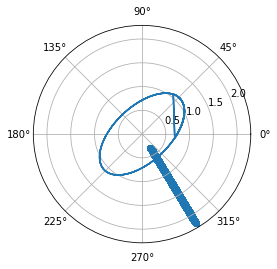

 57%|█████▋    | 567/1000 [03:11<02:30,  2.88it/s]

1.0335465552265675


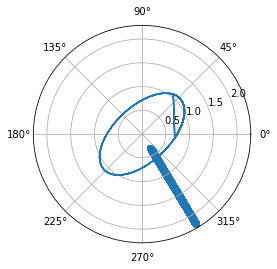

 57%|█████▋    | 568/1000 [03:12<02:43,  2.64it/s]

1.0319344461453688


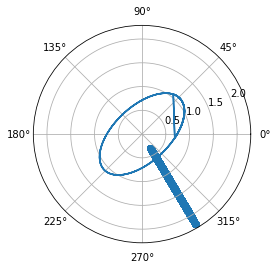

 57%|█████▋    | 569/1000 [03:12<02:35,  2.77it/s]

1.0303210328370176


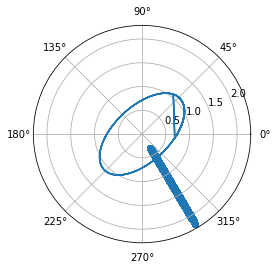

 57%|█████▋    | 570/1000 [03:13<02:35,  2.76it/s]

1.0287062670288891


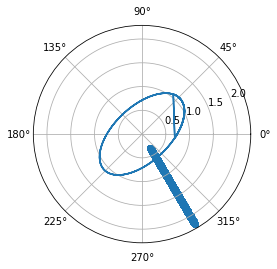

 57%|█████▋    | 571/1000 [03:13<02:43,  2.63it/s]

1.0270901484096808


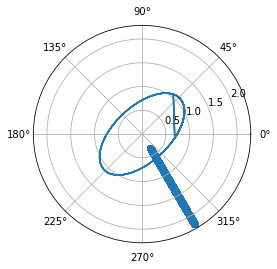

 57%|█████▋    | 572/1000 [03:13<02:43,  2.62it/s]

1.0254726476765277


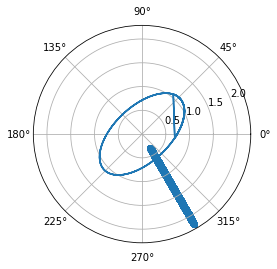

 57%|█████▋    | 573/1000 [03:14<02:40,  2.66it/s]

1.0238537458882642


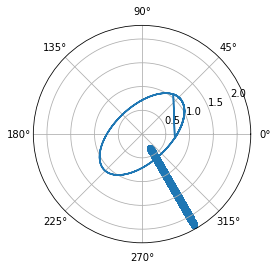

 57%|█████▋    | 574/1000 [03:14<02:34,  2.75it/s]

1.0222334317304371


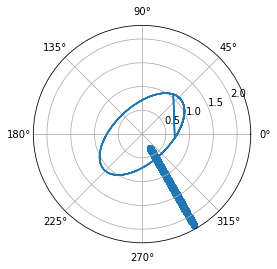

 57%|█████▊    | 575/1000 [03:14<02:33,  2.77it/s]

1.0206116686709246


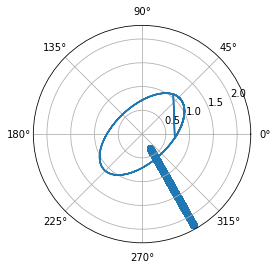

 58%|█████▊    | 576/1000 [03:15<02:29,  2.84it/s]

1.0189884622837733


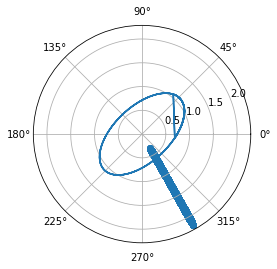

 58%|█████▊    | 577/1000 [03:15<02:23,  2.95it/s]

1.0173637596012026


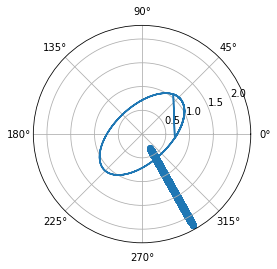

 58%|█████▊    | 578/1000 [03:15<02:25,  2.91it/s]

1.015737581871627


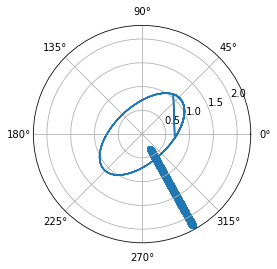

 58%|█████▊    | 579/1000 [03:16<02:22,  2.95it/s]

1.014109860958903


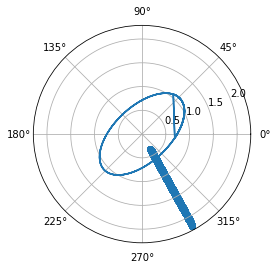

 58%|█████▊    | 580/1000 [03:16<02:17,  3.06it/s]

1.0124806311280874


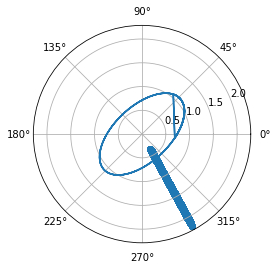

 58%|█████▊    | 581/1000 [03:16<02:13,  3.14it/s]

1.0108498144509377


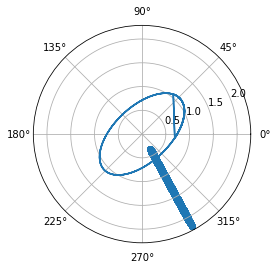

 58%|█████▊    | 582/1000 [03:17<02:16,  3.06it/s]

1.009217449047342


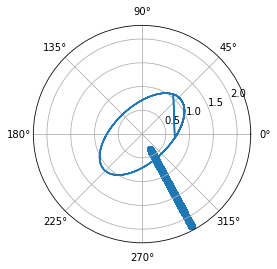

 58%|█████▊    | 583/1000 [03:17<02:14,  3.09it/s]

1.007583461202168


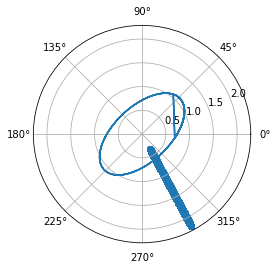

 58%|█████▊    | 584/1000 [03:17<02:13,  3.11it/s]

1.0059478809738365


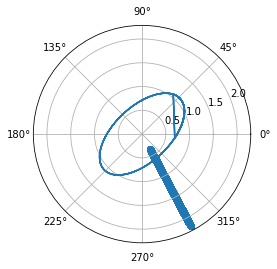

 58%|█████▊    | 585/1000 [03:18<02:21,  2.94it/s]

1.00431064174626


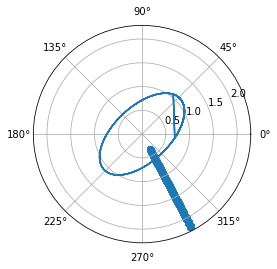

 59%|█████▊    | 586/1000 [03:18<02:23,  2.89it/s]

1.0026717671651548


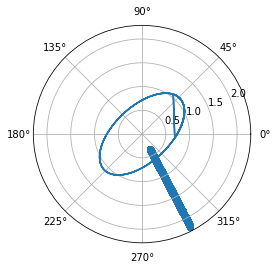

 59%|█████▊    | 587/1000 [03:18<02:16,  3.03it/s]

1.0010311960165925


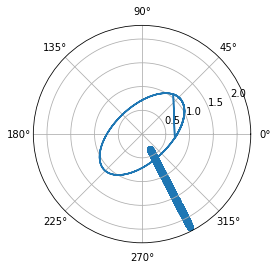

 59%|█████▉    | 588/1000 [03:19<02:12,  3.11it/s]

0.9993889472728436


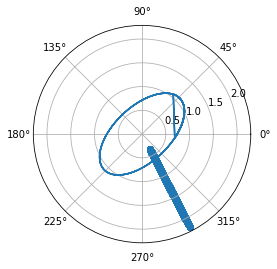

 59%|█████▉    | 589/1000 [03:19<02:08,  3.21it/s]

0.9977449633372363


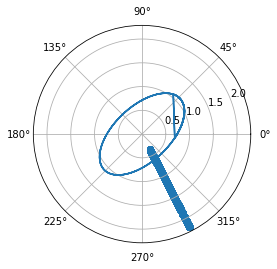

 59%|█████▉    | 590/1000 [03:19<02:15,  3.03it/s]

0.9960992603334206


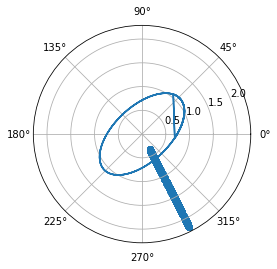

 59%|█████▉    | 591/1000 [03:20<02:13,  3.06it/s]

0.9944517824140361


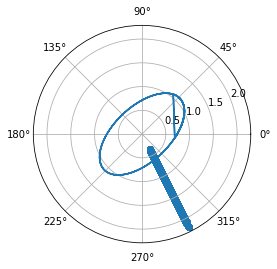

 59%|█████▉    | 592/1000 [03:20<02:11,  3.10it/s]

0.9928025447595035


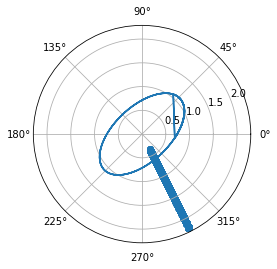

 59%|█████▉    | 593/1000 [03:20<02:12,  3.07it/s]

0.9911514913258342


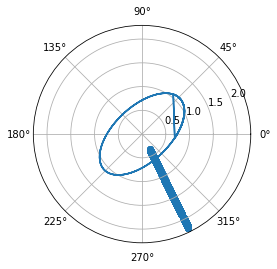

 59%|█████▉    | 594/1000 [03:21<02:10,  3.11it/s]

0.9894986383310891


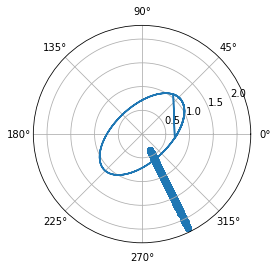

 60%|█████▉    | 595/1000 [03:21<02:07,  3.17it/s]

0.9878439275158515


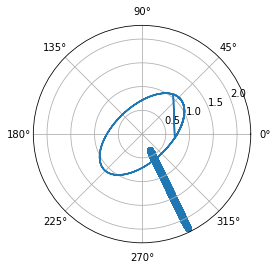

 60%|█████▉    | 596/1000 [03:21<02:05,  3.22it/s]

0.9861873781870197


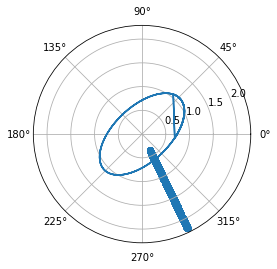

 60%|█████▉    | 597/1000 [03:22<02:06,  3.19it/s]

0.9845289277832737


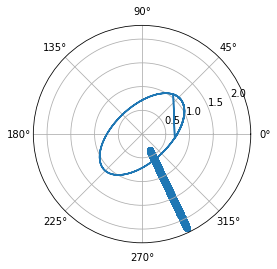

 60%|█████▉    | 598/1000 [03:22<02:05,  3.21it/s]

0.9828686008166629


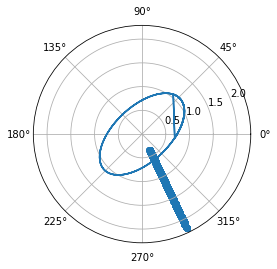

 60%|█████▉    | 599/1000 [03:22<02:01,  3.30it/s]

0.9812063282750679


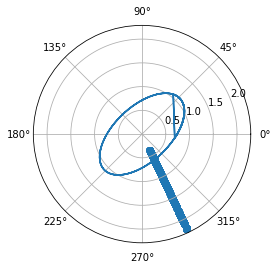

 60%|██████    | 600/1000 [03:22<02:02,  3.26it/s]

0.9795421420518434


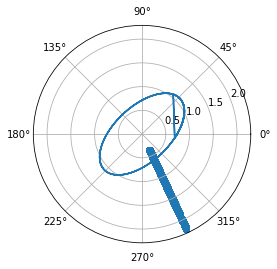

 60%|██████    | 601/1000 [03:23<02:03,  3.24it/s]

0.9778759644780664


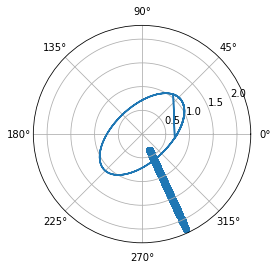

 60%|██████    | 602/1000 [03:23<02:03,  3.23it/s]

0.9762078370590646


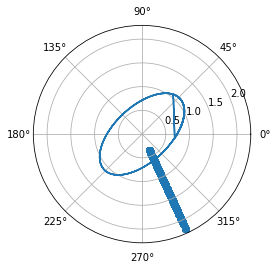

 60%|██████    | 603/1000 [03:23<02:08,  3.09it/s]

0.9745376712113545


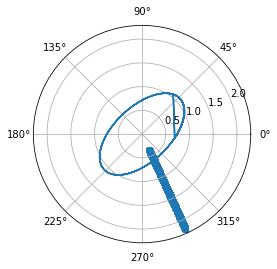

 60%|██████    | 604/1000 [03:24<02:09,  3.06it/s]

0.9728655203064787


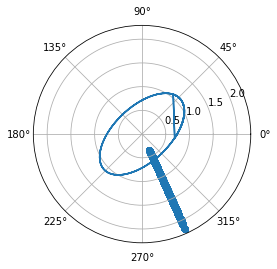

 60%|██████    | 605/1000 [03:24<02:08,  3.08it/s]

0.9711912826189987


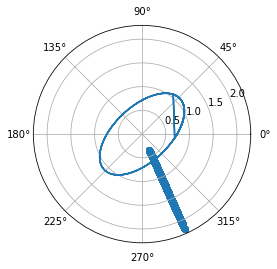

 61%|██████    | 606/1000 [03:24<02:04,  3.16it/s]

0.969515018561711


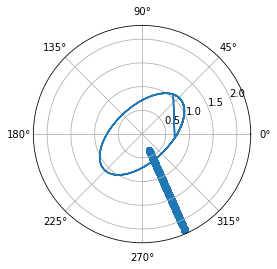

 61%|██████    | 607/1000 [03:25<02:05,  3.12it/s]

0.9678366321631543


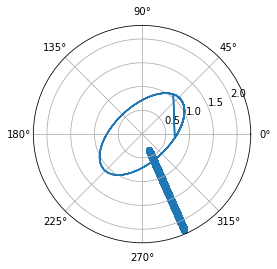

 61%|██████    | 608/1000 [03:25<02:12,  2.97it/s]

0.966156170834381


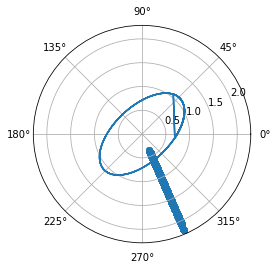

 61%|██████    | 609/1000 [03:25<02:10,  3.00it/s]

0.9644735526175905


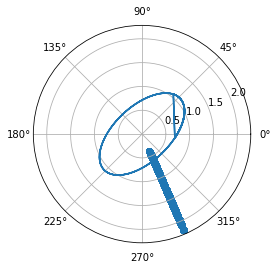

 61%|██████    | 610/1000 [03:26<02:09,  3.00it/s]

0.9627888095444547


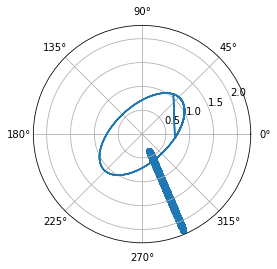

 61%|██████    | 611/1000 [03:26<02:12,  2.93it/s]

0.9611018760616754


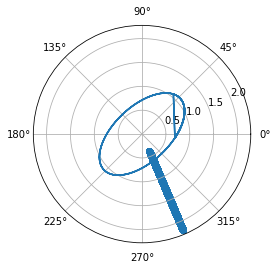

 61%|██████    | 612/1000 [03:27<02:17,  2.81it/s]

0.959412766416049


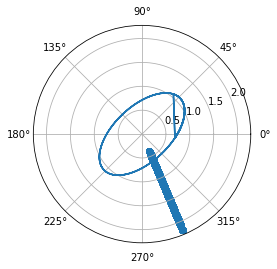

 61%|██████▏   | 613/1000 [03:27<02:11,  2.93it/s]

0.9577214338748632


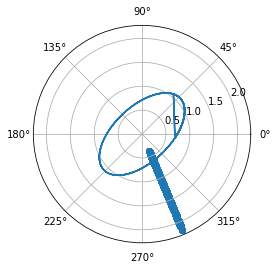

 61%|██████▏   | 614/1000 [03:27<02:13,  2.90it/s]

0.9560278724721876


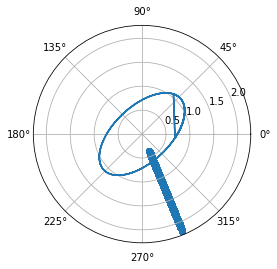

 62%|██████▏   | 615/1000 [03:28<02:20,  2.75it/s]

0.9543320567317223


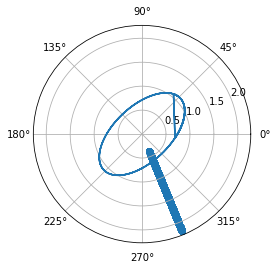

 62%|██████▏   | 616/1000 [03:28<02:21,  2.72it/s]

0.952633958030119


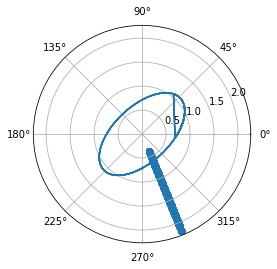

 62%|██████▏   | 617/1000 [03:28<02:19,  2.75it/s]

0.9509335745975569


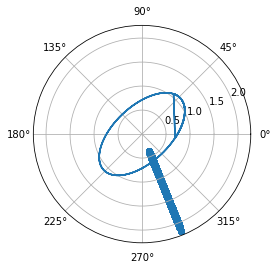

 62%|██████▏   | 618/1000 [03:29<02:22,  2.69it/s]

0.9492308526972472


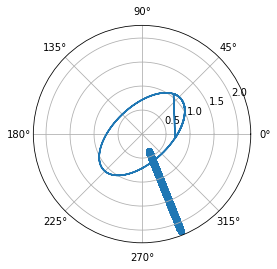

 62%|██████▏   | 619/1000 [03:29<02:16,  2.78it/s]

0.9475258167246584


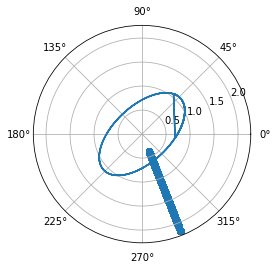

 62%|██████▏   | 620/1000 [03:30<02:37,  2.41it/s]

0.9458183853677156


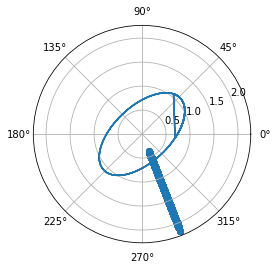

 62%|██████▏   | 621/1000 [03:30<02:37,  2.41it/s]

0.9441086116492426


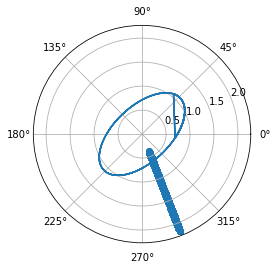

 62%|██████▏   | 622/1000 [03:30<02:27,  2.57it/s]

0.9423963842196963


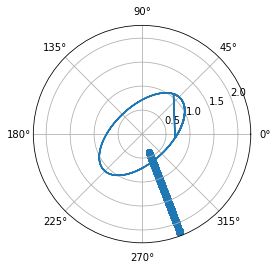

 62%|██████▏   | 623/1000 [03:31<02:17,  2.75it/s]

0.9406817730742509


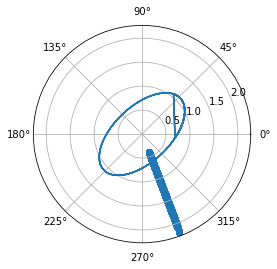

 62%|██████▏   | 624/1000 [03:31<02:09,  2.90it/s]

0.9389646767134308


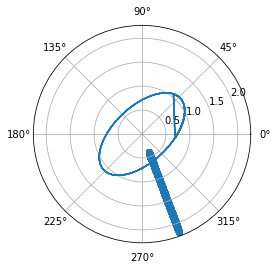

 62%|██████▎   | 625/1000 [03:31<02:09,  2.90it/s]

0.9372451395688584


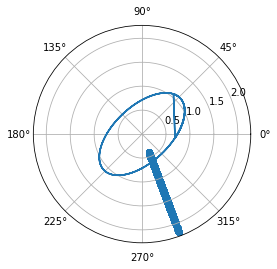

 63%|██████▎   | 626/1000 [03:32<02:06,  2.95it/s]

0.9355230895900737


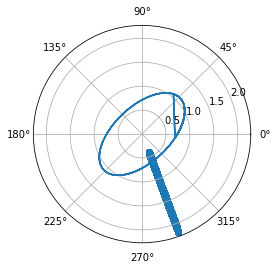

 63%|██████▎   | 627/1000 [03:32<02:01,  3.06it/s]

0.933798538943572


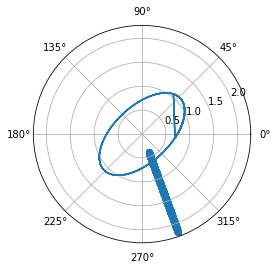

 63%|██████▎   | 628/1000 [03:32<02:03,  3.01it/s]

0.9320714488713921


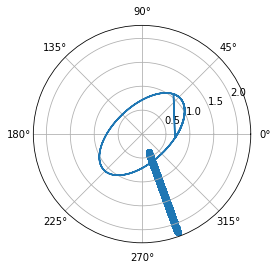

 63%|██████▎   | 629/1000 [03:33<02:03,  3.00it/s]

0.930341796866071


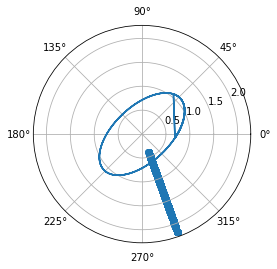

 63%|██████▎   | 630/1000 [03:33<02:01,  3.05it/s]

0.9286095798603711


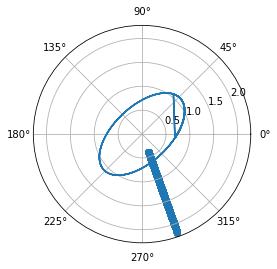

 63%|██████▎   | 631/1000 [03:33<02:01,  3.05it/s]

0.9268747382872271


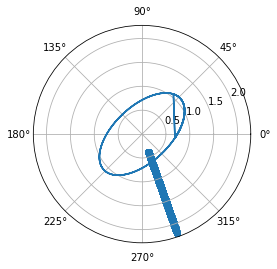

 63%|██████▎   | 632/1000 [03:34<01:59,  3.09it/s]

0.925137307142782


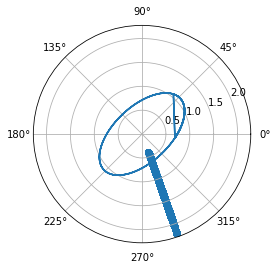

 63%|██████▎   | 633/1000 [03:34<01:58,  3.11it/s]

0.9233971874431611


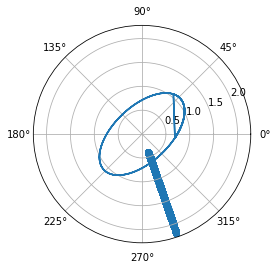

 63%|██████▎   | 634/1000 [03:34<02:01,  3.00it/s]

0.9216544463740962


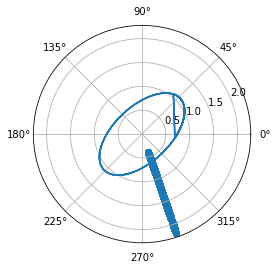

 64%|██████▎   | 635/1000 [03:35<01:57,  3.11it/s]

0.9199089678583398


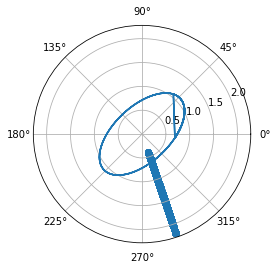

 64%|██████▎   | 636/1000 [03:35<01:56,  3.13it/s]

0.9181608158789016


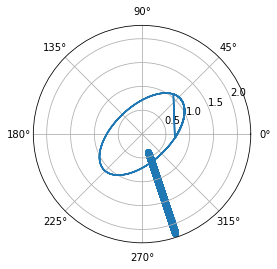

 64%|██████▎   | 637/1000 [03:35<01:52,  3.22it/s]

0.9164099023497768


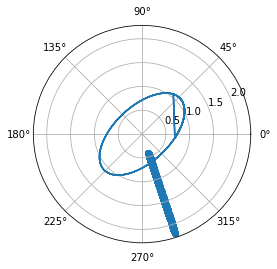

 64%|██████▍   | 638/1000 [03:35<01:51,  3.25it/s]

0.9146562500490297


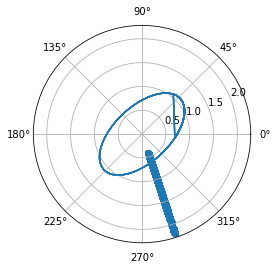

 64%|██████▍   | 639/1000 [03:36<01:57,  3.08it/s]

0.9128998130323979


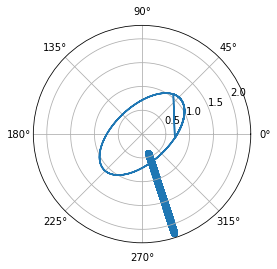

 64%|██████▍   | 640/1000 [03:36<02:00,  2.98it/s]

0.9111405706629798


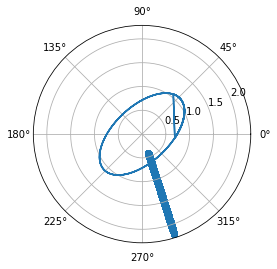

 64%|██████▍   | 641/1000 [03:36<01:57,  3.06it/s]

0.9093785213256259


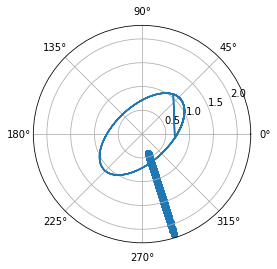

 64%|██████▍   | 642/1000 [03:37<01:54,  3.12it/s]

0.9076135988087155


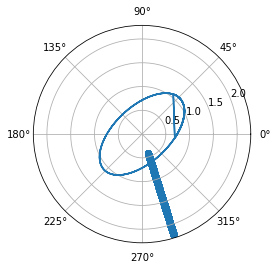

 64%|██████▍   | 643/1000 [03:37<01:52,  3.19it/s]

0.9058458479612584


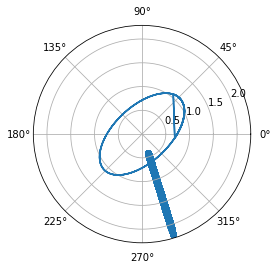

 64%|██████▍   | 644/1000 [03:37<01:52,  3.17it/s]

0.9040751548921799


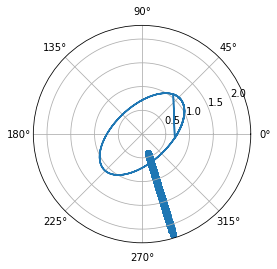

 64%|██████▍   | 645/1000 [03:38<01:51,  3.18it/s]

0.902301597881092


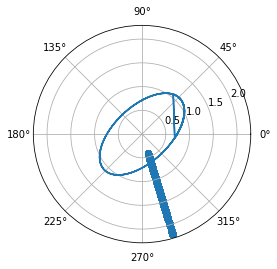

 65%|██████▍   | 646/1000 [03:38<01:52,  3.16it/s]

0.9005250586471899


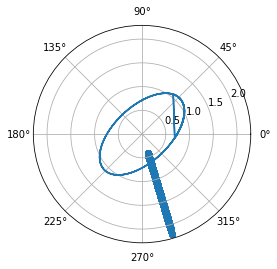

 65%|██████▍   | 647/1000 [03:38<01:53,  3.12it/s]

0.8987455956299033


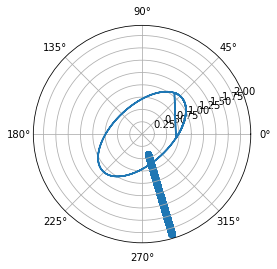

 65%|██████▍   | 648/1000 [03:39<01:54,  3.06it/s]

0.8969631291467784


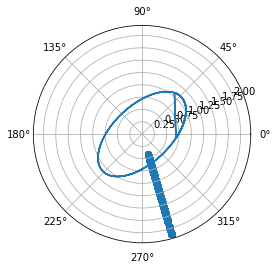

 65%|██████▍   | 649/1000 [03:39<01:55,  3.03it/s]

0.8951776689425232


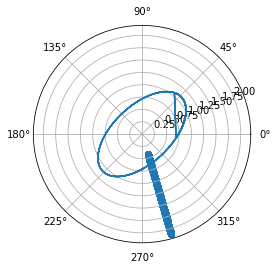

 65%|██████▌   | 650/1000 [03:39<01:52,  3.10it/s]

0.8933891848160606


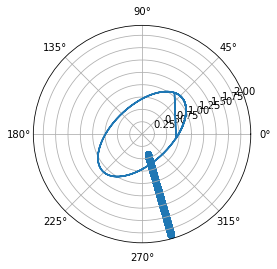

 65%|██████▌   | 651/1000 [03:40<01:55,  3.01it/s]

0.8915976359436049


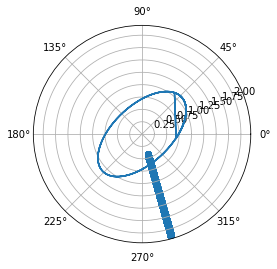

 65%|██████▌   | 652/1000 [03:40<01:56,  2.99it/s]

0.8898030434466788


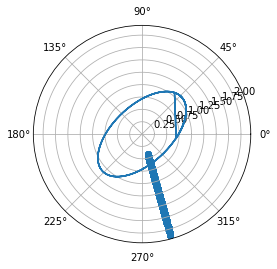

 65%|██████▌   | 653/1000 [03:40<01:54,  3.02it/s]

0.8880053141331791


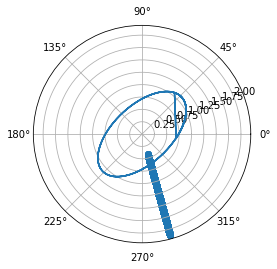

 65%|██████▌   | 654/1000 [03:41<01:53,  3.05it/s]

0.886204519241552


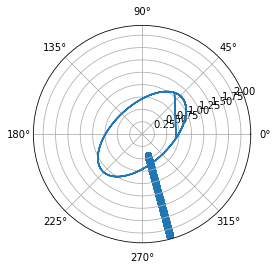

 66%|██████▌   | 655/1000 [03:41<01:54,  3.01it/s]

0.8844005204035832


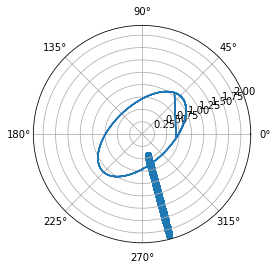

 66%|██████▌   | 656/1000 [03:41<02:00,  2.87it/s]

0.8825934076812498


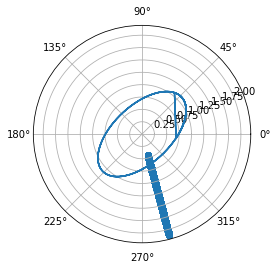

 66%|██████▌   | 657/1000 [03:42<02:00,  2.85it/s]

0.8807830710581601


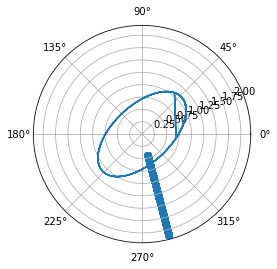

 66%|██████▌   | 658/1000 [03:42<02:01,  2.81it/s]

0.8789695480579899


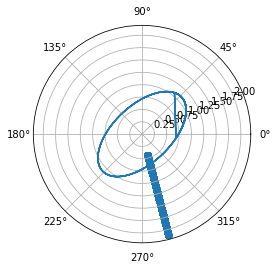

 66%|██████▌   | 659/1000 [03:42<01:59,  2.86it/s]

0.8771527818318037


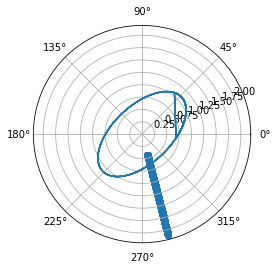

 66%|██████▌   | 660/1000 [03:43<01:58,  2.87it/s]

0.875332755852866


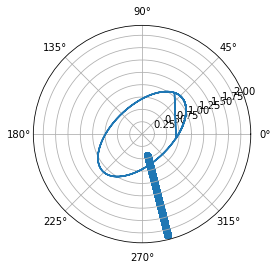

 66%|██████▌   | 661/1000 [03:43<01:56,  2.91it/s]

0.8735094679134381


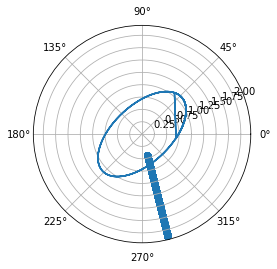

 66%|██████▌   | 662/1000 [03:43<01:54,  2.94it/s]

0.8716828460137794


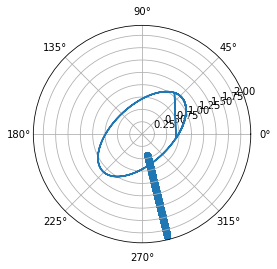

 66%|██████▋   | 663/1000 [03:44<01:53,  2.97it/s]

0.8698529439704987


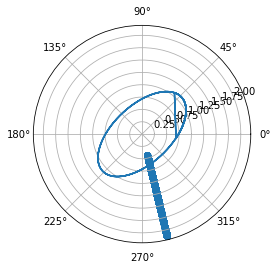

 66%|██████▋   | 664/1000 [03:44<01:50,  3.04it/s]

0.8680196329809043


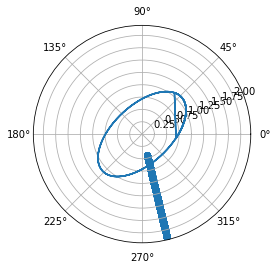

 66%|██████▋   | 665/1000 [03:44<01:54,  2.93it/s]

0.8661830064481748


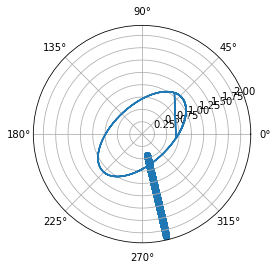

 67%|██████▋   | 666/1000 [03:45<01:54,  2.92it/s]

0.86434293071429


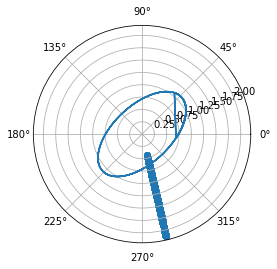

 67%|██████▋   | 667/1000 [03:45<01:55,  2.89it/s]

0.8624994757987432


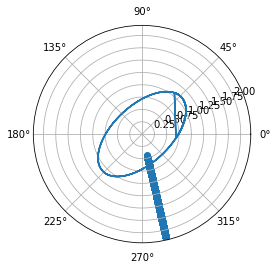

 67%|██████▋   | 668/1000 [03:46<01:54,  2.90it/s]

0.8606525527236804


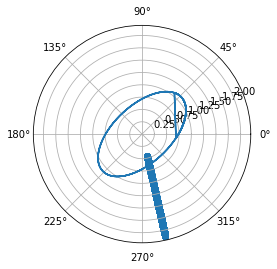

 67%|██████▋   | 669/1000 [03:46<01:56,  2.85it/s]

0.8588021757660806


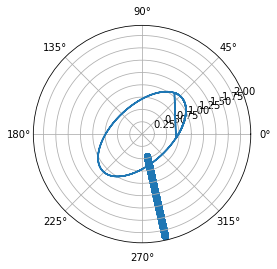

 67%|██████▋   | 670/1000 [03:46<01:55,  2.85it/s]

0.8569483121006434


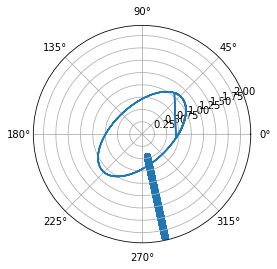

 67%|██████▋   | 671/1000 [03:47<01:53,  2.91it/s]

0.8550909192709886


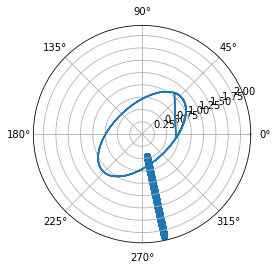

 67%|██████▋   | 672/1000 [03:47<01:58,  2.76it/s]

0.8532300215531058


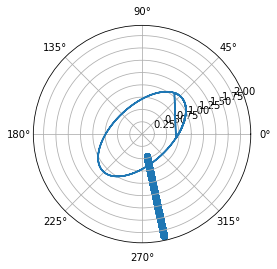

 67%|██████▋   | 673/1000 [03:47<01:57,  2.78it/s]

0.8513655188692867


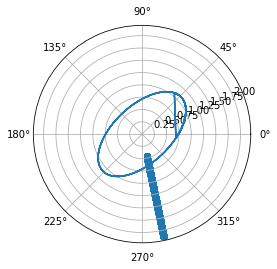

 67%|██████▋   | 674/1000 [03:48<01:53,  2.87it/s]

0.8494974934423765


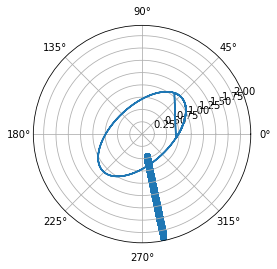

 68%|██████▊   | 675/1000 [03:48<01:54,  2.85it/s]

0.8476257867900518


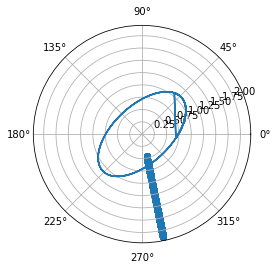

 68%|██████▊   | 676/1000 [03:48<01:54,  2.83it/s]

0.8457505120200342


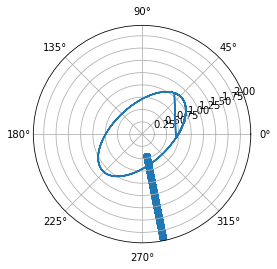

 68%|██████▊   | 677/1000 [03:49<01:52,  2.86it/s]

0.8438715349765049


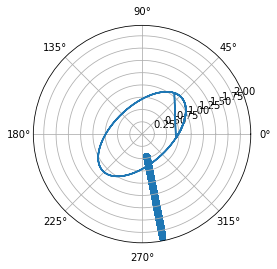

 68%|██████▊   | 678/1000 [03:49<01:51,  2.88it/s]

0.841988915779062


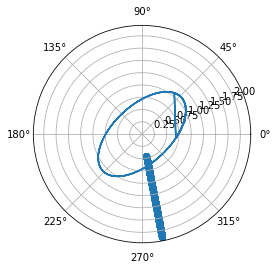

 68%|██████▊   | 679/1000 [03:49<01:52,  2.85it/s]

0.8401025751296332


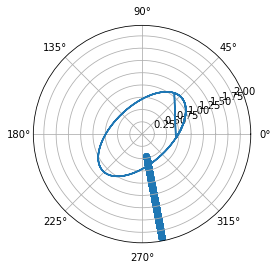

 68%|██████▊   | 680/1000 [03:50<01:52,  2.86it/s]

0.8382125171657739


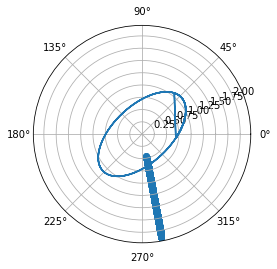

 68%|██████▊   | 681/1000 [03:50<01:51,  2.87it/s]

0.8363187187546569


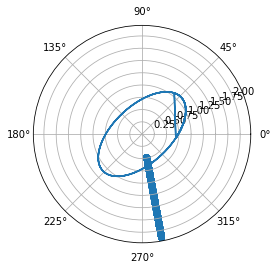

 68%|██████▊   | 682/1000 [03:50<01:52,  2.82it/s]

0.8344211276327723


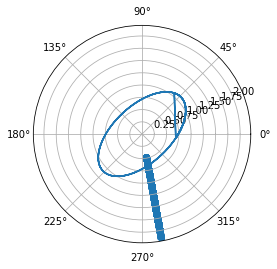

 68%|██████▊   | 683/1000 [03:51<01:50,  2.86it/s]

0.8325197772104515


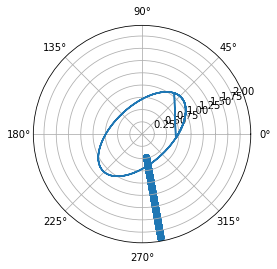

 68%|██████▊   | 684/1000 [03:51<01:48,  2.91it/s]

0.830614558512217


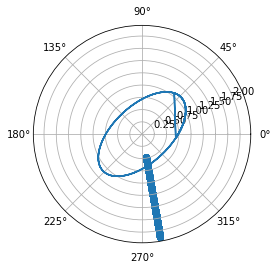

 68%|██████▊   | 685/1000 [03:51<01:48,  2.89it/s]

0.8287055617620221


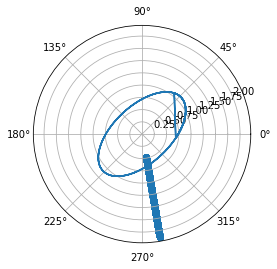

 69%|██████▊   | 686/1000 [03:52<01:51,  2.82it/s]

0.8267926210697907


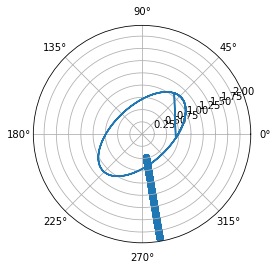

 69%|██████▊   | 687/1000 [03:52<01:47,  2.91it/s]

0.8248758586747685


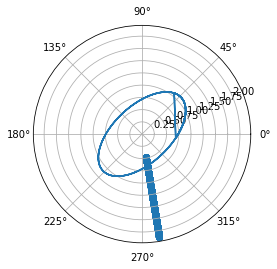

 69%|██████▉   | 688/1000 [03:53<01:51,  2.81it/s]

0.8229551265618976


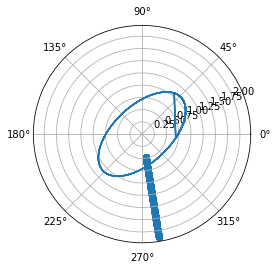

 69%|██████▉   | 689/1000 [03:53<01:51,  2.78it/s]

0.8210305015784874


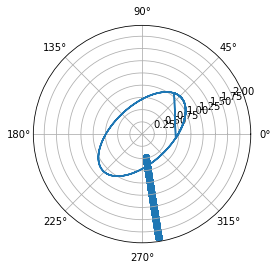

 69%|██████▉   | 690/1000 [03:53<01:46,  2.90it/s]

0.8191018862962068


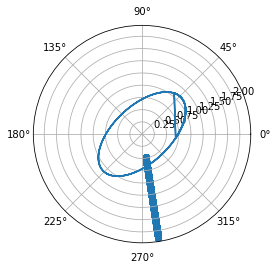

 69%|██████▉   | 691/1000 [03:54<01:44,  2.96it/s]

0.817169304447282


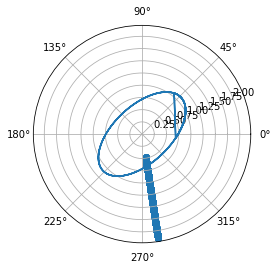

 69%|██████▉   | 692/1000 [03:54<01:46,  2.88it/s]

0.8152327116956593


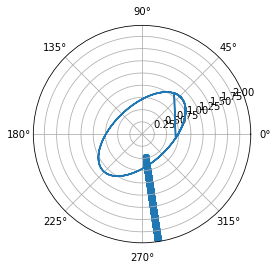

 69%|██████▉   | 693/1000 [03:54<01:46,  2.87it/s]

0.813292078812701


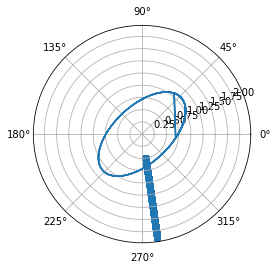

 69%|██████▉   | 694/1000 [03:55<01:44,  2.92it/s]

0.8113474143660692


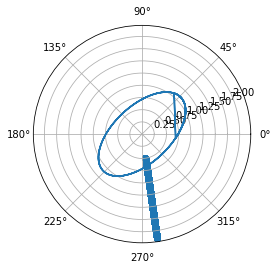

 70%|██████▉   | 695/1000 [03:55<01:46,  2.85it/s]

0.8093986364239154


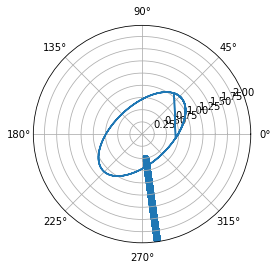

 70%|██████▉   | 696/1000 [03:55<01:51,  2.72it/s]

0.8074458061674417


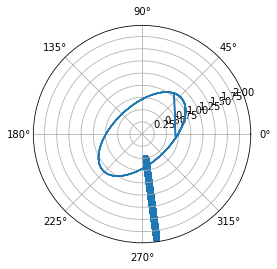

 70%|██████▉   | 697/1000 [03:56<01:47,  2.81it/s]

0.805488789320843


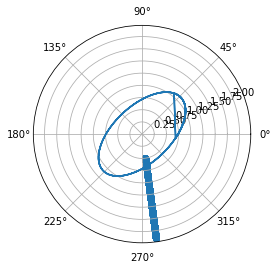

 70%|██████▉   | 698/1000 [03:56<01:44,  2.90it/s]

0.8035276983423817


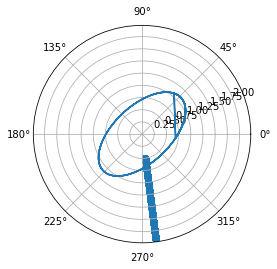

 70%|██████▉   | 699/1000 [03:56<01:44,  2.88it/s]

0.8015623499111976


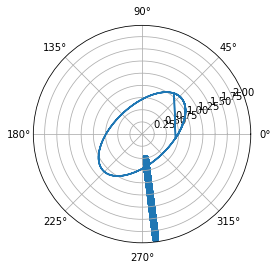

 70%|███████   | 700/1000 [03:57<01:41,  2.96it/s]

0.7995928806883775


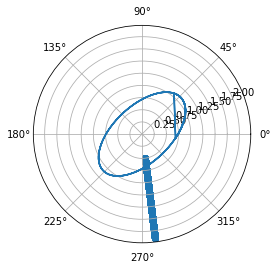

 70%|███████   | 701/1000 [03:57<01:40,  2.99it/s]

0.7976191310515872


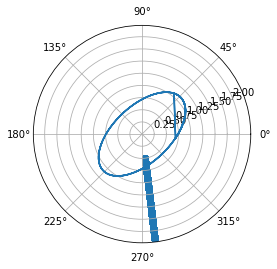

 70%|███████   | 702/1000 [03:57<01:37,  3.04it/s]

0.7956411903666377


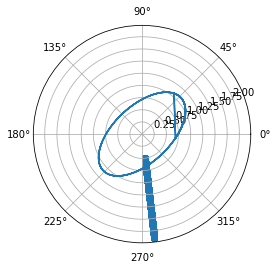

 70%|███████   | 703/1000 [03:58<01:39,  2.98it/s]

0.7936589461328057


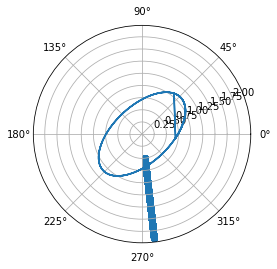

 70%|███████   | 704/1000 [03:58<01:45,  2.80it/s]

0.7916724410902451


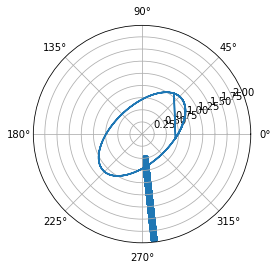

 70%|███████   | 705/1000 [03:58<01:43,  2.84it/s]

0.7896816091694665


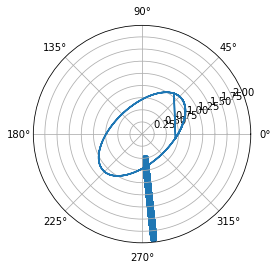

 71%|███████   | 706/1000 [03:59<01:43,  2.84it/s]

0.7876864472415848


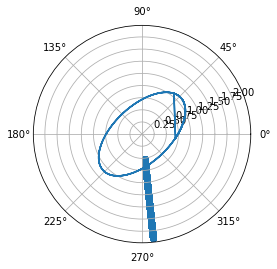

 71%|███████   | 707/1000 [03:59<01:39,  2.93it/s]

0.7856869348941256


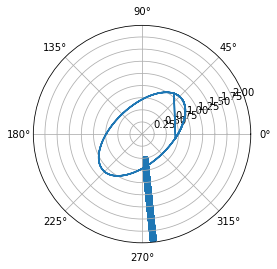

 71%|███████   | 708/1000 [03:59<01:36,  3.02it/s]

0.7836830239686509


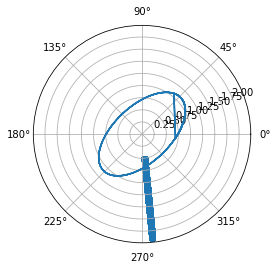

 71%|███████   | 709/1000 [04:00<01:35,  3.04it/s]

0.7816747388560489


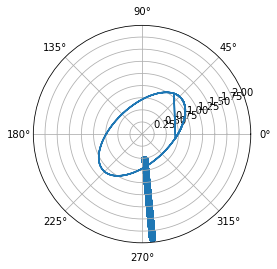

 71%|███████   | 710/1000 [04:00<01:44,  2.78it/s]

0.7796619872860892


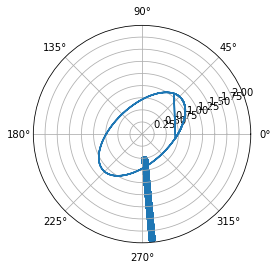

 71%|███████   | 711/1000 [04:01<01:45,  2.73it/s]

0.7776448375247813


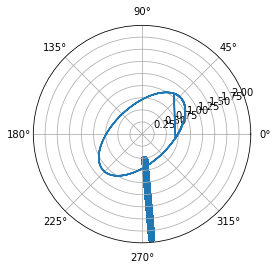

 71%|███████   | 712/1000 [04:01<01:44,  2.75it/s]

0.775623154181113


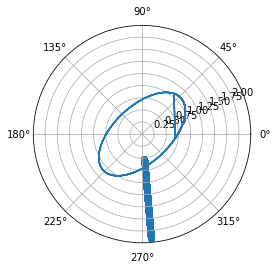

 71%|███████▏  | 713/1000 [04:01<01:44,  2.74it/s]

0.7735970483986878


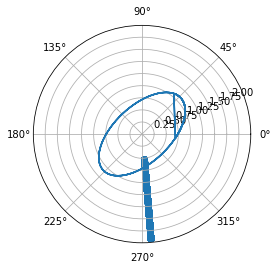

 71%|███████▏  | 714/1000 [04:02<01:42,  2.80it/s]

0.7715663427244701


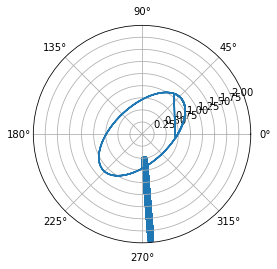

 72%|███████▏  | 715/1000 [04:02<01:41,  2.81it/s]

0.769531181536057


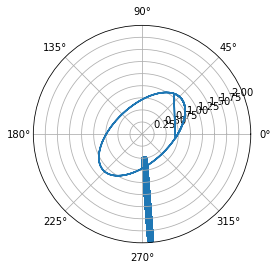

 72%|███████▏  | 716/1000 [04:02<01:42,  2.76it/s]

0.7674913721866314


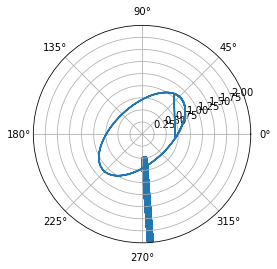

 72%|███████▏  | 717/1000 [04:03<01:46,  2.67it/s]

0.7654470550494241


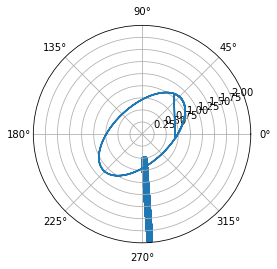

 72%|███████▏  | 718/1000 [04:03<01:50,  2.55it/s]

0.763398063159371


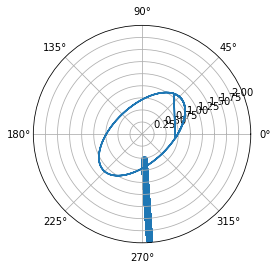

 72%|███████▏  | 719/1000 [04:04<01:51,  2.52it/s]

0.7613445011999064


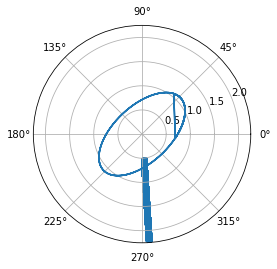

 72%|███████▏  | 720/1000 [04:04<01:52,  2.50it/s]

0.7592862376829259


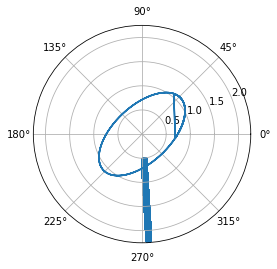

 72%|███████▏  | 721/1000 [04:04<01:50,  2.53it/s]

0.7572233428106399


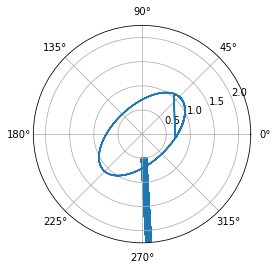

 72%|███████▏  | 722/1000 [04:05<01:54,  2.43it/s]

0.7551557193789162


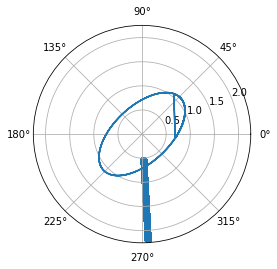

 72%|███████▏  | 723/1000 [04:05<01:55,  2.40it/s]

0.7530834043528035


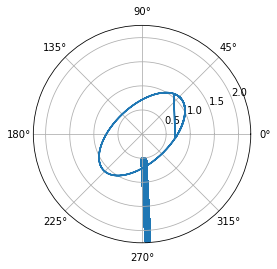

 72%|███████▏  | 724/1000 [04:06<01:50,  2.49it/s]

0.7510063335892233


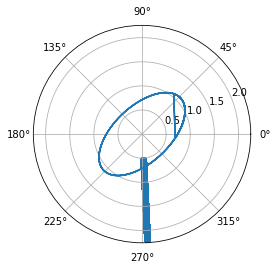

 72%|███████▎  | 725/1000 [04:06<01:43,  2.65it/s]

0.7489245120874233


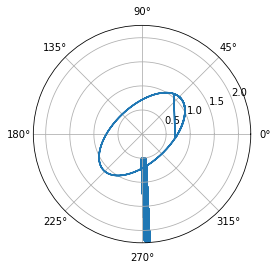

 73%|███████▎  | 726/1000 [04:06<01:41,  2.70it/s]

0.7468379075210166


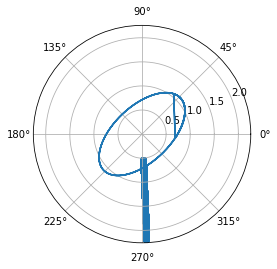

 73%|███████▎  | 727/1000 [04:07<01:36,  2.83it/s]

0.7447464942134262


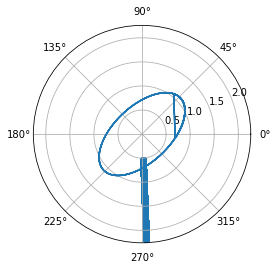

 73%|███████▎  | 728/1000 [04:07<01:33,  2.92it/s]

0.7426502703981328


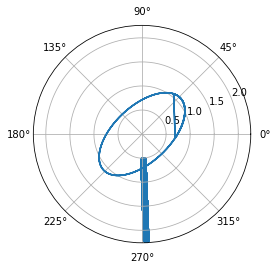

 73%|███████▎  | 729/1000 [04:07<01:31,  2.95it/s]

0.740549181022151


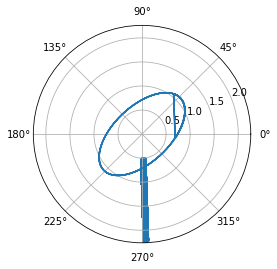

 73%|███████▎  | 730/1000 [04:08<01:30,  2.99it/s]

0.738443253619028


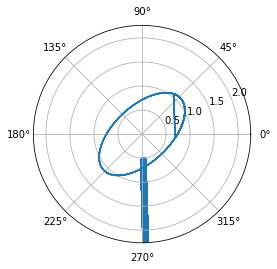

 73%|███████▎  | 731/1000 [04:08<01:26,  3.09it/s]

0.736332405058533


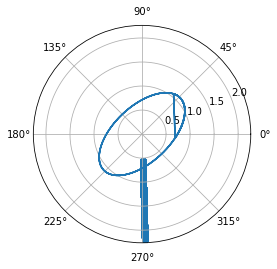

 73%|███████▎  | 732/1000 [04:08<01:25,  3.13it/s]

0.734216690921492


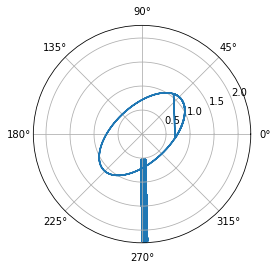

 73%|███████▎  | 733/1000 [04:09<01:26,  3.08it/s]

0.7320960012891702


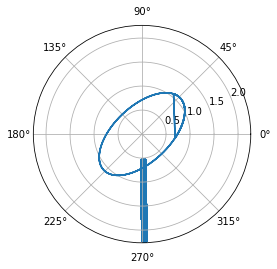

 73%|███████▎  | 734/1000 [04:09<01:25,  3.13it/s]

0.729970418554374


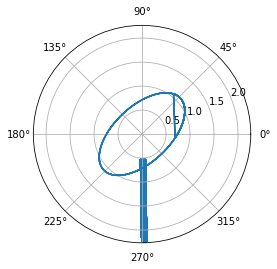

 74%|███████▎  | 735/1000 [04:09<01:24,  3.14it/s]

0.7278398072775042


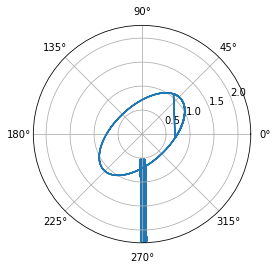

 74%|███████▎  | 736/1000 [04:09<01:23,  3.16it/s]

0.7257042754565239


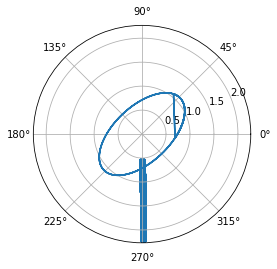

 74%|███████▎  | 737/1000 [04:10<01:25,  3.09it/s]

0.72356366336634


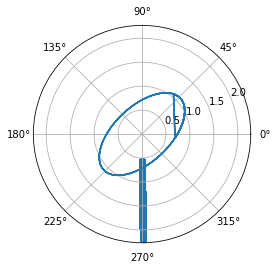

 74%|███████▍  | 738/1000 [04:10<01:30,  2.91it/s]

0.7214181034431867


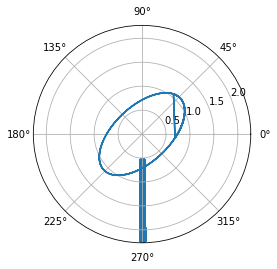

 74%|███████▍  | 739/1000 [04:11<01:27,  2.99it/s]

0.7192674128679373


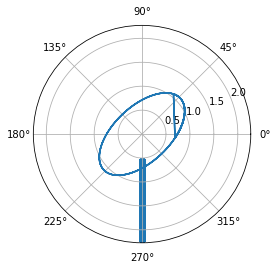

 74%|███████▍  | 740/1000 [04:11<01:26,  3.01it/s]

0.7171117474000975


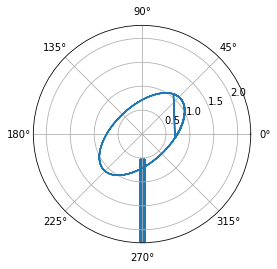

 74%|███████▍  | 741/1000 [04:11<01:26,  3.00it/s]

0.714950902261925


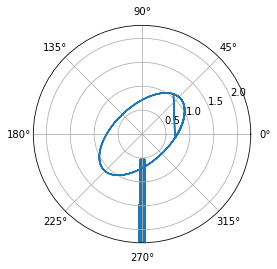

 74%|███████▍  | 742/1000 [04:12<01:27,  2.95it/s]

0.7127850544307833


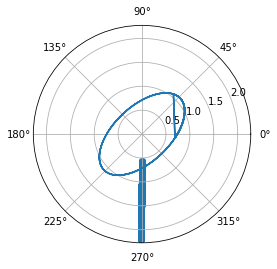

 74%|███████▍  | 743/1000 [04:12<01:23,  3.09it/s]

0.7106139814012707


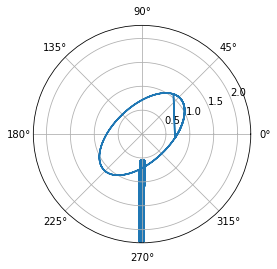

 74%|███████▍  | 744/1000 [04:12<01:28,  2.90it/s]

0.7084378689224189


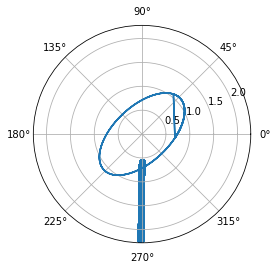

 74%|███████▍  | 745/1000 [04:13<01:25,  2.99it/s]

0.7062565037265726


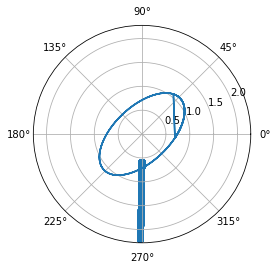

 75%|███████▍  | 746/1000 [04:13<01:30,  2.81it/s]

0.7040700549279092


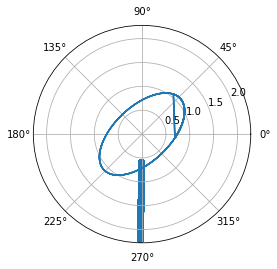

 75%|███████▍  | 747/1000 [04:13<01:30,  2.80it/s]

0.7018783264889248


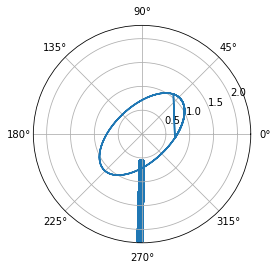

 75%|███████▍  | 748/1000 [04:14<01:28,  2.83it/s]

0.6996814716608158


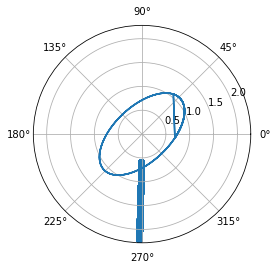

 75%|███████▍  | 749/1000 [04:14<01:29,  2.81it/s]

0.6974793109816168


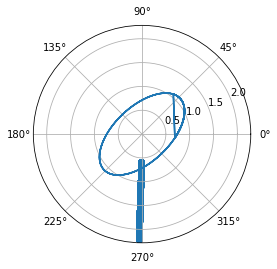

 75%|███████▌  | 750/1000 [04:14<01:25,  2.93it/s]

0.6952719824925132


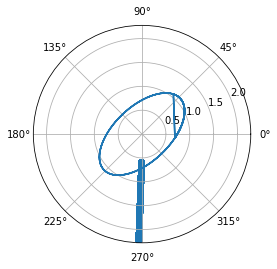

 75%|███████▌  | 751/1000 [04:15<01:24,  2.95it/s]

0.693059322780948


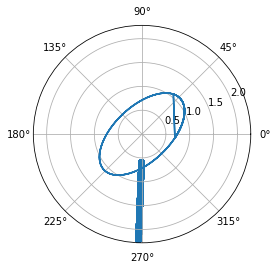

 75%|███████▌  | 752/1000 [04:15<01:22,  3.02it/s]

0.6908414551975702


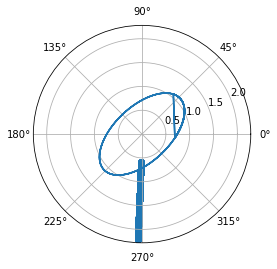

 75%|███████▌  | 753/1000 [04:15<01:21,  3.04it/s]

0.6886182319964177


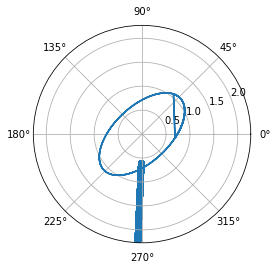

 75%|███████▌  | 754/1000 [04:16<01:19,  3.09it/s]

0.686389762208655


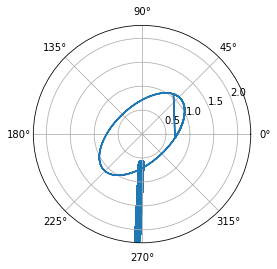

 76%|███████▌  | 755/1000 [04:16<01:20,  3.04it/s]

0.6841559135305791


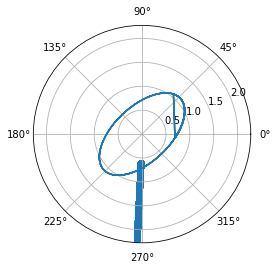

 76%|███████▌  | 756/1000 [04:16<01:23,  2.94it/s]

0.6819167808812521


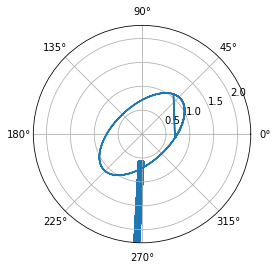

 76%|███████▌  | 757/1000 [04:17<01:21,  2.98it/s]

0.6796722473488371


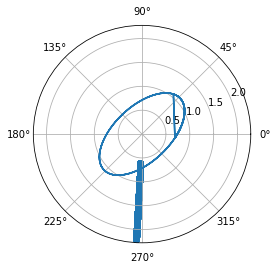

 76%|███████▌  | 758/1000 [04:17<01:20,  3.01it/s]

0.6774223937684829


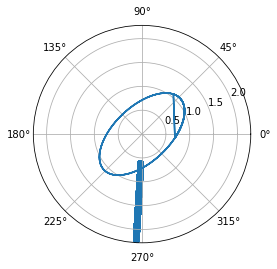

 76%|███████▌  | 759/1000 [04:17<01:20,  2.98it/s]

0.6751671187594713


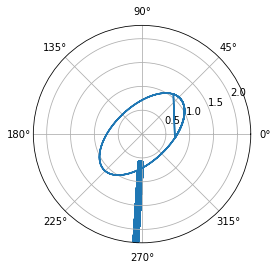

 76%|███████▌  | 760/1000 [04:18<01:18,  3.05it/s]

0.6729064889063026


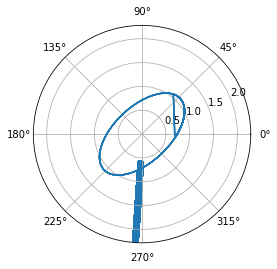

 76%|███████▌  | 761/1000 [04:18<01:17,  3.09it/s]

0.6706404187041834


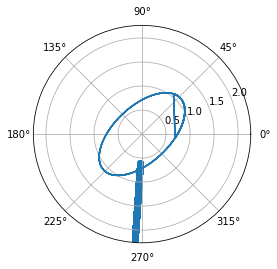

 76%|███████▌  | 762/1000 [04:18<01:18,  3.01it/s]

0.6683689601093874


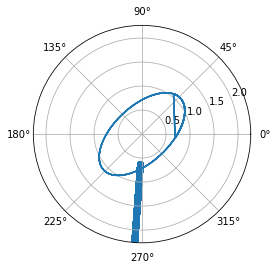

 76%|███████▋  | 763/1000 [04:19<01:19,  2.99it/s]

0.6660920440594468


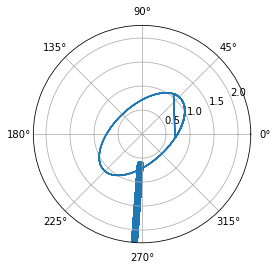

 76%|███████▋  | 764/1000 [04:19<01:18,  3.00it/s]

0.6638097072779854


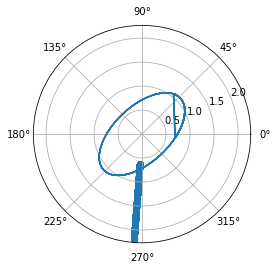

 76%|███████▋  | 765/1000 [04:19<01:16,  3.05it/s]

0.6615218979489643


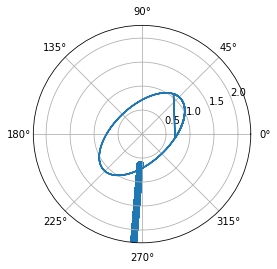

 77%|███████▋  | 766/1000 [04:20<01:18,  2.97it/s]

0.6592286367160372


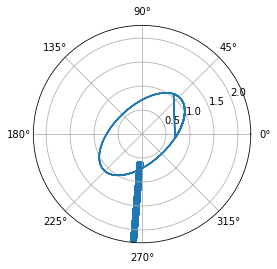

 77%|███████▋  | 767/1000 [04:20<01:18,  2.98it/s]

0.6569298900675122


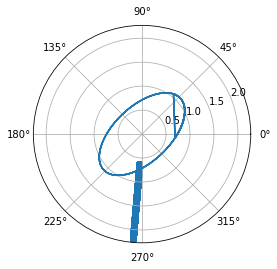

 77%|███████▋  | 768/1000 [04:20<01:20,  2.87it/s]

0.6546256614608573


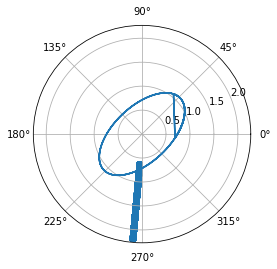

 77%|███████▋  | 769/1000 [04:21<01:19,  2.91it/s]

0.6523159370164647


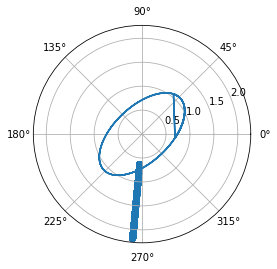

 77%|███████▋  | 770/1000 [04:21<01:15,  3.04it/s]

0.650000701624663


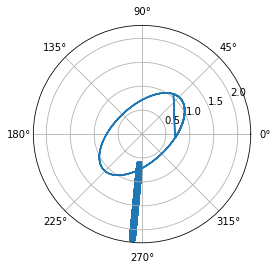

 77%|███████▋  | 771/1000 [04:21<01:11,  3.19it/s]

0.6476799626512956


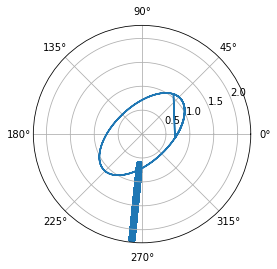

 77%|███████▋  | 772/1000 [04:21<01:09,  3.26it/s]

0.6453536847482436


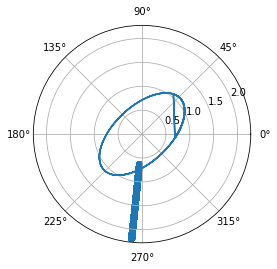

 77%|███████▋  | 773/1000 [04:22<01:12,  3.15it/s]

0.6430218984413136


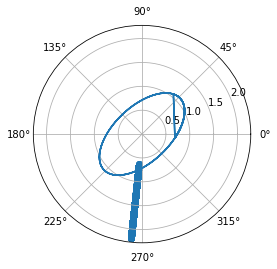

 77%|███████▋  | 774/1000 [04:22<01:17,  2.93it/s]

0.6406845461670448


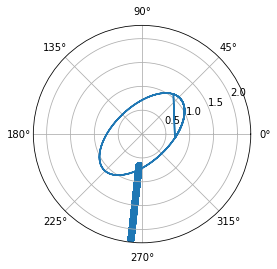

 78%|███████▊  | 775/1000 [04:23<01:17,  2.92it/s]

0.6383416838419336


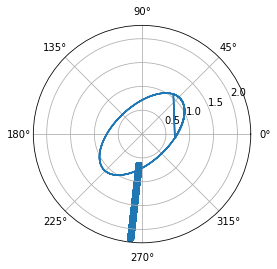

 78%|███████▊  | 776/1000 [04:23<01:15,  2.95it/s]

0.6359932293899496


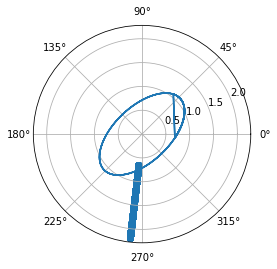

 78%|███████▊  | 777/1000 [04:23<01:16,  2.92it/s]

0.6336392666797248


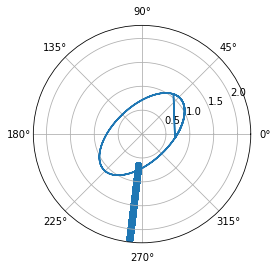

 78%|███████▊  | 778/1000 [04:24<01:14,  2.98it/s]

0.6312796864910076


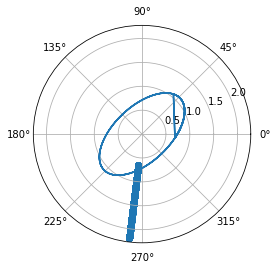

 78%|███████▊  | 779/1000 [04:24<01:13,  3.00it/s]

0.6289146035504923


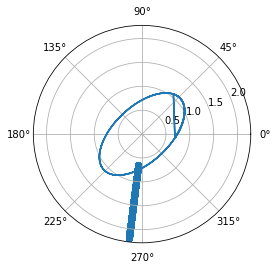

 78%|███████▊  | 780/1000 [04:24<01:14,  2.97it/s]

0.6265438785143632


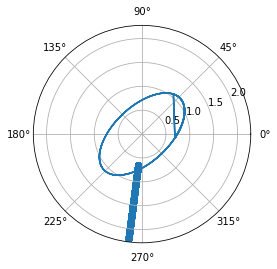

 78%|███████▊  | 781/1000 [04:25<01:11,  3.05it/s]

0.6241676602306339


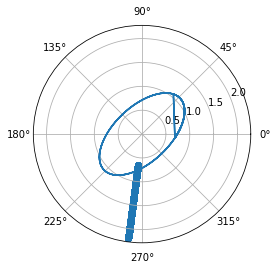

 78%|███████▊  | 782/1000 [04:25<01:11,  3.06it/s]

0.6217857758926199


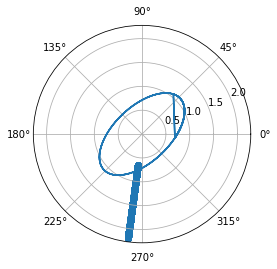

 78%|███████▊  | 783/1000 [04:25<01:12,  2.98it/s]

0.6193984121019686


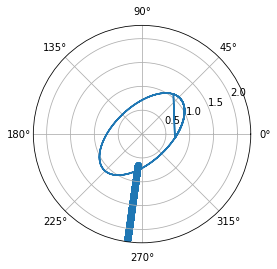

 78%|███████▊  | 784/1000 [04:26<01:13,  2.93it/s]

0.6170053588788285


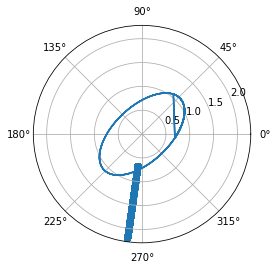

 78%|███████▊  | 785/1000 [04:26<01:12,  2.95it/s]

0.6146068291408334


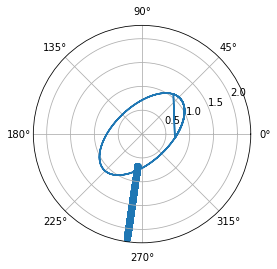

 79%|███████▊  | 786/1000 [04:26<01:10,  3.05it/s]

0.6122026179923008


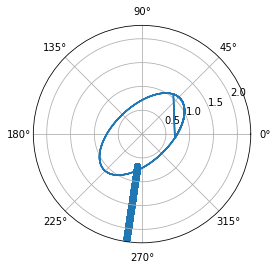

 79%|███████▊  | 787/1000 [04:27<01:09,  3.06it/s]

0.6097929141657106


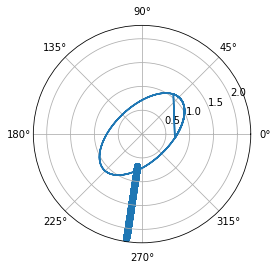

 79%|███████▉  | 788/1000 [04:27<01:07,  3.14it/s]

0.6073775544783803


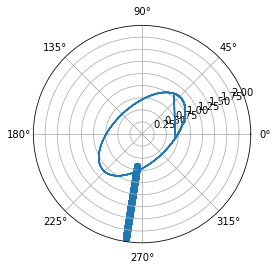

 79%|███████▉  | 789/1000 [04:27<01:07,  3.12it/s]

0.6049566800533523


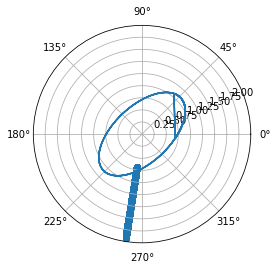

 79%|███████▉  | 790/1000 [04:27<01:06,  3.15it/s]

0.6025301807822758


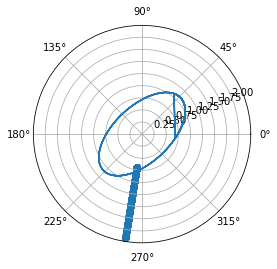

 79%|███████▉  | 791/1000 [04:28<01:08,  3.06it/s]

0.6000981449285094


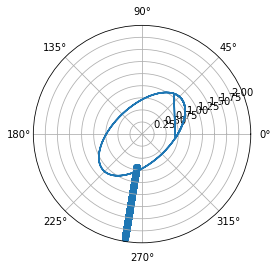

 79%|███████▉  | 792/1000 [04:28<01:12,  2.89it/s]

0.597660521037031


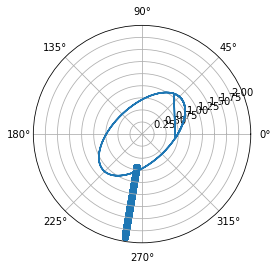

 79%|███████▉  | 793/1000 [04:29<01:13,  2.82it/s]

0.5952173388528817


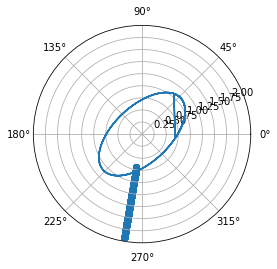

 79%|███████▉  | 794/1000 [04:29<01:13,  2.80it/s]

0.5927686115656183


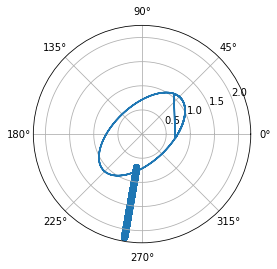

 80%|███████▉  | 795/1000 [04:29<01:10,  2.90it/s]

0.5903143043350637


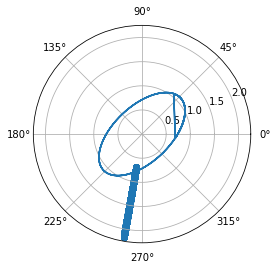

 80%|███████▉  | 796/1000 [04:30<01:07,  3.01it/s]

0.5878545013971017


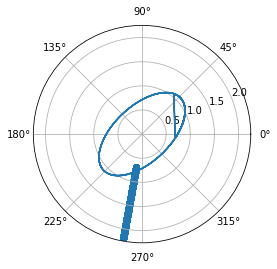

 80%|███████▉  | 797/1000 [04:30<01:05,  3.11it/s]

0.585389096854629


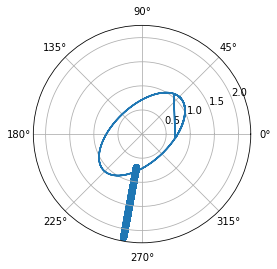

 80%|███████▉  | 798/1000 [04:30<01:05,  3.11it/s]

0.5829182527967297


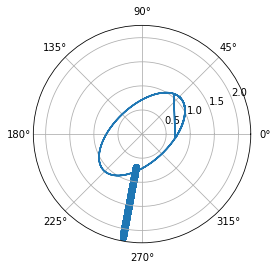

 80%|███████▉  | 799/1000 [04:30<01:03,  3.18it/s]

0.5804417854001745


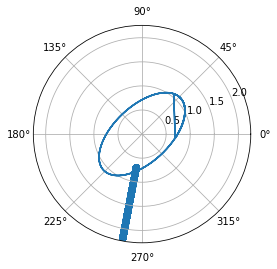

 80%|████████  | 800/1000 [04:31<01:02,  3.22it/s]

0.5779599057761743


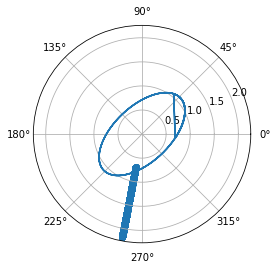

 80%|████████  | 801/1000 [04:31<01:00,  3.28it/s]

0.5754724530210514


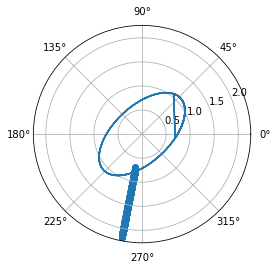

 80%|████████  | 802/1000 [04:31<01:02,  3.17it/s]

0.5729795742204017


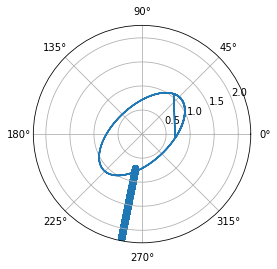

 80%|████████  | 803/1000 [04:32<01:00,  3.26it/s]

0.5704811973924242


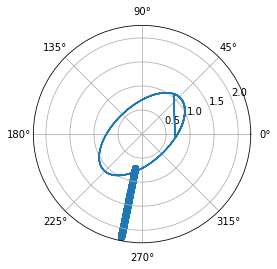

 80%|████████  | 804/1000 [04:32<01:01,  3.21it/s]

0.5679773718180858


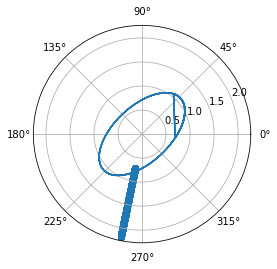

 80%|████████  | 805/1000 [04:32<01:00,  3.22it/s]

0.5654681313931235


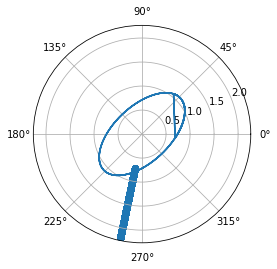

 81%|████████  | 806/1000 [04:33<01:01,  3.14it/s]

0.5629534191883763


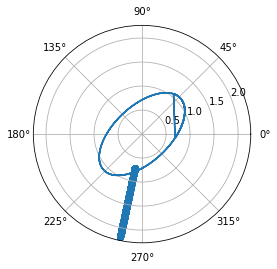

 81%|████████  | 807/1000 [04:33<01:00,  3.17it/s]

0.5604333836956457


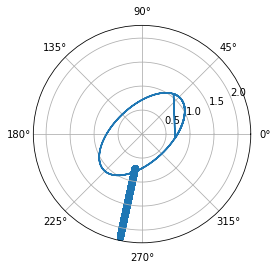

 81%|████████  | 808/1000 [04:33<00:59,  3.22it/s]

0.5579078530526741


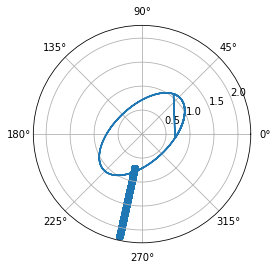

 81%|████████  | 809/1000 [04:34<00:59,  3.20it/s]

0.5553770388906839


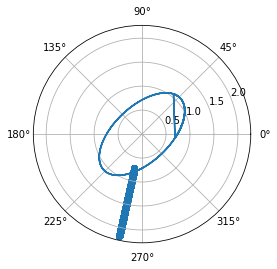

 81%|████████  | 810/1000 [04:34<01:04,  2.96it/s]

0.5528408268433457


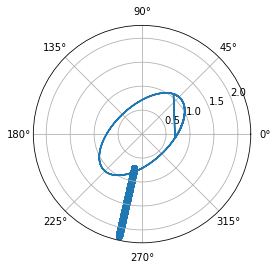

 81%|████████  | 811/1000 [04:34<01:02,  3.03it/s]

0.5502993105672318


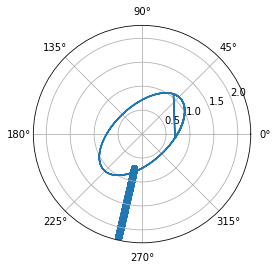

 81%|████████  | 812/1000 [04:35<01:00,  3.11it/s]

0.5477525113223506


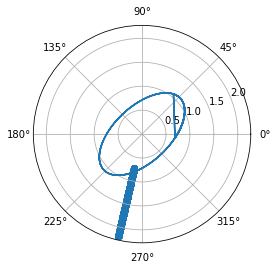

 81%|████████▏ | 813/1000 [04:35<01:00,  3.10it/s]

0.5452003825384393


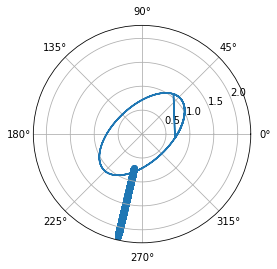

 81%|████████▏ | 814/1000 [04:35<01:00,  3.07it/s]

0.5426430766713155


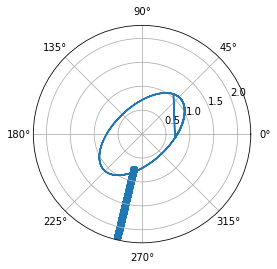

 82%|████████▏ | 815/1000 [04:36<00:59,  3.13it/s]

0.5400804527114516


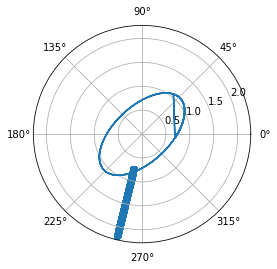

 82%|████████▏ | 816/1000 [04:36<00:58,  3.16it/s]

0.5375126840376371


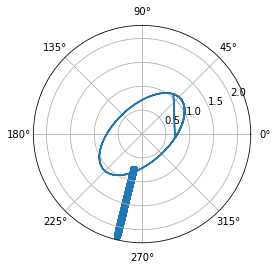

 82%|████████▏ | 817/1000 [04:36<00:57,  3.18it/s]

0.5349397379240685


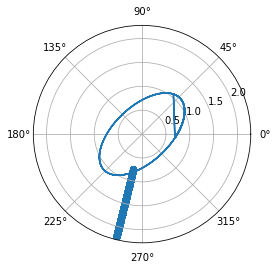

 82%|████████▏ | 818/1000 [04:36<00:55,  3.27it/s]

0.5323616195622105


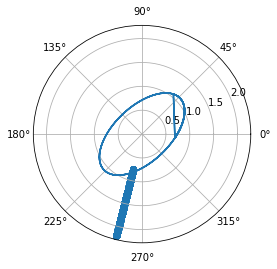

 82%|████████▏ | 819/1000 [04:37<00:53,  3.38it/s]

0.5297784589932061


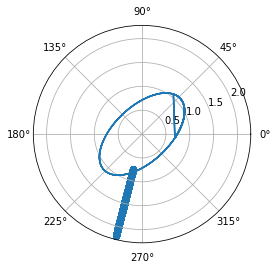

 82%|████████▏ | 820/1000 [04:37<00:52,  3.41it/s]

0.5271901297117938


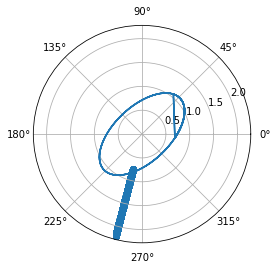

 82%|████████▏ | 821/1000 [04:37<00:53,  3.33it/s]

0.5245968057783265


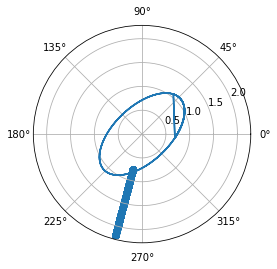

 82%|████████▏ | 822/1000 [04:38<00:52,  3.37it/s]

0.5219984815262173


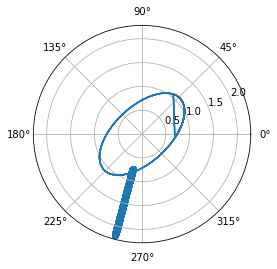

 82%|████████▏ | 823/1000 [04:38<00:52,  3.39it/s]

0.51939513306372


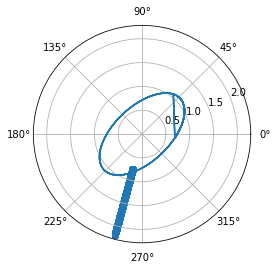

 82%|████████▏ | 824/1000 [04:38<00:52,  3.38it/s]

0.5167869085207725


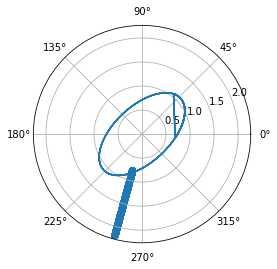

 82%|████████▎ | 825/1000 [04:39<00:52,  3.32it/s]

0.5141737400612092


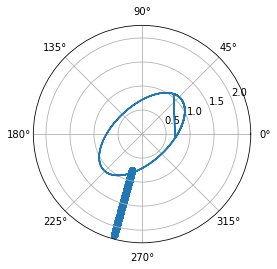

 83%|████████▎ | 826/1000 [04:39<00:52,  3.31it/s]

0.5115557173408181


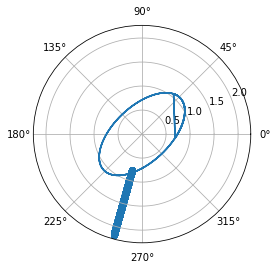

 83%|████████▎ | 827/1000 [04:39<00:52,  3.27it/s]

0.5089329337235966


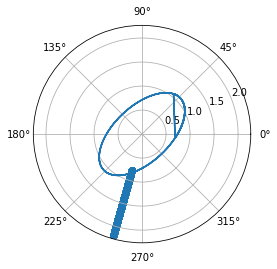

 83%|████████▎ | 828/1000 [04:40<00:55,  3.10it/s]

0.5063052941397004


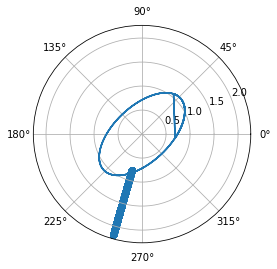

 83%|████████▎ | 829/1000 [04:40<00:58,  2.95it/s]

0.5036729643452158


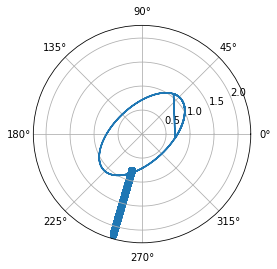

 83%|████████▎ | 830/1000 [04:40<00:59,  2.88it/s]

0.5010359950607479


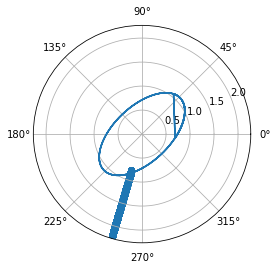

 83%|████████▎ | 831/1000 [04:41<00:57,  2.94it/s]

0.49839430382380434


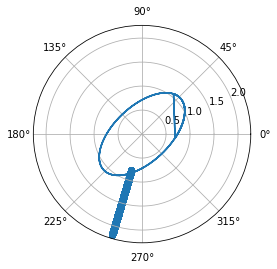

 83%|████████▎ | 832/1000 [04:41<00:56,  3.00it/s]

0.49574807396989784


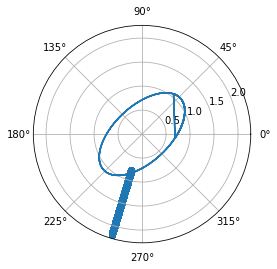

 83%|████████▎ | 833/1000 [04:41<00:59,  2.81it/s]

0.49309734453250803


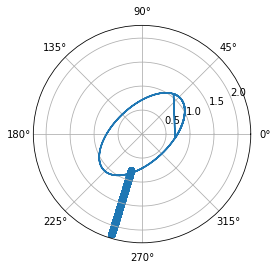

 83%|████████▎ | 834/1000 [04:42<00:58,  2.84it/s]

0.4904420509426821


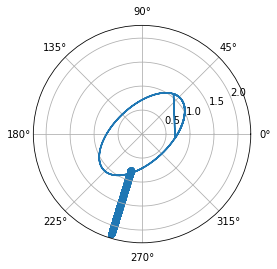

 84%|████████▎ | 835/1000 [04:42<00:57,  2.86it/s]

0.4877823698780961


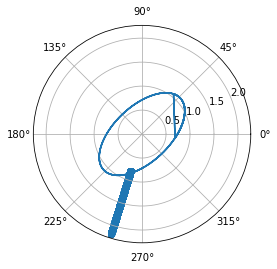

 84%|████████▎ | 836/1000 [04:42<00:57,  2.85it/s]

0.485118353502077


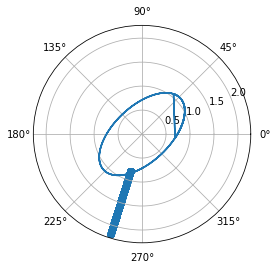

 84%|████████▎ | 837/1000 [04:43<00:54,  2.96it/s]

0.4824499447280981


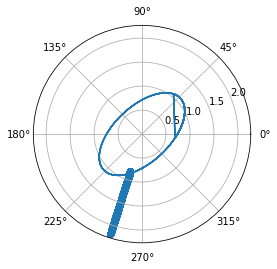

 84%|████████▍ | 838/1000 [04:43<00:52,  3.06it/s]

0.4797773051498321


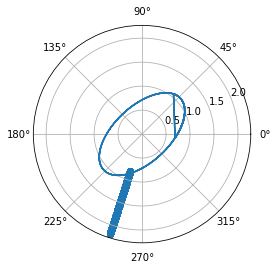

 84%|████████▍ | 839/1000 [04:43<00:51,  3.15it/s]

0.4771005011347736


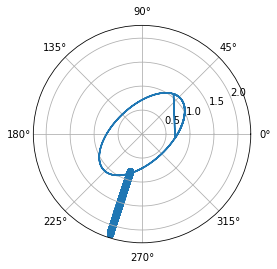

 84%|████████▍ | 840/1000 [04:44<00:50,  3.17it/s]

0.47441952735906


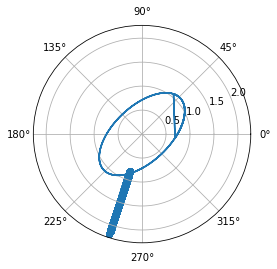

 84%|████████▍ | 841/1000 [04:44<00:49,  3.22it/s]

0.4717344678144356


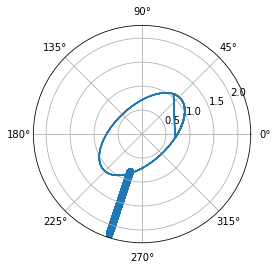

 84%|████████▍ | 842/1000 [04:44<00:49,  3.21it/s]

0.4690454303984629


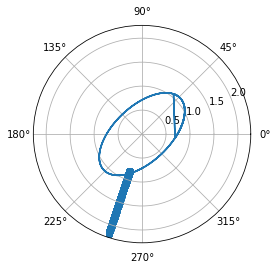

 84%|████████▍ | 843/1000 [04:45<00:53,  2.93it/s]

0.46635247929740653


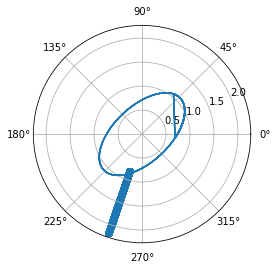

 84%|████████▍ | 844/1000 [04:45<00:51,  3.02it/s]

0.4636555861641491


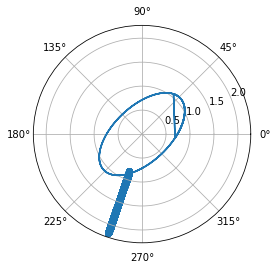

 84%|████████▍ | 845/1000 [04:45<00:50,  3.10it/s]

0.46095491809964867


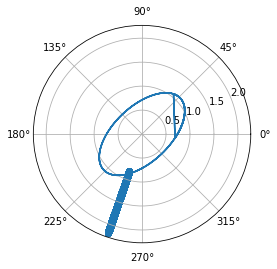

 85%|████████▍ | 846/1000 [04:46<00:54,  2.80it/s]

0.45825054489550215


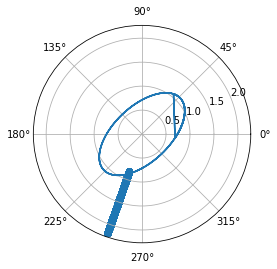

 85%|████████▍ | 847/1000 [04:46<00:53,  2.85it/s]

0.45554253371397974


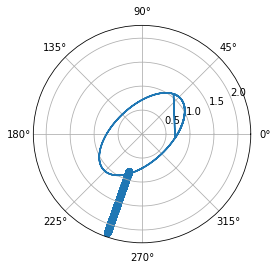

 85%|████████▍ | 848/1000 [04:46<00:52,  2.91it/s]

0.45283088812531275


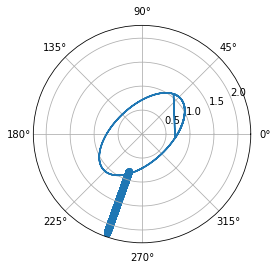

 85%|████████▍ | 849/1000 [04:47<00:50,  2.97it/s]

0.4501157632667617


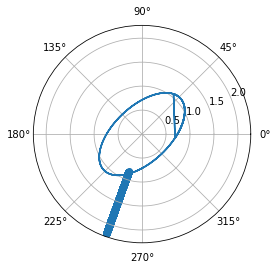

 85%|████████▌ | 850/1000 [04:47<00:49,  3.01it/s]

0.4473972367181894


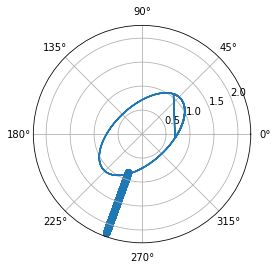

 85%|████████▌ | 851/1000 [04:47<00:49,  2.99it/s]

0.44467538806846946


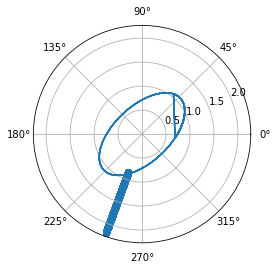

 85%|████████▌ | 852/1000 [04:48<00:49,  3.01it/s]

0.4419502623815877


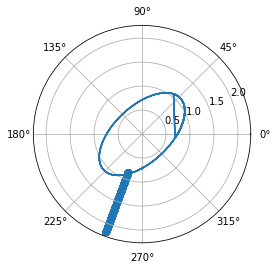

 85%|████████▌ | 853/1000 [04:48<00:49,  2.99it/s]

0.4392219573281974


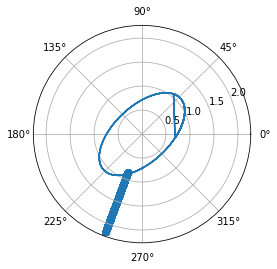

 85%|████████▌ | 854/1000 [04:48<00:49,  2.94it/s]

0.436490586389249


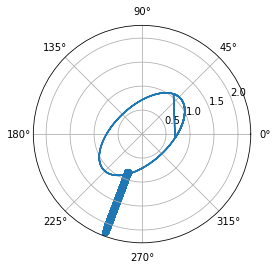

 86%|████████▌ | 855/1000 [04:49<00:47,  3.03it/s]

0.43375623750954856


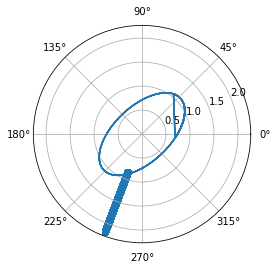

 86%|████████▌ | 856/1000 [04:49<00:45,  3.16it/s]

0.4310190007858168


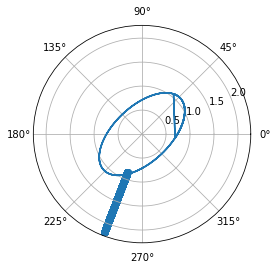

 86%|████████▌ | 857/1000 [04:49<00:46,  3.08it/s]

0.42827896076194766


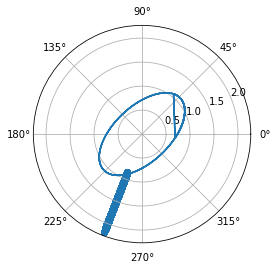

 86%|████████▌ | 858/1000 [04:50<00:47,  3.02it/s]

0.42553618631035417


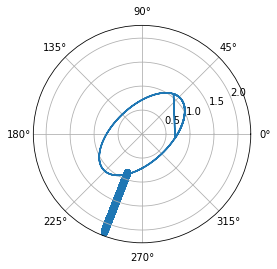

 86%|████████▌ | 859/1000 [04:50<00:46,  3.03it/s]

0.42279081230476406


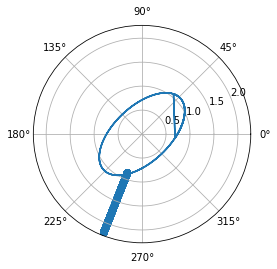

 86%|████████▌ | 860/1000 [04:50<00:44,  3.12it/s]

0.4200429376909987


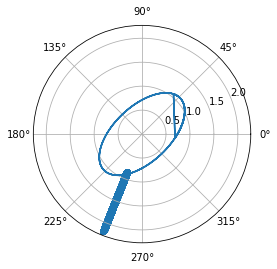

 86%|████████▌ | 861/1000 [04:51<00:43,  3.18it/s]

0.4172926636959275


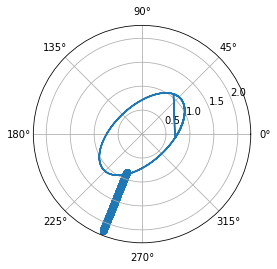

 86%|████████▌ | 862/1000 [04:51<00:44,  3.08it/s]

0.4145400938534992


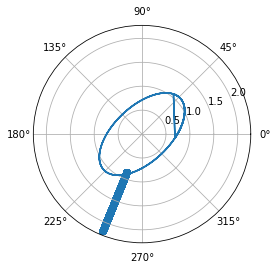

 86%|████████▋ | 863/1000 [04:51<00:43,  3.13it/s]

0.41178533402999407


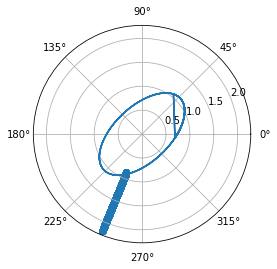

 86%|████████▋ | 864/1000 [04:52<00:46,  2.94it/s]

0.4090284924483957


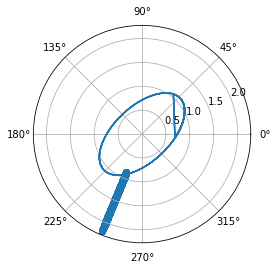

 86%|████████▋ | 865/1000 [04:52<00:49,  2.75it/s]

0.40626967243238477


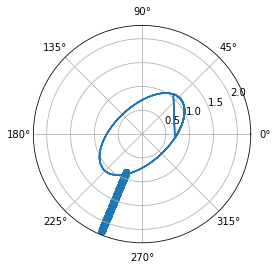

 87%|████████▋ | 866/1000 [04:53<00:56,  2.36it/s]

0.40350898639463845


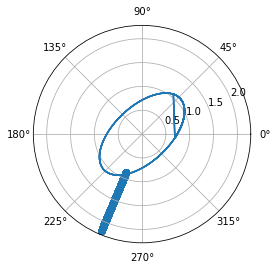

 87%|████████▋ | 867/1000 [04:53<00:52,  2.54it/s]

0.40074656120288793


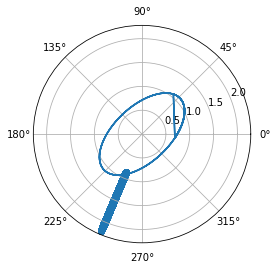

 87%|████████▋ | 868/1000 [04:53<00:49,  2.67it/s]

0.39798251451859223


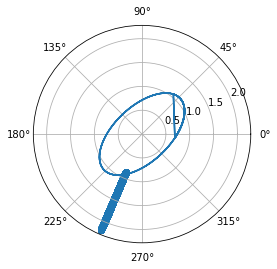

 87%|████████▋ | 869/1000 [04:53<00:45,  2.87it/s]

0.39521696643821913


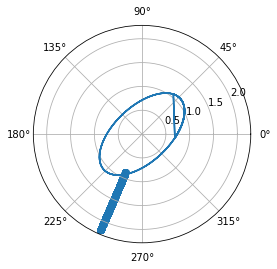

 87%|████████▋ | 870/1000 [04:54<00:44,  2.94it/s]

0.39245003950740015


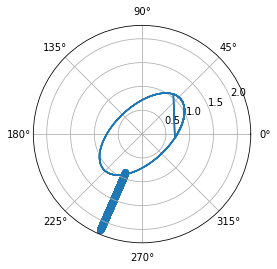

 87%|████████▋ | 871/1000 [04:54<00:44,  2.92it/s]

0.38968185873292704


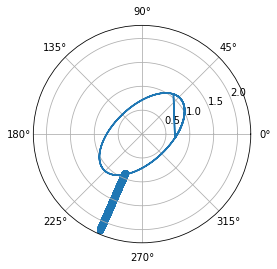

 87%|████████▋ | 872/1000 [04:55<00:46,  2.77it/s]

0.386912551592353


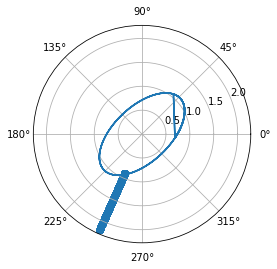

 87%|████████▋ | 873/1000 [04:55<00:42,  2.96it/s]

0.384142248040938


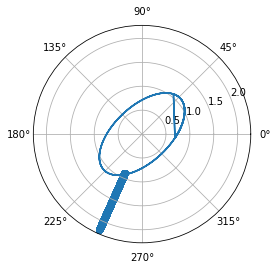

 87%|████████▋ | 874/1000 [04:55<00:40,  3.10it/s]

0.38137108051564744


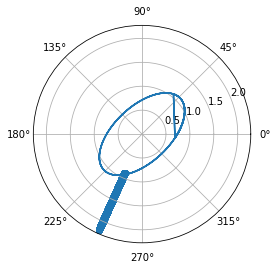

 88%|████████▊ | 875/1000 [04:55<00:39,  3.16it/s]

0.3785991839358977


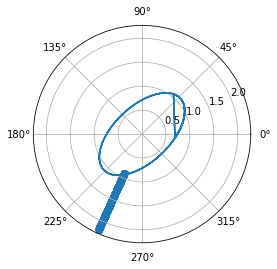

 88%|████████▊ | 876/1000 [04:56<00:38,  3.20it/s]

0.37582669570069976


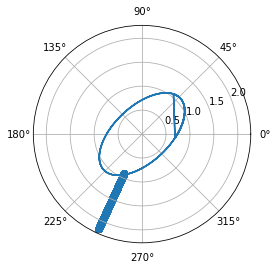

 88%|████████▊ | 877/1000 [04:56<00:37,  3.26it/s]

0.37305375568182825


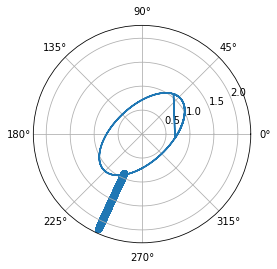

 88%|████████▊ | 878/1000 [04:56<00:39,  3.07it/s]

0.370280506212597


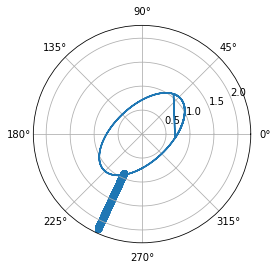

 88%|████████▊ | 879/1000 [04:57<00:40,  2.98it/s]

0.3675070920717961


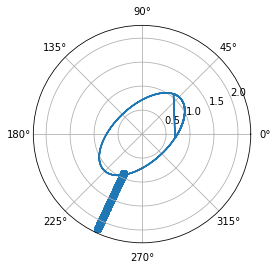

 88%|████████▊ | 880/1000 [04:57<00:38,  3.08it/s]

0.36473366046227945


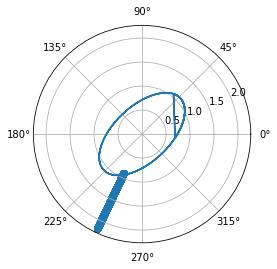

 88%|████████▊ | 881/1000 [04:57<00:37,  3.16it/s]

0.361960360983666


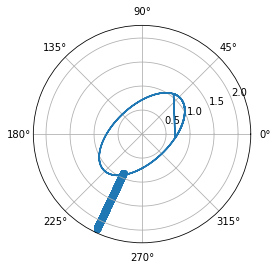

 88%|████████▊ | 882/1000 [04:58<00:39,  2.95it/s]

0.3591873455985412


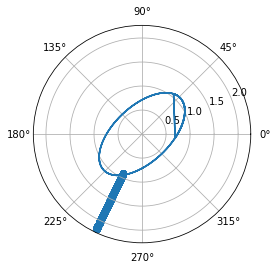

 88%|████████▊ | 883/1000 [04:58<00:43,  2.66it/s]

0.3564147716596363


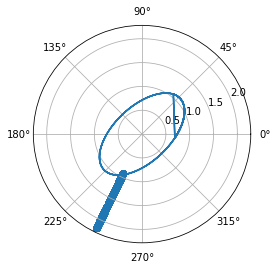

 88%|████████▊ | 884/1000 [04:59<00:41,  2.80it/s]

0.3536428007995147


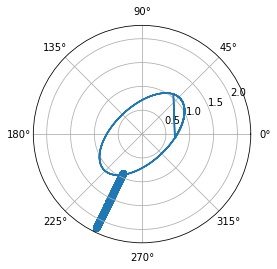

 88%|████████▊ | 885/1000 [04:59<00:39,  2.89it/s]

0.3508715898822034


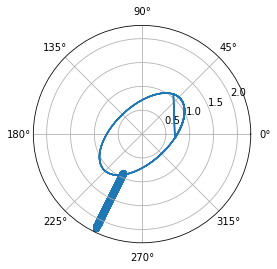

 89%|████████▊ | 886/1000 [04:59<00:42,  2.68it/s]

0.34810130095373665


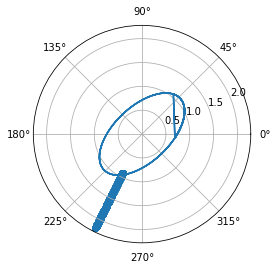

 89%|████████▊ | 887/1000 [05:00<00:42,  2.66it/s]

0.3453320982262979


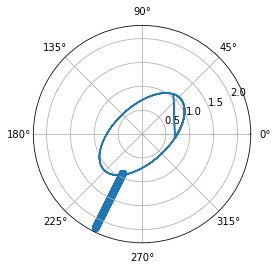

 89%|████████▉ | 888/1000 [05:00<00:40,  2.74it/s]

0.3425641479963586


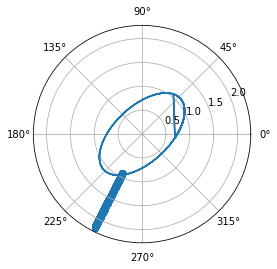

 89%|████████▉ | 889/1000 [05:00<00:38,  2.89it/s]

0.33979761855058


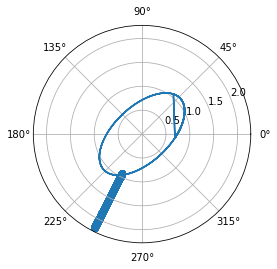

 89%|████████▉ | 890/1000 [05:01<00:38,  2.86it/s]

0.3370326993770178


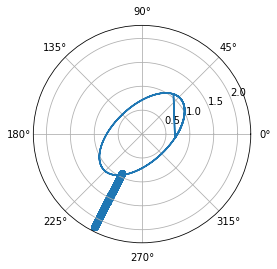

 89%|████████▉ | 891/1000 [05:01<00:37,  2.92it/s]

0.33426957670951163


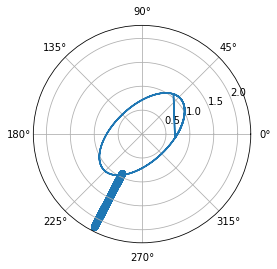

 89%|████████▉ | 892/1000 [05:01<00:35,  3.02it/s]

0.33150840547191535


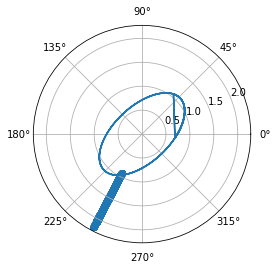

 89%|████████▉ | 893/1000 [05:02<00:36,  2.96it/s]

0.3287493625717171


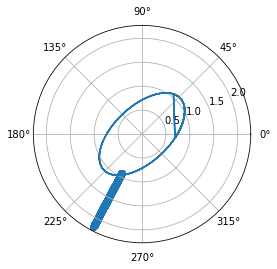

 89%|████████▉ | 894/1000 [05:02<00:36,  2.90it/s]

0.3259926263613158


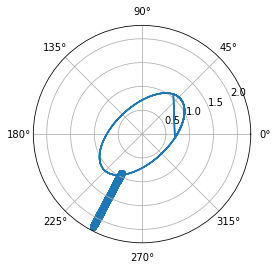

 90%|████████▉ | 895/1000 [05:02<00:36,  2.89it/s]

0.323238454817828


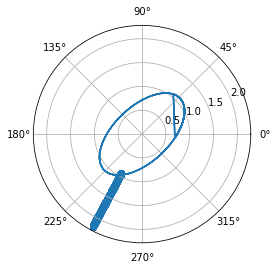

 90%|████████▉ | 896/1000 [05:03<00:35,  2.91it/s]

0.3204869842544015


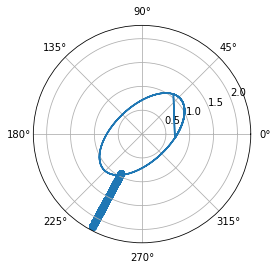

 90%|████████▉ | 897/1000 [05:03<00:35,  2.89it/s]

0.31773838647898267


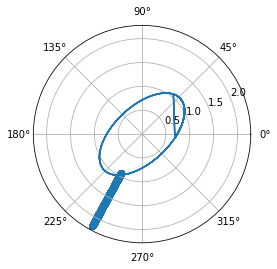

 90%|████████▉ | 898/1000 [05:03<00:34,  2.99it/s]

0.31499287174752555


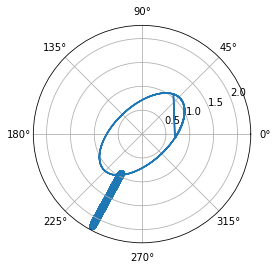

 90%|████████▉ | 899/1000 [05:04<00:33,  3.06it/s]

0.3122507271280568


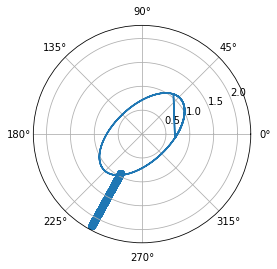

 90%|█████████ | 900/1000 [05:04<00:38,  2.59it/s]

0.30951204169891355


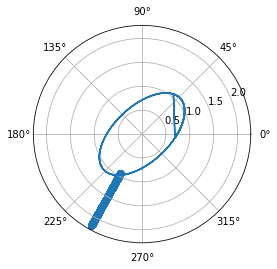

 90%|█████████ | 901/1000 [05:05<00:37,  2.65it/s]

0.3067770159125406


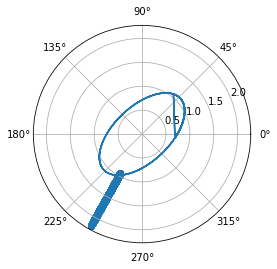

 90%|█████████ | 902/1000 [05:05<00:34,  2.85it/s]

0.3040460239132749


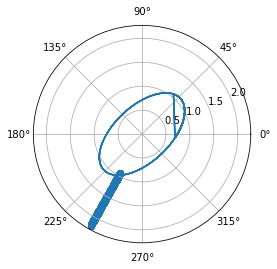

 90%|█████████ | 903/1000 [05:05<00:32,  2.96it/s]

0.30131909480445074


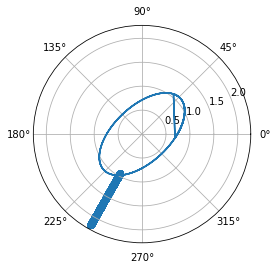

 90%|█████████ | 904/1000 [05:05<00:31,  3.04it/s]

0.29859649578613456


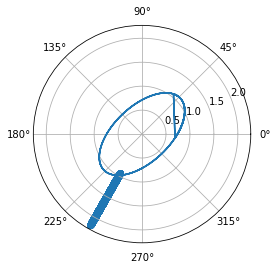

 90%|█████████ | 905/1000 [05:06<00:30,  3.13it/s]

0.29587854976984945


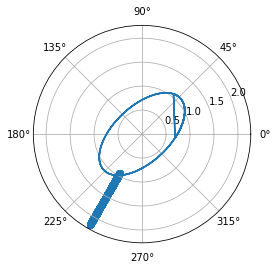

 91%|█████████ | 906/1000 [05:06<00:31,  3.02it/s]

0.2931652832548646


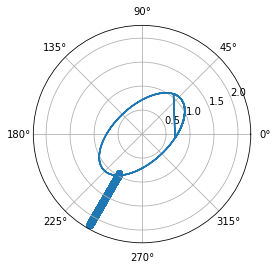

 91%|█████████ | 907/1000 [05:06<00:32,  2.88it/s]

0.2904571565045125


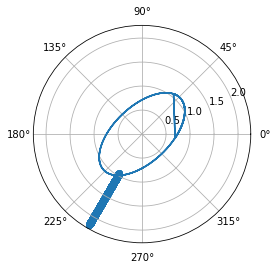

 91%|█████████ | 908/1000 [05:07<00:30,  3.01it/s]

0.28775420657535733


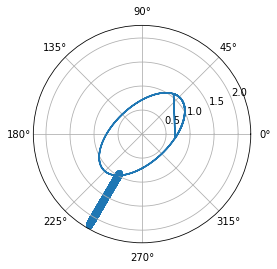

 91%|█████████ | 909/1000 [05:07<00:31,  2.92it/s]

0.2850567617072498


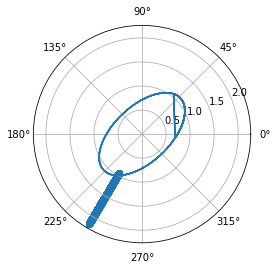

 91%|█████████ | 910/1000 [05:07<00:29,  3.04it/s]

0.2823650586053595


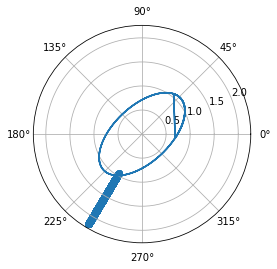

 91%|█████████ | 911/1000 [05:08<00:29,  3.05it/s]

0.27967927075350735


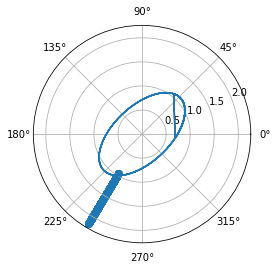

 91%|█████████ | 912/1000 [05:08<00:28,  3.08it/s]

0.2769997659835287


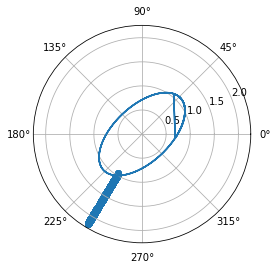

 91%|█████████▏| 913/1000 [05:08<00:29,  2.96it/s]

0.2743266467005304


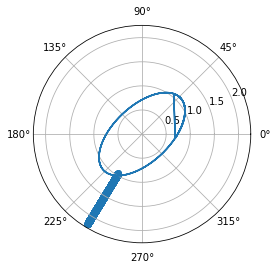

 91%|█████████▏| 914/1000 [05:09<00:28,  3.02it/s]

0.2716603108052591


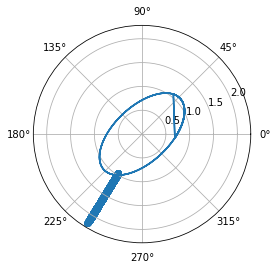

 92%|█████████▏| 915/1000 [05:09<00:28,  2.95it/s]

0.26900090852486924


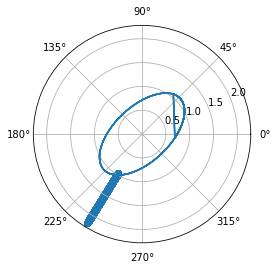

 92%|█████████▏| 916/1000 [05:09<00:27,  3.10it/s]

0.26634872812637295


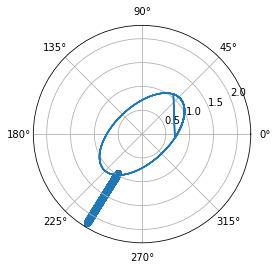

 92%|█████████▏| 917/1000 [05:10<00:26,  3.18it/s]

0.26370412836898205


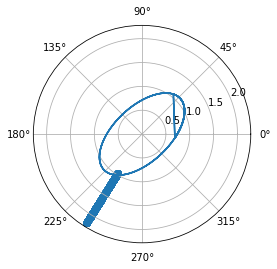

 92%|█████████▏| 918/1000 [05:10<00:26,  3.07it/s]

0.2610671022833964


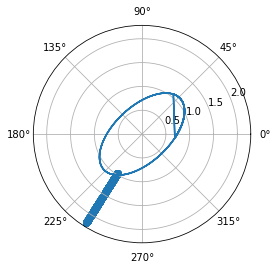

 92%|█████████▏| 919/1000 [05:10<00:26,  3.07it/s]

0.2584384275084257


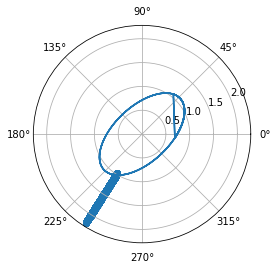

 92%|█████████▏| 920/1000 [05:11<00:25,  3.13it/s]

0.2558178664230162


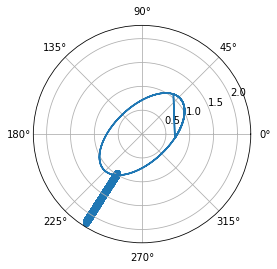

 92%|█████████▏| 921/1000 [05:11<00:25,  3.15it/s]

0.2532059706658967


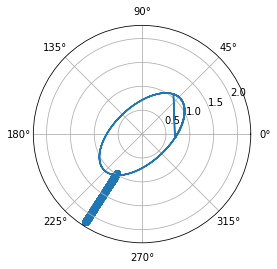

 92%|█████████▏| 922/1000 [05:11<00:24,  3.15it/s]

0.25060309164012706


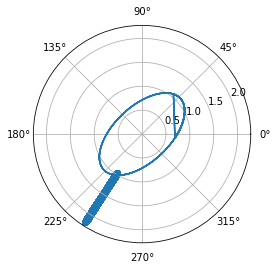

 92%|█████████▏| 923/1000 [05:12<00:24,  3.19it/s]

0.24800922310505685


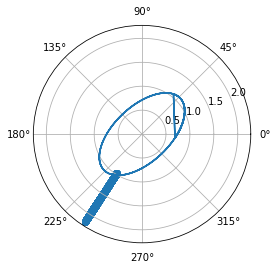

 92%|█████████▏| 924/1000 [05:12<00:23,  3.26it/s]

0.2454249783339


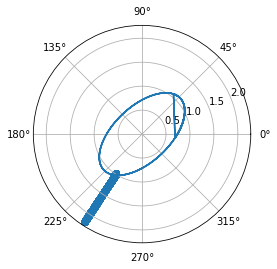

 92%|█████████▎| 925/1000 [05:12<00:23,  3.17it/s]

0.242850644175222


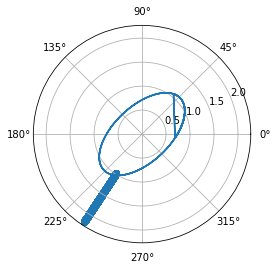

 93%|█████████▎| 926/1000 [05:13<00:24,  3.06it/s]

0.24028627518401535


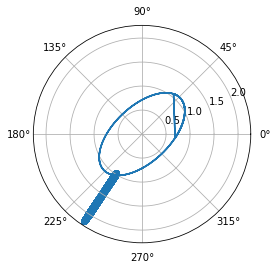

 93%|█████████▎| 927/1000 [05:13<00:24,  2.93it/s]

0.2377322586371876


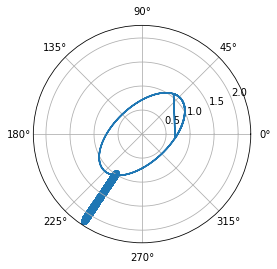

 93%|█████████▎| 928/1000 [05:13<00:23,  3.02it/s]

0.23518937093976017


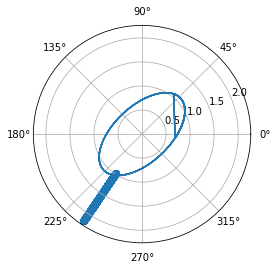

 93%|█████████▎| 929/1000 [05:14<00:22,  3.11it/s]

0.23265746345795116


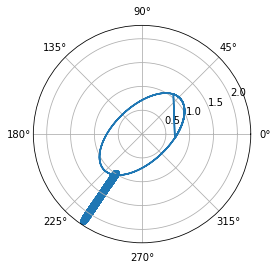

 93%|█████████▎| 930/1000 [05:14<00:22,  3.12it/s]

0.23013688622356684


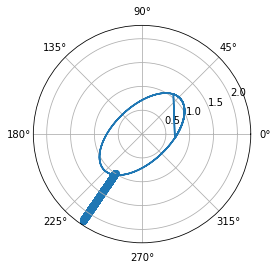

 93%|█████████▎| 931/1000 [05:14<00:21,  3.21it/s]

0.22762799774678086


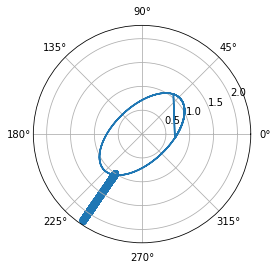

 93%|█████████▎| 932/1000 [05:15<00:20,  3.25it/s]

0.22513155926346823


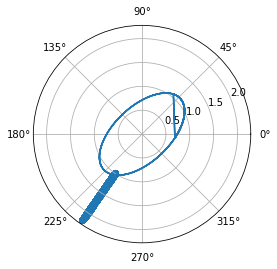

 93%|█████████▎| 933/1000 [05:15<00:19,  3.38it/s]

0.2226476587502508


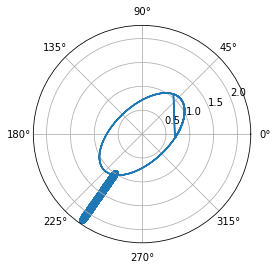

 93%|█████████▎| 934/1000 [05:15<00:19,  3.37it/s]

0.2201765725916953


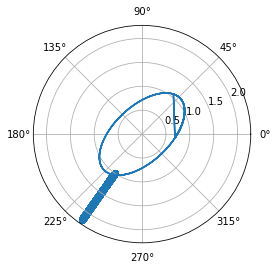

 94%|█████████▎| 935/1000 [05:15<00:19,  3.29it/s]

0.21771869322674597


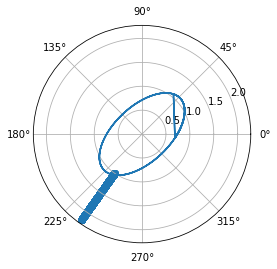

 94%|█████████▎| 936/1000 [05:16<00:20,  3.08it/s]

0.21527442264137286


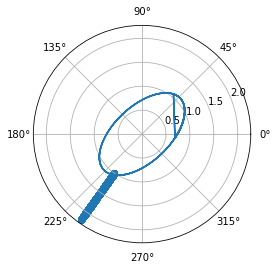

 94%|█████████▎| 937/1000 [05:16<00:20,  3.06it/s]

0.21284417261703079


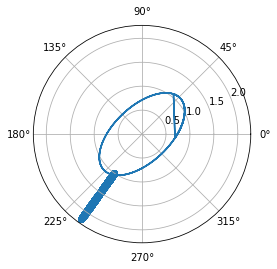

 94%|█████████▍| 938/1000 [05:16<00:20,  2.97it/s]

0.2104283649756508


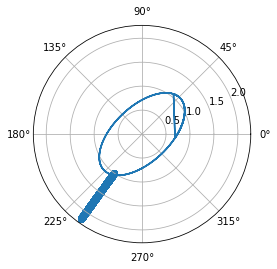

 94%|█████████▍| 939/1000 [05:17<00:19,  3.07it/s]

0.2080276780780651


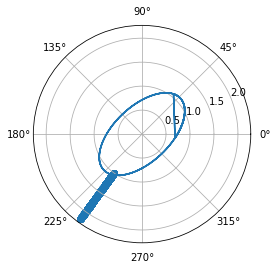

 94%|█████████▍| 940/1000 [05:17<00:19,  3.08it/s]

0.2056423307756718


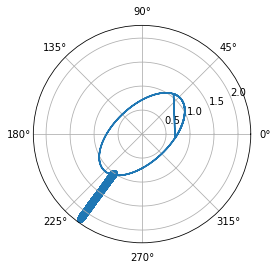

 94%|█████████▍| 941/1000 [05:17<00:19,  2.99it/s]

0.20327271813339948


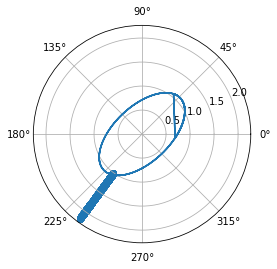

 94%|█████████▍| 942/1000 [05:18<00:19,  2.93it/s]

0.200919298843965


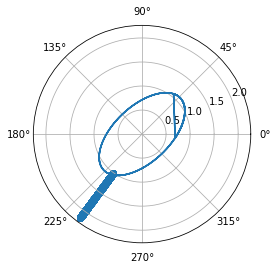

 94%|█████████▍| 943/1000 [05:18<00:18,  3.06it/s]

0.198582542171693


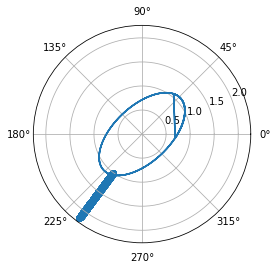

 94%|█████████▍| 944/1000 [05:18<00:17,  3.21it/s]

0.1962629280565342


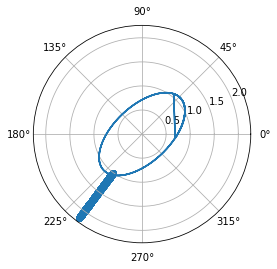

 94%|█████████▍| 945/1000 [05:19<00:17,  3.20it/s]

0.1939609471819923


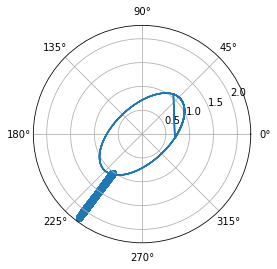

 95%|█████████▍| 946/1000 [05:19<00:16,  3.32it/s]

0.1916771010000067


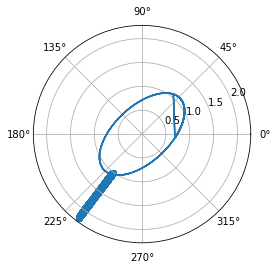

 95%|█████████▍| 947/1000 [05:19<00:15,  3.35it/s]

0.1894119017052456


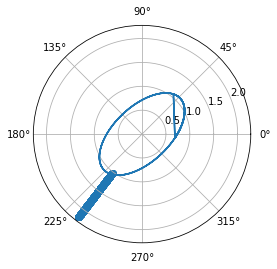

 95%|█████████▍| 948/1000 [05:20<00:16,  3.24it/s]

0.18716587215045322


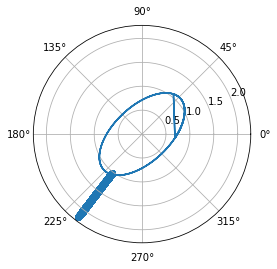

 95%|█████████▍| 949/1000 [05:20<00:17,  2.92it/s]

0.18493954569361817


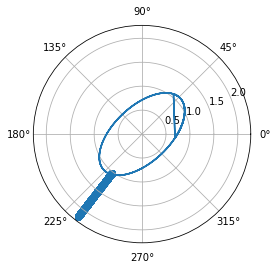

 95%|█████████▌| 950/1000 [05:20<00:16,  3.00it/s]

0.1827334659671783


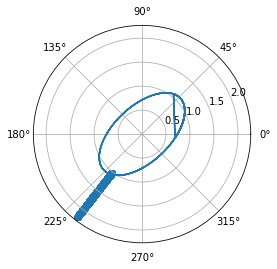

 95%|█████████▌| 951/1000 [05:21<00:17,  2.88it/s]

0.18054861777389578


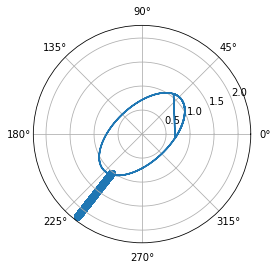

 95%|█████████▌| 952/1000 [05:21<00:17,  2.68it/s]

0.17838537958081027


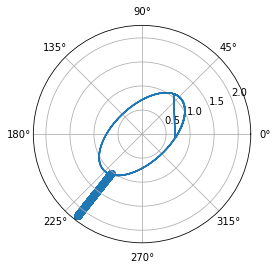

 95%|█████████▌| 953/1000 [05:21<00:16,  2.83it/s]

0.17624422946561508


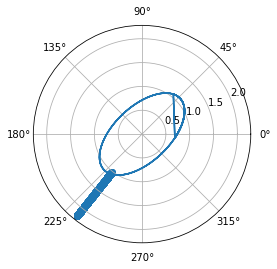

 95%|█████████▌| 954/1000 [05:22<00:17,  2.59it/s]

0.174125764579452


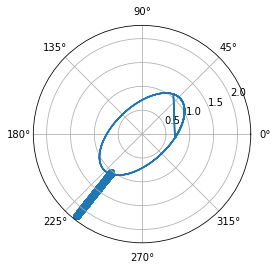

 96%|█████████▌| 955/1000 [05:22<00:18,  2.43it/s]

0.17203059114838076


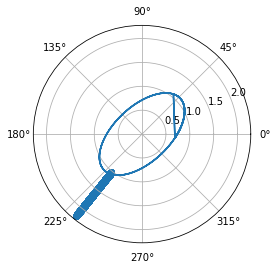

 96%|█████████▌| 956/1000 [05:23<00:17,  2.50it/s]

0.169959323650313


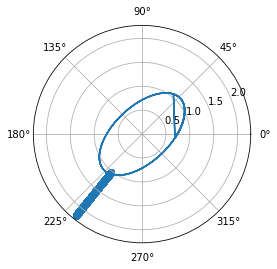

 96%|█████████▌| 957/1000 [05:23<00:15,  2.78it/s]

0.1679125838387194


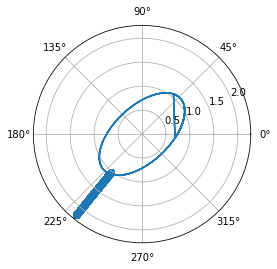

 96%|█████████▌| 958/1000 [05:23<00:14,  2.92it/s]

0.16589177362684634


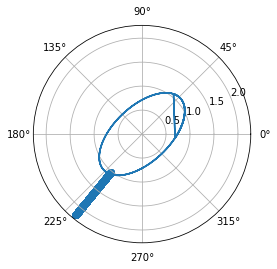

 96%|█████████▌| 959/1000 [05:24<00:13,  3.01it/s]

0.16389769331483336


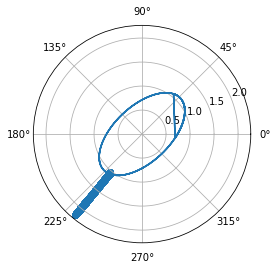

 96%|█████████▌| 960/1000 [05:24<00:12,  3.20it/s]

0.1619303137295957


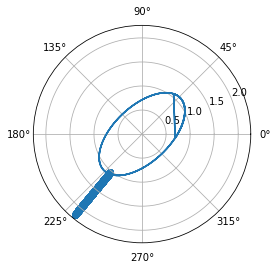

 96%|█████████▌| 961/1000 [05:24<00:12,  3.22it/s]

0.15999030018172614


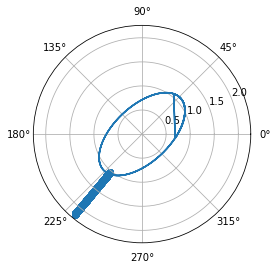

 96%|█████████▌| 962/1000 [05:25<00:12,  3.15it/s]

0.15807831991711935


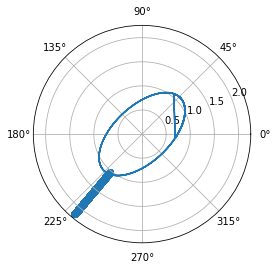

 96%|█████████▋| 963/1000 [05:25<00:12,  2.97it/s]

0.15619718848126002


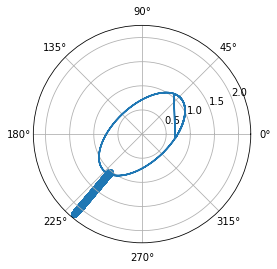

 96%|█████████▋| 964/1000 [05:25<00:11,  3.14it/s]

0.15434610283314878


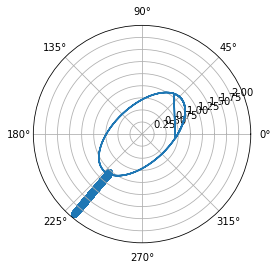

 96%|█████████▋| 965/1000 [05:25<00:11,  3.12it/s]

0.15252544367334656


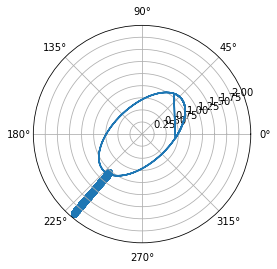

 97%|█████████▋| 966/1000 [05:26<00:11,  3.05it/s]

0.15073624128777766


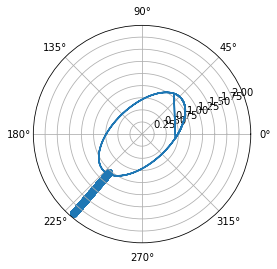

 97%|█████████▋| 967/1000 [05:26<00:10,  3.15it/s]

0.14898199351440156


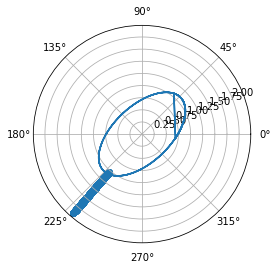

 97%|█████████▋| 968/1000 [05:26<00:09,  3.22it/s]

0.14726069584671803


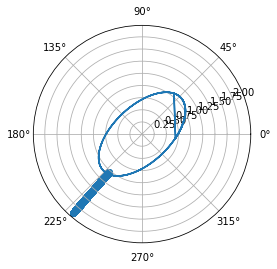

 97%|█████████▋| 969/1000 [05:27<00:09,  3.19it/s]

0.1455730497259634


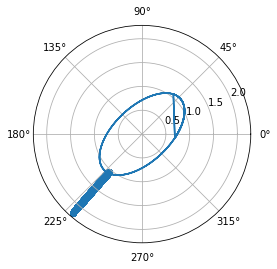

 97%|█████████▋| 970/1000 [05:27<00:09,  3.20it/s]

0.14392336545593878


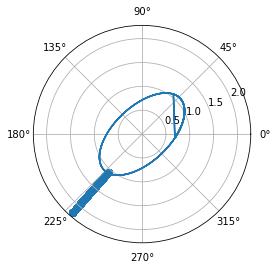

 97%|█████████▋| 971/1000 [05:27<00:08,  3.23it/s]

0.14230994907114428


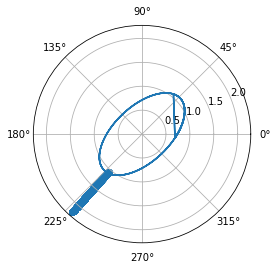

 97%|█████████▋| 972/1000 [05:28<00:09,  3.04it/s]

0.14073280258382348


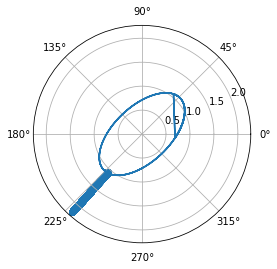

 97%|█████████▋| 973/1000 [05:28<00:09,  2.95it/s]

0.1391972628811797


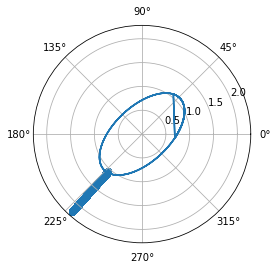

 97%|█████████▋| 974/1000 [05:28<00:08,  2.94it/s]

0.1377006279838955


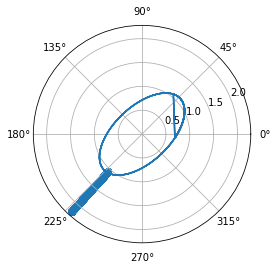

 98%|█████████▊| 975/1000 [05:29<00:08,  3.00it/s]

0.13624372699737816


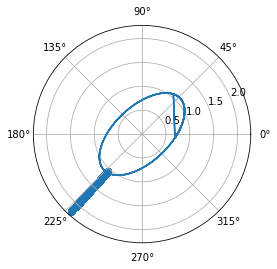

 98%|█████████▊| 976/1000 [05:29<00:08,  2.97it/s]

0.13483208129671115


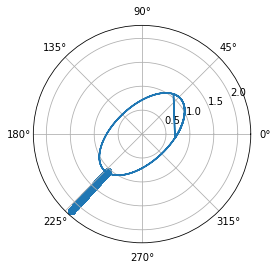

 98%|█████████▊| 977/1000 [05:29<00:07,  2.97it/s]

0.13346136179033574


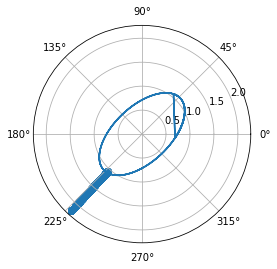

 98%|█████████▊| 978/1000 [05:30<00:07,  2.87it/s]

0.13213626311596113


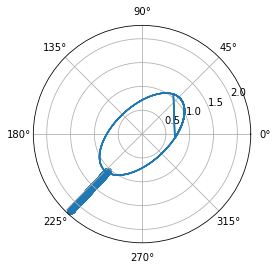

 98%|█████████▊| 979/1000 [05:30<00:06,  3.08it/s]

0.1308571029955672


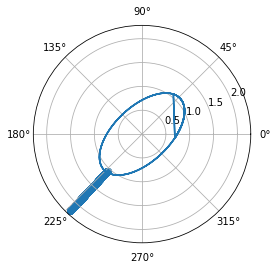

 98%|█████████▊| 980/1000 [05:30<00:06,  3.05it/s]

0.12962242987295786


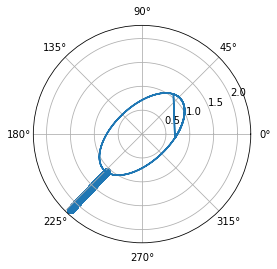

 98%|█████████▊| 981/1000 [05:31<00:06,  2.81it/s]

0.12843941127746142


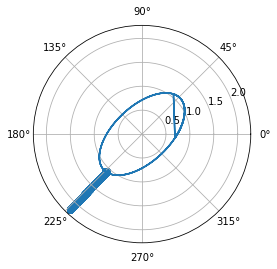

 98%|█████████▊| 982/1000 [05:31<00:06,  2.94it/s]

0.12730186533382457


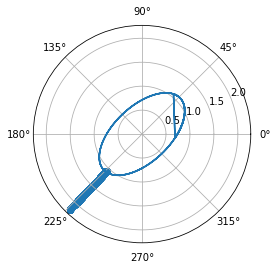

 98%|█████████▊| 983/1000 [05:31<00:05,  3.04it/s]

0.12621754712687847


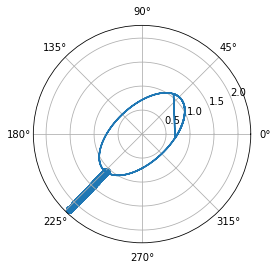

 98%|█████████▊| 984/1000 [05:32<00:05,  3.05it/s]

0.12518255170861411


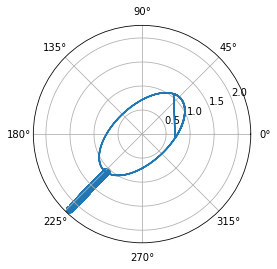

 98%|█████████▊| 985/1000 [05:32<00:04,  3.10it/s]

0.12420062630218633


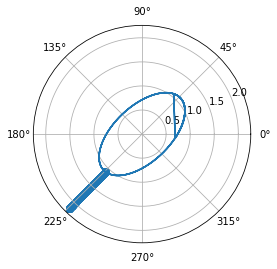

 99%|█████████▊| 986/1000 [05:32<00:04,  3.13it/s]

0.12327249913518792


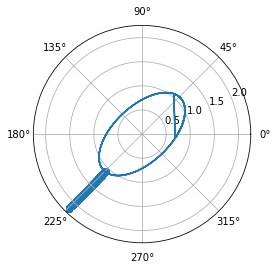

 99%|█████████▊| 987/1000 [05:33<00:04,  2.95it/s]

0.12239746650680693


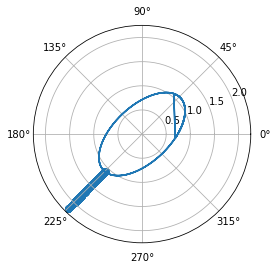

 99%|█████████▉| 988/1000 [05:33<00:03,  3.02it/s]

0.12158029542539167


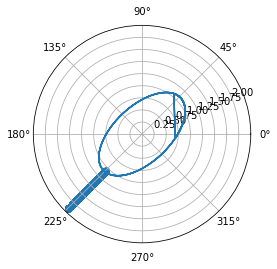

 99%|█████████▉| 989/1000 [05:33<00:03,  3.02it/s]

0.12081641928178855


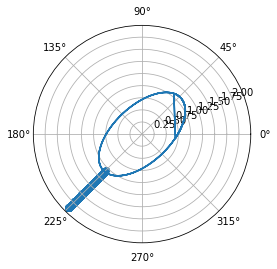

 99%|█████████▉| 990/1000 [05:34<00:03,  2.95it/s]

0.12011397963358263


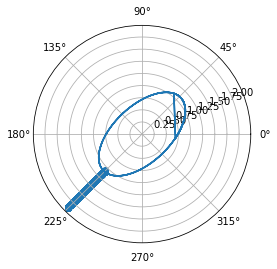

 99%|█████████▉| 991/1000 [05:34<00:03,  2.97it/s]

0.11946519275677277


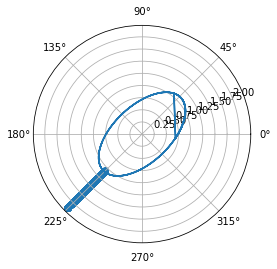

 99%|█████████▉| 992/1000 [05:34<00:02,  3.01it/s]

0.11888086470759657


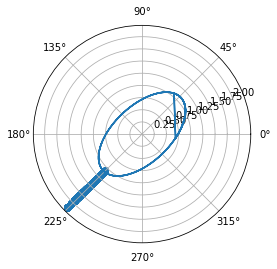

 99%|█████████▉| 993/1000 [05:35<00:02,  2.77it/s]

0.1183506725966482


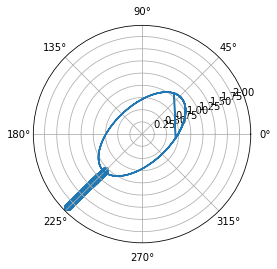

 99%|█████████▉| 994/1000 [05:35<00:02,  2.91it/s]

0.11788736218977358


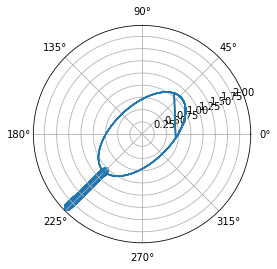

100%|█████████▉| 995/1000 [05:36<00:01,  2.93it/s]

0.11747879237085011


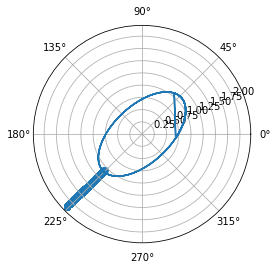

100%|█████████▉| 996/1000 [05:36<00:01,  2.80it/s]

0.11713881773528027


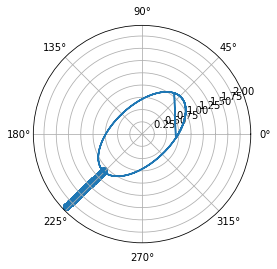

100%|█████████▉| 997/1000 [05:36<00:01,  2.80it/s]

0.11685437313864103


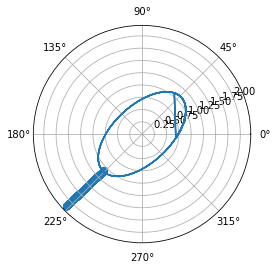

100%|█████████▉| 998/1000 [05:37<00:00,  2.87it/s]

0.11663936649400057


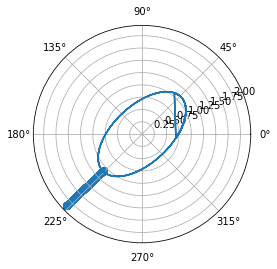

100%|█████████▉| 999/1000 [05:37<00:00,  2.85it/s]

0.11648054561387676


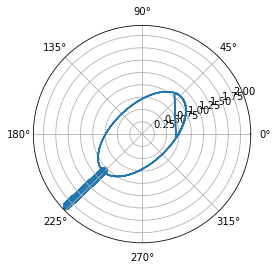

100%|██████████| 1000/1000 [05:37<00:00,  2.96it/s]

0.11639181686295358


In [39]:
n = 1000
r_max = 1.0

mask = np.logical_and(np.logical_and(np.abs(points[:,2]) < 10,  np.logical_and(points[:,1] <t_max,
                                                                points[:,1] > t_min)), points[:,0] < 2.2)


psp_mask = np.logical_and(np.abs(psp[:,2]) < 10,  np.logical_and(psp[:,1] < t_max,
                                                                 psp[:,1] > t_min))

orbit_mask = np.logical_and(np.abs(orbit[:,1]) < np.pi,  np.logical_and(orbit[:,1] < t_max,
                                                                 orbit[:,1] > t_min))

arr = points[mask].copy()

psp_arr = psp[psp_mask].copy()


orb_arr = orbit[orbit_mask].copy()
fig, ax = plt.subplots(subplot_kw={'projection': 'polar'})
ax.plot(orb_arr[:,1], orb_arr[:,0])
plt.show()


# fig, ax = plt.subplots(subplot_kw={'projection': 'polar'})
# ax.scatter(arr[:,1], arr[:,0])
# plt.show()
# orb_orig_arr = orbit_orig[orbit_mask].copy()
theta = interp1d(orb_arr[:,0], orb_arr[:,1])



bounds = np.linspace(t_max, t_min, n+1)
                        

# bounds_orig = theta(np.linspace(orb_orig_arr[:,0][np.logical_and(-np.pi<orb_orig_arr[:,1], orb_orig_arr[:,1]<0)].max(), 
#                            orb_orig_arr[:,0][np.logical_and(0<orb_orig_arr[:,1], orb_orig_arr[:,1]<np.pi)].max(), n+1 ))
plt.plot(np.arange(n+1), bounds)
plt.show()
ax.plot(arr[:,1], arr[:,0])
plt.show()

for i in tqdm(range(n)):
    mask = np.logical_and(arr[:,1] <= bounds[i], arr[:,1] > bounds[i+1])
    psp_mask = np.logical_and(psp_arr[:,1] <= bounds[i], psp_arr[:,1] > bounds[i+1])
    orb_mask = np.logical_and(orb_arr[:,1] <= bounds[i], orb_arr[:,1] > bounds[i+1])
    
    fig, ax = plt.subplots(subplot_kw={'projection': 'polar'})


    ax.scatter(arr[:,1][mask], arr[:,0][mask])
    ax.plot(orbit[:,1], orbit[:,0])

    plt.show()
    print(radius(bounds[i]))
    if ((bounds[i] - bounds[i+1]) < 0):
        raise
        mask = np.logical_or(arr[:,1] <= bounds[i], arr[:,1] > bounds[i+1])
        psp_mask = np.logical_or(psp_arr[:,1] <= bounds[i], psp_arr[:,1] > bounds[i+1])
        orb_mask = np.logical_or(orb_arr[:,1] <= bounds[i], orb_arr[:,1] > bounds[i+1])
    elif (i==n): 
        raise
        mask = np.logical_and(arr[:,1] <= bounds[i], arr[:,1] > bounds[i])
        psp_mask = np.logical_and(psp_arr[:,1] <= bounds[i], psp_arr[:,1] > bounds[i])
        orb_mask = np.logical_and(orb_arr[:,1] <= bounds[i], orb_arr[:,1] > bounds[i])
    
    

    offset_r = np.mean(orb_arr[:,0][orb_mask])


    
    
    offset_z = np.mean(orb_arr[:,2][orb_mask])


    
    arr[:,2][mask] -= offset_z

    orb_arr[:,2][orb_mask] -= offset_z
    psp_arr[:,2][psp_mask] -=offset_z

    arr[:,0][mask] -= offset_r

    orb_arr[:,0][orb_mask] -= offset_r
    psp_arr[:,0][psp_mask] -=offset_r


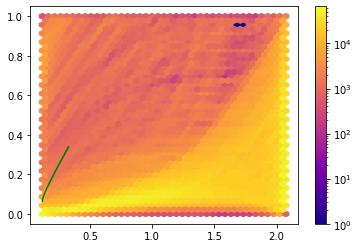

In [40]:
mask = (np.sqrt(arr[:,0]**2 + arr[:,2]**2) < 1) * (arr[:,1] > t_min)
psp_mask = (np.abs(psp_arr[:,2]) + np.abs(psp_arr[:,0])) < 200
orb_mask = np.abs(orb_arr[:,2] < 100)

hi = 6038
n=40
plt.rc_context({'figure.facecolor':'white'})
poly = plt.hexbin(radius((arr[:,1][mask])), np.sqrt(arr[:,0][mask]**2 + arr[:,2][mask]**2), cmap = 'plasma', gridsize = n, bins='log')
plt.plot(radius((psp_arr[:,1][psp_mask])), np.sqrt(psp_arr[:,0][psp_mask]**2 + psp_arr[:,2][psp_mask]**2), c = 'g')
# poly = plt.hexbin((arr[:,1][mask]), np.sqrt(arr[:,0][mask]**2 + arr[:,2][mask]**2), cmap = 'plasma', gridsize = n, bins='log')
# plt.plot((psp_arr[:,1][psp_mask]), np.sqrt(psp_arr[:,0][psp_mask]**2 + psp_arr[:,2][psp_mask]**2), c = 'g')


# plt.clim(10**3.5,5e5)
plt.colorbar()
plt.show()

In [41]:
orb_arr[:,1]



array([-0.12491262, -0.12448582, -0.12405927, ...,  0.75195779,
        0.75208144,  0.75220509])

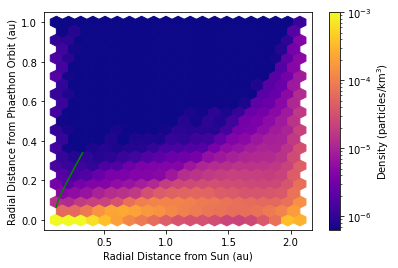

In [42]:
c = poly.get_array().copy()
cords = poly.get_offsets().copy()

# dr = np.abs(cords[252,0]-cords[0,0])
# dl = np.abs(cords[252,1]-cords[0,1])
dl = (2.1/(n+2))
dr = (1/(n+6))

for i in range(cords.shape[0]): #currently estimating hexes as squares #TODO
    r = cords[i,1]
    l = cords[i,0]
    
    r1 = r - dr/2
    r2 = r + dr/2
    
    l1 = (l - dl/2)
    l2 = (l+dl/2)
    
    h = np.abs(np.max((l1,0))-np.max((l2,0)))
    V = np.pi * np.abs(np.max((r2,0))**2 - np.max((r1,0))**2)*h *((au/1e3)**3)
    c[i] /= V
    



plt.hexbin(cords[:,0], cords[:,1], C=c*norm, gridsize=20, bins='log', cmap='plasma')
plt.plot((radius(psp_arr[:,1][psp_mask])), np.sqrt(psp_arr[:,0][psp_mask]**2 + psp_arr[:,2][psp_mask]**2), c = 'g')

# plt.clim(1e4, 1e12)


plt.colorbar(label="Density (particles/km$^3$)")
plt.clim(10**-6.2,10**-3)
plt.xlabel("Radial Distance from Sun (au)")
plt.ylabel("Radial Distance from Phaethon Orbit (au)")
plt.savefig("Fig_5.2.1.eps")
plt.show()

  0%|          | 0/30 [00:00<?, ?it/s]/Users/wolfcukier/opt/anaconda3/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/Users/wolfcukier/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
100%|██████████| 30/30 [01:06<00:00,  2.21s/it]


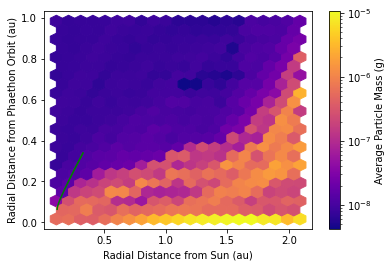

In [43]:
x_min = 0
x_max = 2.2
y_min = 0
y_max = 1

n = 30

means = np.zeros((n,n))
cords = np.zeros((n,n,2))

x_lim = np.linspace(x_min, x_max, n+1)
y_lim = np.linspace(y_min, y_max, n+1)

x = radius(arr[:,1])
y = np.sqrt(arr[:,0]**2 + arr[:,2]**2)
for i in tqdm(range(n)):
    for j in range(n):
        m_x = np.logical_and(x >= x_lim[i], x < x_lim[i+1])
        m_y = np.logical_and(y >= y_lim[j], y < y_lim[j+1])
        
        cords[i,j] = [(x_lim[i]+x_lim[i+1])/2, (y_lim[j]+y_lim[j+1])/2]
        
        means[i][j] = np.mean(arr[:,3][np.logical_and(m_x, m_y)])
        
cords = cords.reshape(n**2,2)
means = means.reshape(n**2,)

plt.hexbin(cords[:,0], cords[:,1], C=means, gridsize = 20, cmap="plasma", bins = 'log')
plt.plot((radius(psp_arr[:,1][psp_mask])), np.sqrt(psp_arr[:,0][psp_mask]**2 + psp_arr[:,2][psp_mask]**2), c = 'g')


plt.colorbar(label="Average Particle Mass (g)")
plt.xlabel("Radial Distance from Sun (au)")
plt.ylabel("Radial Distance from Phaethon Orbit (au)")
plt.savefig("Fig_5.2.2.eps")
plt.show()

In [19]:
cords[0,1] -dr/2

-0.2280409071493197

In [20]:
cords[0,1] + dr/2

0.26137424048265306